<a href="https://colab.research.google.com/github/aRealGem/AnimalDetector/blob/main/BuildingOnBestAnimalDetector_Custom3ImgHybridCNNGRUAttempt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Nature Camera Animal Detection Model

## Goal

Nature cameras are motion activated and capture plant motion as often as actual animals despite the latter being the primary interest.  This model is intended to automate the process of identifying which photos among hundreds captured over several weeks or months have animals in them so as to relieve the wildlife enthusiast the tedium of manually reviewing all photos.

**TODOS**:

Current baseline performance:
* 3img Hybrid Ensemble 1cnn + 1GRU RNN + 2 Dense
  * 3 independent, identical models trained at 0 zoom, 1.5 zoom & 3.0 zoom
  * motion detection / temporal in addition to spatial, with lightweight GRU
* 99%+ on training & validation
* 88% test
* 65% prod, but 84% if trust no zoom
* All achieved with a custom 3img Hybrid model of 2CNNs + LSTM


1. Try following to boost performance:
  * Add dynamic zoom for corresponding models
  * Merge models with new dense & sigmoid atop and see how we do,
  * If nothing improves, average, plus no zoom override on discrepancy for animals is better at 84%
1. Experiment with other models to possibly assist in an Ensemble arch (DONE)
1. Create way to summarize model & training stats (DONE)
1. Refactor for a notebook to "easily" prototype different models(DONE)
  * See AnimalDetector-3ImgHybrid Template.ipynb
1. Review training data - many misclassified fuckups (DONE)
1. Increase test data volume while keeping balance (DONE)
1. Try adding simple motion detection (DONE)
  * curate & load data organized for time series training
  * debug data input shape, missing image dimensions (299,299,3)
    * Likely solvable by ensuring padding so that every list has 3 images


Old baseline performance numbers:
* Custom 3img Hybrid model of 2CNNs + LSTM
  * motion detection / temporal in addition to spatial
    * 99%+ on training & validation
    * 95% test
    * 80% prod

*Pre-trained xfer learning & train-from scratch IncepV3 & VGG-16
  * 80%+ on training & validation
  * 75% test
  * 68% prod
  * never broke chance on prod with well known models

# Initialize Environment

In [ ]:
from logging import root
#Initialize environment cell, imports, constants, etc.
#Uncomment as needed !pip install autokeras
import os
import gc
import pickle
import numpy as np
import tensorflow as tf
from tensorflow import keras
import cv2
import random
from collections import defaultdict
import re

#SWITCHES
DEBUG = False
REMOVE_CAM_META_DATA_BAND = True #Use if Rexing brand camera - otherwise off or may need to adjust height constant
NATURE_CAM_META_DATA_BAND_HEIGHT = 12 #Relevant only when present & after resize to 299x299!

# Constants for Zoom Levels
NO_ZOOM = 'no_zoom'
ZOOM_1_5X = 'z1pt5'
ZOOM_3_0X = 'z3pt0'

# Set the desired zoom level here
DESIRED_ZOOM_LEVEL = NO_ZOOM  # Choose from NO_ZOOM, ZOOM_1_5X, ZOOM_3_0X


MODEL_NAME = "EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense"
MODEL_PARMS_FOR_REPORTING = "\n" + "Model Name: " + MODEL_NAME

# Set the random seed for reproducibility
random.seed(42)
from IPython.display import Javascript
def update_model_parms_for_reporting(info):
    global MODEL_PARMS_FOR_REPORTING
    MODEL_PARMS_FOR_REPORTING = MODEL_PARMS_FOR_REPORTING + "\n" + info
def print_model_parms_for_reporting():
    print(MODEL_PARMS_FOR_REPORTING)
def beep(num_of_times=1):
  import time
  for i in range(num_of_times):
    time.sleep(1)  # Sleep for 1 second
    single_beep()

def single_beep():
    #print(f"Step {i+1} completed")
    display(Javascript("""
    var ctx = new AudioContext();
    var o = ctx.createOscillator();
    var g = ctx.createGain();
    o.connect(g);
    o.type = 'sine';
    g.connect(ctx.destination);
    o.start(0);
    g.gain.exponentialRampToValueAtTime(0.00001, ctx.currentTime + 1);
    """))

#SMS notification code for long running operations
import requests

def send_ifttt_notification(proc, status):
  event_name = "Auto_proc_status_update"
  ifttt_key = "cDx-dMTOhvLXfeuIg4LcR3"
  url = f"https://maker.ifttt.com/trigger/{event_name}/with/key/{ifttt_key}"
  response = requests.post(url, json={"value1": proc, "value2": status})
  print(response.text)  # This will print the response from IFTTT

#Credit Dr. Jason Brownlee: https://machinelearningmastery.com/display-deep-learning-model-training-history-in-keras/
#Data Analysis
from IPython.display import display
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

def graph_model_performance(model_name, history_data):
    # list all data in history
    print(history_data.history.keys())
    # summarize history for accuracy
    plt.plot(history_data.history['binary_accuracy'])
    plt.plot(history_data.history['val_binary_accuracy'])
    accuracy_model_title = model_name + ': model accuracy'
    plt.title(accuracy_model_title)
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()
    # summarize history for loss
    plt.plot(history_data.history['loss'])
    plt.plot(history_data.history['val_loss'])
    loss_model_title = model_name + ': model loss'
    plt.title(loss_model_title)
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

def get_raw_datetime():
  from datetime import datetime
  import pytz

  # Charlotte, NC is in the Eastern Time Zone
  eastern = pytz.timezone('America/New_York')
  charlotte_time = datetime.now(eastern)
  return charlotte_time

def get_datetimestamp():
  charlotte_time = get_raw_datetime()
  return charlotte_time.strftime("%Y-%m-%d %H:%M:%S")

def output_datetimestamp():
  print(get_datetimestamp())

print("Starting initialization")

# Set the image dimensions
img_width = 299
img_height = 299

# Set the number of classes
num_classes = 2

# Mount Google Drive to access the data
print("About to mount drive, may require auth/auz")
beep()
from google.colab import drive
drive.mount('/content/drive')

# Define my google drive
root_dir = '/content/drive/MyDrive'
print("root_dir: " + root_dir)

# Define the data directories
# Define the training data directories
train_data_dir = root_dir + '/Training_data'

# Define the test data directories (optional)
test_data_dir = root_dir + '/Test_data' #TODO: CONSIDER FLIPPING 230521-230610 Spring House Meadow

print("train_data_dir: " + train_data_dir)
print("test_data_dir: " + test_data_dir)

# Define the model directory
model_dir = root_dir + '/Model'#/Super Duper Animal Detectors' #Trying to help label new training data with best
print("model_dir: " + model_dir)

# Define eval directory
eval_dir = root_dir + '/Pics_to_evaluate'
print("eval_dir: " + eval_dir)

print("Initialization COMPLETE ")
output_datetimestamp()
send_ifttt_notification("Environment initiatlization", "Complete")

beep(3)



Starting initialization
About to mount drive, may require auth/auz


<IPython.core.display.Javascript object>

Mounted at /content/drive
root_dir: /content/drive/MyDrive
train_data_dir: /content/drive/MyDrive/Training_data
test_data_dir: /content/drive/MyDrive/Test_data
model_dir: /content/drive/MyDrive/Model
eval_dir: /content/drive/MyDrive/Pics_to_evaluate
Initialization COMPLETE 
2025-02-06 10:31:54
Congratulations! You've fired the Auto_proc_status_update event


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#This cell DEPENDS ON INITIALIZE ENV cell being run (imports, constants, etc.)
# Helper / Utility functions
from collections import defaultdict
import re
from concurrent.futures import ThreadPoolExecutor
import cv2

def resize_image(input_image, target_width=img_width, target_height=img_height):
    # Resize the image to the target dimensions
    # Convert the image to uint8 before resizing if it's not already
    if input_image.dtype != np.uint8:
        input_image = input_image.astype(np.uint8)

    resized_image = cv2.resize(input_image, (target_width, target_height), interpolation=cv2.INTER_LINEAR)
    return resized_image

def zoom_image(image, zoom_factor):
    if image.size == 0:
        raise ValueError("Input image is empty")

    h, w = image.shape[:2]
    new_h, new_w = int(h / zoom_factor), int(w / zoom_factor)

    if new_h <= 0 or new_w <= 0:
        raise ValueError("Zoom factor is too large, resulting in an empty image")

    start_x = (w - new_w) // 2
    start_y = (h - new_h) // 2
    cropped = image[start_y:start_y+new_h, start_x:start_x+new_w]

    if cropped.size == 0:
        raise ValueError("Cropped image is empty. Check the cropping coordinates and the zoom factor.")

    resized = cv2.resize(cropped, (w, h), interpolation=cv2.INTER_LINEAR)
    return resized


def load_and_preprocess_images(directory_path, each_class_dir, image_files, max_workers=5):
    full_image_paths = [os.path.join(directory_path, each_class_dir, img) for img in image_files]  # Full paths to the images
    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        # Schedule the loading and preprocessing of each image and collect the futures
        futures = [executor.submit(load_and_preprocess_image, path) for path in full_image_paths]
        # Wait for all the futures to complete and collect the results
        results = [future.result() for future in futures]
    return results

def extract_base_name(file_name):
    # Extract the base name of the file (all before extension)
    base_name = file_name.rsplit('.', 1)[0]
    # Strip any numeric digits from the end of the base_name
    base_name = re.sub(r'\d+$', '', base_name).strip()
    return base_name

def group_files_by_base_name(file_names):
    groups = defaultdict(list)
    for file_name in file_names:
        base_name = extract_base_name(file_name)
        groups[base_name].append(file_name)
    return groups

def assign_event_numbers_to_groups(groups):

    # Function to extract the last four digits from a filename
    def get_sequence_number(filename):
        match = re.search(r'(\d{4})\.\w+$', filename)
        return int(match.group(1)) if match else 0

    groups_by_events = defaultdict(list)
    for base_name, files in groups.items():
        files.sort(key=get_sequence_number)
        event_number = 1
        last_sequence_number = -1
        image_count = 0

        for file_name in files:
            sequence_number = get_sequence_number(file_name)
            # Check for new event based on sequence or if event already has 3 images
            if (last_sequence_number != -1 and sequence_number != last_sequence_number + 1) or image_count == 3:
                event_number += 1
                image_count = 0

            last_sequence_number = sequence_number
            image_count += 1

            event_str = f"{base_name}_Event{event_number}"
            groups_by_events[event_str].append(file_name)
    if DEBUG:
      print("groups_by_events: " + str(groups_by_events))

    return groups_by_events

def load_directories(directory):
    image_dirs = defaultdict(list)
    subdirectories = os.listdir(directory)

    for subdir in subdirectories:
        subdirectory_path = os.path.join(directory, subdir)
        class_label = subdir.lower()
        all_files = os.listdir(subdirectory_path)

        # Filter files based on the constant DESIRED_ZOOM_LEVEL
        if DESIRED_ZOOM_LEVEL == NO_ZOOM:
            image_files = [file for file in all_files if not re.match(r'z\d+pt\d+-', file)]
        else:
            image_files = [file for file in all_files if file.startswith(DESIRED_ZOOM_LEVEL)]

        image_dirs[subdir] = image_files
        print("\nClass: " + class_label + " Total images: " + str(len(image_files)))

    return image_dirs

# Produced a dictionary of classes each with a dictionary of events each with an array of no more than 3 image files
def get_grouped_images_by_class_and_events(image_directories):
  result = defaultdict(defaultdict)
  for each_dir in image_directories.keys():
    if DEBUG:
      print("\n\n Processing directory/class: " + each_dir)
    image_file_paths = image_directories[each_dir]
    # Group image file_names by base_name
    grouped_files = group_files_by_base_name(image_file_paths)
    # Assign groups to their respective events and assign a number
    groups_by_events = assign_event_numbers_to_groups(grouped_files)
    result[each_dir] = (groups_by_events)

  return result

#Remove bottom height number of pixels and pad with black to preserve aspect ratio
def remove_image_data_with_pad(image, height):
    original_height = tf.shape(image)[0]
    meta_band_height = height  # Example

    # Crop and pad back to original size
    cropped_image = tf.image.crop_to_bounding_box(
        image, 0, 0, original_height - meta_band_height, tf.shape(image)[1]
    )

    # Resize with padding to maintain aspect ratio
    padded_image = tf.image.resize_with_pad(cropped_image, 299, 299)
    return padded_image

def display_images(labels, images):
  import matplotlib.pyplot as plt

  num_images = len(images)
  if labels == None:
    labels = ["NONE SUPPLIED", "NONE SUPPLIED", "NONE SUPPLIED"]
    print(labels)

  # Create a subplot with 1 row and as many columns as there are images
  fig, axes = plt.subplots(1, num_images, figsize=(5 * num_images, 5))

  # Iterate over the images and labels
  for i, (image, label) in enumerate(zip(images, labels)):
      # Convert image to numpy array if it's not already
      if not isinstance(image, np.ndarray):
          print("Converting image to numpy array")
          image = np.array(image)

      # Display the image
      plt.title(label)
      plt.imshow(image)
      # Show the plot
      plt.show()

#Normalize the image pixel values to between 0 & 1 for efficient training
#and remove metadata band if so configured
def preprocess_image(img):
    img = img_to_array(img)  # Convert to numpy array
    if DEBUG:
      print("Data type after img_to_array:", img.dtype)
    img /= 255.0  # Normalize to [0, 1]
    if DEBUG:
      print("Data type after normalization:", img.dtype)

    if REMOVE_CAM_META_DATA_BAND:
      img = remove_image_data_with_pad(img, NATURE_CAM_META_DATA_BAND_HEIGHT)

    return img

def load_and_preprocess_image(image_path, target_size=(img_width,img_height)):
    """Load an image and preprocess it."""
    img = load_img(image_path, target_size=target_size)

    return preprocess_image(img)

def get_img_stats(pic):
  result = ""
  result += ("Type : " + str(type(pic))) + "\n"
  result += ("Shape : {}".format(pic.shape)) + "\n"
  result += ("Height {}".format(pic.shape[0])) + "\n"
  result += ("Width {}".format(pic.shape[1])) + "\n"
  result += ("Dimensions {}".format(pic.ndim)) + "\n"
  return result

import matplotlib.pyplot as plt
import cv2

def display_images_side_by_side(images, labels, title):
    # Number of images
    num_images = len(images)

    # Create a subplot with 1 row and as many columns as there are images
    fig, axes = plt.subplots(1, num_images, figsize=(5 * num_images, 5))

    # If there's only one image, axes won't be an array, so we make it one for consistency
    if num_images == 1:
        axes = [axes]

    # Set the overall title for all the subplots
    fig.suptitle(title, fontsize=16)

    # Display each image in a subplot
    for ax, image, label in zip(axes, images, labels):
        ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert color from BGR to RGB
        ax.set_title(label)  # Display the label as title of the subplot
        ax.axis('off')  # Hide axes

    plt.show()

def print_label_distribution_numeric(labels, name="Dataset"):
    labels = np.array(list(labels))  # ensure it's a NumPy array
    total = len(labels)
    import numbers
    if isinstance(labels[0], numbers.Number):
      animal_count = np.sum(labels == 1)
      no_animal_count = np.sum(labels == 0)
    else:
      animal_count = sum(1 for label in labels if label == "Animal")

    no_animal_count = total - animal_count

    animal_pct = animal_count / total * 100 if total > 0 else 0
    no_animal_pct = no_animal_count / total * 100 if total > 0 else 0

    print(f"{name} Distribution:")
    print(f"  Total: {total}")
    print(f"  Animal (1): {animal_count} ({animal_pct:.2f}%)")
    print(f"  No_Animal (0): {no_animal_count} ({no_animal_pct:.2f}%)")
    print()


print("Helper functions defined")
output_datetimestamp()
beep()

Helper functions defined
2025-02-06 10:31:57


<IPython.core.display.Javascript object>

# Training Data 1x Zoom Preprocessing


In [ ]:
#File-prefix Based
import cv2
import numpy as np
import os
from pathlib import Path

def process_directory(input_dir, zoom_factor):
    input_dir = Path(input_dir)

    # Prefix for the filenames based on zoom factor, e.g., "z1pt5-" for zoom factor 1.5
    prefix = f"z{str(zoom_factor).replace('.', 'pt')}-"

    # List all files in the input directory
    image_files = [f for f in input_dir.glob('*') if f.is_file() and f.suffix.lower() in ['.jpg', '.jpeg', '.png']]

    files_to_process = len(image_files)
    files_skipped = 0
    print("Files to process: " + str(files_to_process))

    for file_path in image_files:
        # Skip files that already have a zoom prefix
        if file_path.name.startswith('z') and 'pt' in file_path.name:
            print(f"Skipping already processed file: {file_path.name}")
            files_skipped += 1
            continue

        # Read the image
        image = cv2.imread(str(file_path))

        if image is not None:
            # Zoom the image
            zoomed_image = zoom_image(image, zoom_factor)

            # Generate output file path with the prefix
            output_file_path = input_dir / (prefix + file_path.name)
            cv2.imwrite(str(output_file_path), zoomed_image)
        else:
            print(f"Warning: Could not read {file_path}. Skipping.")
    print("Already zoomed files skipped: " + str(files_skipped) + " of " + str(files_to_process))

#Execution area
zoom_factor = 1.5
# curr_work_dir = test_data_dir + "/Animals"
# curr_work_dir = test_data_dir + "/No_animals"
# curr_work_dir = train_data_dir + "/Animals"
curr_work_dir = train_data_dir + "/No_animals"
input_directory = curr_work_dir
print("Starting creation of zoomed images")
print("Directory: " + curr_work_dir)
print("Zoom factor: " + str(zoom_factor))
print("...")
process_directory(curr_work_dir, zoom_factor)
print("Processing complete - zoomed images with z factor prefixes created")
send_ifttt_notification("Training Data Zoom Augmentation", "Complete")

beep(5)

# Training data load cell

In [ ]:
# This cell DEPENDS ON HELPER / UTILITY FUNCTIONS cell being run
#Time series / video training data load cell
#Scan data, identify event groups by filename numeric suffix

#SWITCHES
#COUNT IMAGES ONLY - NOTHING ELSE
COUNT_IMAGES_ONLY=False
#LOAD_IMAGES
LOAD_IMAGES=True
#ENSURE TRAINING DATA LOAD IS SET, BUT RECALL IT IS SLOW TO LOAD VS. JUST TEST_DATA
LOAD_TRAINING_DATA=True
MULTI_THREAD=True
#PICKLE THE TRAINING AND TEST DATA (will load only serialized pickled data)
PICKLE=True
pickle_jar = root_dir + '/Pickled_data'
pickle_train_data = pickle_jar + '/train_data.pkl'
pickle_train_labels = pickle_jar + '/train_labels.pkl'
pickle_test_data = pickle_jar + '/test_data.pkl'
pickle_test_labels = pickle_jar + '/test_labels.pkl'

#SAFTEY LIMIT - DON'T WASTE TIME/PROCESSING IF ACTUAL DATA AMOUNT EXCEEDED
SAFETY_LIMIT = 1000

import os
import pickle
from itertools import groupby
from skimage.io import imread
from skimage.metrics import structural_similarity as ssim
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array, ImageDataGenerator
import copy

#Helpful globals - TODO: these are part of an incomplete attempt to make the before/after img aug qa check more dynamic
# vs. the hardcoded indexes currently used in the RUNTIME section
RAW_COUNTS = defaultdict(list)
POST_AUG_COUNTS = defaultdict(list)

# Define functions

def sample_data_for_quality(sample_indexes, data_to_sample, labels_to_sample):
  sample_events = []
  sample_labels = []
  for index in sample_indexes:
    sample_events.append(data_to_sample[index])
    sample_labels.append(labels_to_sample[index])

  print("data_to_sample: ")
  print(data_to_sample.shape)
  print("sample_events: ")
  print(np.array(sample_events).shape)
  event_index=0
  len_sample_events = len(sample_events)
  print("len(sample_events):" + str(len_sample_events))
  for each_event in sample_events:
    image_index=0
    img_display_labels = []
    sample_images = each_event
    for each_img in sample_images:
      stat_str = get_img_stats(each_img)
      temp_new_label = "\nEvent: " + str(event_index) + "/" + str(len_sample_events-1) + " Class: " + str(sample_labels[event_index]) + "\nImage[" + str(image_index) + "]\n" + stat_str
      img_display_labels.append(temp_new_label)
      image_index += 1
    display_images(img_display_labels,sample_images)
    event_index += 1


def load_data(directory_path):

  image_directories = load_directories(directory_path)
  groups_by_class_and_events = get_grouped_images_by_class_and_events(image_directories)
  result_data = []
  result_labels = []
  result_file_names = []
  for each_class_dir in groups_by_class_and_events.keys():

    print("\n\nClass/dir: " + each_class_dir)
    scaled_label = 0 if "No" in each_class_dir else 1

    i=0
    if MULTI_THREAD:
      for each_event in groups_by_class_and_events[each_class_dir].keys():
          i += 1
          if i > SAFETY_LIMIT:
              break
          print(" Event: " + each_event)
          temp_event_img_arr = []

          image_files = groups_by_class_and_events[each_class_dir][each_event]
          if LOAD_IMAGES:
              # Call the new function for parallel loading and preprocessing
              preprocessed_images = load_and_preprocess_images(directory_path, each_class_dir, image_files, max_workers=5)
              temp_event_img_arr.extend(preprocessed_images)
          else:
              temp_event_img_arr.extend(["FAKE_IMG_PLACE_HOLDER"] * len(image_files))

          result_data.append(temp_event_img_arr)
          result_labels.append(scaled_label)
          result_file_names.extend(image_files)
    else:
      for each_event in groups_by_class_and_events[each_class_dir].keys():
        i += 1
        print("iterator(i): " + str(i))
        if i>SAFETY_LIMIT:
          break
        print(" Event: " + each_event)
        temp_event_img_arr = []

        for each_img in groups_by_class_and_events[each_class_dir][each_event]:
          print("   Img: " + each_img)
          result_file_names.append(each_img)
          if LOAD_IMAGES:
            temp_img = load_and_preprocess_image(os.path.join(directory_path, each_class_dir, each_img))
            temp_event_img_arr.append(temp_img)
          else:
            temp_event_img_arr.append("FAKE_IMG_PLACE_HOLDER")
        #print("temp_event_img_arr: " + str(temp_event_img_arr))
        result_data.append(temp_event_img_arr)
        result_labels.append(scaled_label)

  result_data = np.array(result_data, dtype=object)
  result_labels = np.array(result_labels)
  result_file_names = np.array(result_file_names)

  return (result_data,result_labels,result_file_names)

def ensure_list(x):
    if isinstance(x, np.ndarray):
        return x.tolist()
    elif not isinstance(x, list):
        return [x]  # Convert to a single element list
    else:
        return x

def pad_one_image_event(event_images, target_length=3):
    """Replicate the last image if there are fewer than target_length images."""
    event_images = ensure_list(event_images)
    while len(event_images) < target_length:
        event_images.append(event_images[-1])  # Append the last image
    return event_images


def pad_two_image_event(event_images):
  image1=event_images[0]
  image2=event_images[1]
  event_images = pad_two_image_event_helper(image1, image2)
  return event_images

def pad_two_image_event_helper(image1, image2, target_length=3):
    """Combine two padding strategies for two-image events."""
    strategy = random.choice([1, 2])

    if strategy == 1:
        # Random Duplication
        if random.choice([True, False]):
            return [image1, image2, image2]  # Duplicate the second image
        else:
            return [image1, image1, image2]  # Duplicate the first image
    else:
        # Alternating Change
        if random.choice([True, False]):
            return [image1, image2, image1]  # img1, img2, img1
        else:
            return [image2, image1, image2]  # img2, img1, img2

def get_random_augmentation_params(rot, w_shift, ht_shift, shear, zoom):
    return {
        'rotation_range': random.randint(0, rot),  # Mild rotation between 0 to 5 degrees
        'width_shift_range': random.uniform(0.0, w_shift),  # Mild shift up to 5% of the image width
        'height_shift_range': random.uniform(0.0, ht_shift),  # Mild shift up to 5% of the image height
        'shear_range': random.uniform(0.0, shear),  # Mild shear intensity up to 10%
        'zoom_range': random.uniform(0.0, zoom),  # Experimenting with 40%, orig: Mild zoom up to 10%
        'horizontal_flip': random.choice([True, False]),  # Randomly choose to flip horizontally
        'vertical_flip': random.choice([True, False]),  # Randomly choose to flip horizontally
        'fill_mode': 'nearest'  # Fill mode 'nearest' to handle new pixels after transformation
    }

def get_aug_parm_limits():
  #Augmentation parm limits
  rot=7 #7 degrees of 180
  w_shift=0.1
  ht_shift=0.1
  shear=0.2
  zoom=0.1
  return rot, w_shift, ht_shift, shear, zoom

def augment_data_and_pad_for_missing_images(data_coll, labels_coll):
  # Assuming you have an event's images in event_images
  result_data_coll = data_coll.tolist()
  result_labels_coll = labels_coll.tolist()
  # New collections for augmented data and labels
  augmented_data = []
  augmented_labels = []
  rot, w_shift, ht_shift, shear, zoom = get_aug_parm_limits()

  temp_aug_parms = ("\n" + "Aug parms: " + "\n\t rot=" + str(rot) + "\n\t w_shift=" + str(w_shift) + "\n\t ht_shift=" + str(ht_shift) + "\n\t shear=" + str(shear) + "\n\t zoom=" + str(zoom))
  update_model_parms_for_reporting(temp_aug_parms)


  print("\nAugmenting data to maximize use of data & model ability to generalize")
  print("\nInitial event size stats")
  RAW_COUNTS = count_events_in_data_and_labels(result_data_coll, result_labels_coll)
  for idx, each_event in enumerate(result_data_coll):
      # Get the label for the current event
      current_label = labels_coll[idx]

      # Augment the event images
      # augmented_event_images = [image1, image2, image3] where each image is a numpy array
      augmented_event_images = augment_event_images(each_event, get_random_augmentation_params(rot, w_shift, ht_shift, shear, zoom))

      # Append augmented event and label to new collections
      augmented_data.append(augmented_event_images)
      augmented_labels.append(current_label)
      if DEBUG:
        print("augmented_data len: " + str(len(augmented_data)))
        print("augmented_labels: " + str(augmented_labels))
  if DEBUG:
    print("aug_data_and_pad - result_data_coll len b4 extension: " + str(len(result_data_coll)))
    print("aug_data_and_pad - result_labels_coll len b4 extension: " + str(len(result_labels_coll)))

  result_data_coll.extend(augmented_data)
  result_labels_coll.extend(augmented_labels)

  if DEBUG:
    print("aug_data_and_pad - result_data_coll len post extension: " + str(len(result_data_coll)))
    print("aug_data_and_pad - result_labels_coll len post extension: " + str(len(result_labels_coll)))

  print("\nPost-augmentation event size stats")
  POST_AUG_COUNTS = count_events_in_data_and_labels(result_data_coll, result_labels_coll)
  print("\nAugmentation of data complete")
  # Perform event image padding as needed
  result_data_coll = pad_for_missing_images(result_data_coll, result_labels_coll)
  result_data_coll = np.array(result_data_coll)
  result_labels_coll = np.array(result_labels_coll)

  return result_data_coll, result_labels_coll

def pad_for_missing_images(data_coll, labels_coll):
  result_data_coll = []
  print("\nPadding for events with missing images (events < 3 images)")
  print("\nInitial event size stats")
  count_events_in_data_and_labels(data_coll, labels_coll)
  for temp_event_imgs in data_coll:
    if len(temp_event_imgs) < 3:
      if len(temp_event_imgs) < 2:
        result_data_coll.append(pad_one_image_event(temp_event_imgs))
      else:
        result_data_coll.append(pad_two_image_event(temp_event_imgs))
    else:
      result_data_coll.append(temp_event_imgs)

  print("\nPost-padding event size stats")
  count_events_in_data_and_labels(result_data_coll, labels_coll)
  print("\nPadding for events complete")
  result_data_coll = np.array(result_data_coll)
  return result_data_coll


def augment_event_images(event_images, augmentation_params):
  """
  Apply the same augmentation to all images in an event.

  :param event_images: A list of images belonging to an event.
  :param augmentation_params: Dictionary with augmentation parameters.
  :return: List of augmented images.
  """
  # Copy the original event images
  copy_of_event_images = copy.deepcopy(event_images)

  # Initialize ImageDataGenerator with the same random state
  datagen = ImageDataGenerator(**augmentation_params)

  augmented_images = []
  rnd_seed = random.randint(0, 10000)

  # Apply the same augmentation to all images
  for img in copy_of_event_images:
      # Ensure the image is a numpy array
      if not isinstance(img, np.ndarray):
          img = img_to_array(img)
      # Reshape image array
      img = img.reshape((1,) + img.shape)
      if DEBUG:
        print("Data type before IDG augmentation:", img.dtype)

      # Apply the same augmentation to all images
      for batch in datagen.flow(img, batch_size=1, seed=rnd_seed):
          augmented_images.append(batch[0])
          if DEBUG:
            print("Data type of IDG gen'd augmentation:", batch[0].dtype)

          break  # We only need the first transformation

  return np.array(augmented_images)

def count_events_in_data_and_labels(X, y):
    event_counts = defaultdict(lambda: defaultdict(int))

    for event_images, label in zip(X, y):
        num_images = len(event_images)
        # Using ternary operator for class name assignment
        class_name = "No_animals" if label == 0 else "Animals"
        event_counts[class_name][num_images] += 1
    print_event_image_counts(event_counts)
    return event_counts


def count_events_by_image_number(groups_by_class_and_events):
    # Dictionary to hold the counts
    event_counts = defaultdict(lambda: defaultdict(int))

    for class_name, events in groups_by_class_and_events.items():
        for event_name, images in events.items():
            num_images = len(images)
            event_counts[class_name][num_images] += 1
    print_event_image_counts(event_counts)
    return event_counts

def print_event_image_counts(event_counts):
    # Printing the counts
  for class_name, counts in event_counts.items():
      print(f"Class: {class_name}")
      total_events = sum(counts.values())
      print(f"  Total number of events: {total_events}")
      for num_images, count in counts.items():
          print(f"  Events with {num_images} images: {count}")

def display_side_by_side(data, non_aug_indices, aug_indices):
    """
    Display non-augmented and augmented images side by side for comparison.

    :param data: The dataset containing event images.
    :param non_aug_indices: Indices of non-augmented animal events.
    :param aug_indices: Indices of augmented animal events.
    """
    num_pairs = len(non_aug_indices)
    fig, axs = plt.subplots(num_pairs, 2, figsize=(10, num_pairs * 3))

    for i in range(num_pairs):
        non_aug_event = data[non_aug_indices[i]]
        aug_event = data[aug_indices[i]]

        axs[i, 0].imshow(np.hstack(non_aug_event))
        axs[i, 0].set_title(f"Non-Augmented Event {non_aug_indices[i]}")
        axs[i, 0].axis('off')

        axs[i, 1].imshow(np.hstack(aug_event))
        axs[i, 1].set_title(f"Augmented Event {aug_indices[i]}")
        axs[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

def get_original_filenames_from_index(augmented_index, raw_data, filenames, data):
    # Assuming that `data` contains both original and augmented data,
    # and that `filenames` are ordered corresponding to `raw_data`
    if augmented_index < len(raw_data):
        # This is a case for non-augmented data
        return filenames[augmented_index * 3: (augmented_index + 1) * 3]
    else:
        # This is a case for augmented data
        # Calculate the relative index in the augmented data subset
        relative_index = augmented_index - len(raw_data)
        # Assuming that each event in raw_data was augmented once,
        # we can find the original index in raw_data
        original_index = relative_index
        return filenames[original_index * 3: (original_index + 1) * 3]


#CODE EXECUTION AREA

# Sample file names for testing (based on Test Data/Animals)
if DEBUG:
  sample_test_data_no_animal_file_names = ['DSCF0009.JPG', 'DSCF0011.JPG', 'DSCF0010.JPG', 'DSCF0013.JPG', 'DSCF0015.JPG', 'DSCF0014.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG', 'DSCF0081.JPG', 'DSCF0082.JPG', 'DSCF0083.JPG', 'DSCF0149.JPG', 'DSCF0150.JPG', 'DSCF0151.JPG', 'DSCF0030.JPG', 'DSCF0029.JPG', 'DSCF0031.JPG', 'DSCF0413.JPG', 'DSCF0414.JPG', 'DSCF0415.JPG', '2304-NECorDSCF0003.JPG', '2304-HMWDSCF0121.JPG', '2304-HMWDSCF0125.JPG', '2304-NECorDSCF0070.JPG', '2304-NECorDSCF0079.JPG', '2304-NECorDSCF0095.JPG', '2304-NECorDSCF0106.JPG', '2304-HMWDSCF0129.JPG', '2304-NECorDSCF0127.JPG', '2304-HMWDSCF0133.JPG', 'GmTrlHideFallsCutoff DSCF0001.JPG', '1-DSCF0011.JPG', '1-DSCF0010.JPG', '1-DSCF0009.JPG', 'GmTrlHideFallsCutoff DSCF0697.JPG', 'GmTrlHideFallsCutoff DSCF0551.JPG', 'GmTrlHideFallsCutoff DSCF0138.JPG', 'GmTrlHideFallsCutoff DSCF0115.JPG', 'GmTrlHideFallsCutoff DSCF0113.JPG', 'GmTrlHideFallsCutoff DSCF0066.JPG', 'GmTrlHideFallsCutoff DSCF0037.JPG', 'GmTrlHideFallsCutoff DSCF0009.JPG', 'GmTrlHideFallsCutoff DSCF0002.JPG']

print("Starting data load")
output_datetimestamp()
start_time = get_raw_datetime()
if PICKLE:
  print("Loading jar of pickled data...")

  print("Loading test data...")
  with open(pickle_test_data, 'rb') as f:
      test_data = pickle.load(f)
  print("Done.")

  print("Loading test labels...")
  with open(pickle_test_labels, 'rb') as f:
      test_labels = pickle.load(f)
  print("Done.")

  print("Loading training data...")
  with open(pickle_train_data, 'rb') as f:
      data = pickle.load(f)
  print("Done.")

  print("Loading training labels...")
  with open(pickle_train_labels, 'rb') as f:
      labels = pickle.load(f)
  print("Done.")

  print("Pickled data jar opened and poured into memory - god I love the name of this library")
else:

  if MULTI_THREAD:
    print("Loading images in multiple parallel threads: console output will be less coherent!")
  if COUNT_IMAGES_ONLY:
    print("\nChecking training data")
    image_dirs = load_directories(train_data_dir)
    groups_by_class_and_events = get_grouped_images_by_class_and_events(image_dirs)
    event_image_counts = count_events_by_image_number(groups_by_class_and_events)
  else:
    # Load & print the shapes of training arrays
    if LOAD_TRAINING_DATA:
      print("\nLoading Training Data")
      raw_data, raw_labels, filenames = load_data(train_data_dir)
      print("Raw Data shape:", raw_data.shape)
      print("Raw Labels shape:", raw_labels.shape)
      print("Filenames shape:", filenames.shape)

      data, labels = augment_data_and_pad_for_missing_images(raw_data, raw_labels)

      print("\nSample images & stats...\n")
      sample_data_seed = int((len(data)/4) -1)
      sample_data_for_quality([sample_data_seed, sample_data_seed*2, sample_data_seed*3, sample_data_seed*4], data, labels)
      print("\nSample raw & augmented images...\n")

      raw_data_length = len(raw_data)
      raw_labels_length = len(raw_labels)
      data_length = len(data)
      if SAFETY_LIMIT > 900:
        display_side_by_side(data, [226, 326, 400, 426, 448], [675,775,849, 875, 897])
      else:
        print(str(RAW_COUNTS))
        print(str(POST_AUG_COUNTS))
        # raw_animal_event_start_index = raw_labels_length-1
        # corresponding_aug_animal_event_index = data_length -
        # display_side_by_side(data, [226, 326, 426, 448], [675,775, 875, 897])

  if COUNT_IMAGES_ONLY:
    print("\nChecking Test data")
    load_directories(test_data_dir)
  else:
    # Load & print the shapes of testing arrays
    print("\nLoading TEST data")
    test_data, test_labels, test_filenames = load_data(test_data_dir)
    test_data = pad_for_missing_images(test_data, test_labels)
    print("Test Filenames shape:", test_filenames.shape)

    if not LOAD_TRAINING_DATA:
      data = test_data
      labels = test_labels
      filenames = test_filenames
  print("Pickling data for efficient future resource use...")
  # Serialize (save) objects

  print("Pickling test data...")
  with open(pickle_test_data, 'wb') as f:
      pickle.dump(test_data, f)
  print("Done.")
  print("Pickling test labels...")
  with open(pickle_test_labels, 'wb') as f:
      pickle.dump(test_labels, f)
  print("Done.")

  print("Pickling training data...")
  with open(pickle_train_data, 'wb') as f:
      pickle.dump(data, f)
  print("Done.")
  print("Pickling training labels...")
  with open(pickle_train_labels, 'wb') as f:
      pickle.dump(labels, f)
  print("Done.")

  print("Pickling done")
  print("Forcing garbage collection")
  gc.collect()
  # Review distributions
  print_label_distribution_numeric(labels, "Train labels")

print("Data shape (post augment & pad):", data.shape)
print("Labels shape (post augment & pad):", labels.shape)
print("Test Data shape:", test_data.shape)
print("Test Labels shape:", test_labels.shape)

print("\nData load & preprocessing COMPLETE")
output_datetimestamp()
end_time = get_raw_datetime()
print("\nData load duration: " + str(end_time - start_time))
send_ifttt_notification("Training Data Load", "Complete")
beep(5)



Starting data load
2025-02-06 10:31:59
Loading jar of pickled data...
Loading test data...
Done.
Loading test labels...
Done.
Loading training data...
Done.
Loading training labels...
Done.
Pickled data jar opened and poured into memory - god I love the name of this library
Data shape (post augment & pad): (1916, 3, 299, 299, 3)
Labels shape (post augment & pad): (1916,)
Test Data shape: (145, 3, 299, 299, 3)
Test Labels shape: (145,)

Data load & preprocessing COMPLETE
2025-02-06 10:34:53

Data load duration: 0:02:54.363719
Congratulations! You've fired the Auto_proc_status_update event


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Model load cell

In [ ]:
#Model load cell

#Prod/runtime model
#prod_model_filename = "HybridCNN-LSTM-Model-E01-VBA1.003.tf"
#012224-1047p: prod_model_filename = "HybridCNN-LSTM-Model-E01-VBA0.995.tf"
#prod_model_filename = "HybridCNN-LSTM-Model-E03-VBA1.007.tf" #BEST PERFORMER
prod_model_no_zoom_filename = "no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1Dense-E09-VBA0.963.tf"
prod_model_1pt5zoom_filename = "z1pt53Img Cust Hybrid 1CNN Bi-GRU 1Dense-E06-VBA0.963.tf"
prod_model_3pt0zoom_filename = "z3pt03Img Cust Hybrid 1CNN Bi-GRU 1Dense-E09-VBA0.973.tf"
#prod_model_filename = "Copy of HybridCNN-LSTM-Model-E03-VBA1.007.tf"
#prod_model_filename = "no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1Dense_FullTrain_E07_VBA0.99.keras"#no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1Dense_FullTrain_E01_VBA0.99.keras"#no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1Dense_FullTrain_E01_VBA1.00.keras"
#prod_model_filename = "no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1Dense_FullTrain_E01_VBA1.00.keras"
#prod_model_filename = "no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1Dense_FullTrain_E00_VBA0.57.keras"
#prod_model_filename = "no_zoom3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 1Dense_FullTrain_E23_VBA0.94.keras"
#prod_model_filename = "no_zoom3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 1Dense_FullTrain_E14_VBA0.92.keras"
#prod_model_filename = "no_zoom3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 1Dense_FullTrain_E32_VBA0.95.keras"
#prod_model_filename = "EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense_FullTrain_E48_VBA0.92.keras" (this did great)
#prod_model_filename = "Copy of Copy of EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense_FullTrain_E48_VBA0.92.keras" #Best as of 2/5/25
#prod_model_filename = "EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense_FullTrain_E66_VBA0.93.keras"
#Resume training model
#training_model_filename = "no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1Dense_FullTrain_E01_VBA1.00.keras"#"Copy of HybridCNN-LSTM-Model-E03-VBA1.007.tf"

#TODO CHECK NAMING, CONFIRM CAN LOAD - THIS WAS AROUND 10:21P 121324 WITH LOSS AROUND 0.006: no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1DenseFull-Train -E03 -VBA1.00

def get_prod_zoom_ensemble_models():
  prod_model_no_zoom = os.path.join(model_dir, prod_model_no_zoom_filename)
  prod_model_1pt5zoom = os.path.join(model_dir, prod_model_1pt5zoom_filename)
  prod_model_3pt0zoom = os.path.join(model_dir, prod_model_3pt0zoom_filename)
  return [getModel(prod_model_no_zoom), getModel(prod_model_1pt5zoom), getModel(prod_model_3pt0zoom)]

def get_prod_runtime_model():
  runtime_model = os.path.join(model_dir,prod_model_filename)
  return getModel(runtime_model)

def get_model_for_resuming_training():
  training_model = os.path.join(model_dir,training_model_filename)
  return getModel(training_model)

def getModel(model_path_str):
  print("Loading model")
  print("model_dir: " + model_dir)
  loaded_model = keras.models.load_model(model_path_str, custom_objects={'custom_sigmoid': custom_sigmoid})
  model=loaded_model
  print("Model loaded")
  return model

print("Model load functions defined")
output_datetimestamp()

Model load functions defined
2025-02-06 12:54:13


# Keras Training

In [ ]:
#KERAS TUNER MODEL PARMS FINDER (INFREQUENTLY RUN!)
!pip install keras-tuner

import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, TimeDistributed, Conv2D, MaxPooling2D, Flatten, Dense, LSTM, Bidirectional, GlobalAveragePooling2D, GRU, ConvLSTM2D, BatchNormalization
from tensorflow.keras.layers import Dropout, concatenate
from tensorflow.keras.regularizers import l2 #(L1 seems too volatile)
from tensorflow.keras import layers

from IPython.display import SVG
import kerastuner as kt

#CONSTANTS
ARCH_DESCRIPTION = "Architecture: \n\t 1CNN 1RNN 1Dense, Keras Tuning"

def build_model(hp, input_shape=(299, 299, 3)):
  # Define hyperparameters
  hp_units_gru = hp.Int('gru_units', min_value=8, max_value=32, step=8)
  hp_features_cnn = hp.Int('features', min_value=8, max_value=32, step=8)
  hp_dropout_rnn = hp.Float('dropout_rnn', min_value=0.2, max_value=0.5, step=0.1)
  hp_dropout_dense = hp.Float('dropout_dense', min_value=0.2, max_value=0.6, step=0.1)
  hp_neurons_dense = hp.Int('neurons', min_value=16, max_value=128, step=16)
  hp_l2 = hp.Float('l2', min_value=0.001, max_value=0.1, step=0.005)
  hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
  # CNN Architecture for each frame

  # Input shape for each frame
  frame_input = Input(shape=input_shape)

  # # Batch Normalization after ConvLSTM
  # norm_layer = BatchNormalization()(gap_layer)
  conv1 = Conv2D(hp_features_cnn, kernel_size=(3, 3), activation='relu')(frame_input)
  pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
  # conv2 = Conv2D(16, kernel_size=(3, 3), activation='relu')(pool1)
  # pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
  flatten_spatial = Flatten()(pool1)

  # TimeDistributed to apply CNN to each frame of the sequence
  video_input = Input(shape=(3, *input_shape))  # 3 frames, each of size 299x299 with 3 channels
  time_dist = TimeDistributed(Model(frame_input, flatten_spatial))(video_input)

  # Bidirectional RNN for temporal features
  rnn_layer = GRU(hp_units_gru, dropout=hp_dropout_rnn, recurrent_dropout=hp_dropout_rnn)
  rnn_out = Bidirectional(rnn_layer, merge_mode='sum')(time_dist)
  # Merging the outputs of LSTM and the spatial data
  merged = concatenate([rnn_out, Flatten()(time_dist)])
  # Outputs
  #Binary classification problem where 0 is No_animal detected and 1 is Animal detected
  dense_layers = Dense(hp_neurons_dense, activation='relu', kernel_regularizer=l2(hp_l2), name='dense_64_nodes')(merged)
  #dense_layers = BatchNormalization()(dense_layers)  # Batch Normalization before Dropout
  dense_layers = Dropout(hp_dropout_dense)(dense_layers)  # Dropout to reduce likelihood of overfitting
  # dense_layers = Dense(16, activation='relu', kernel_regularizer=l2(0.01))(dense_layers)
  # dense_layers = Dropout(0.5)(dense_layers)  # Dropout to reduce likelihood of overfitting
  # Final output layer with sigmoid activation for binary classification
  output = Dense(1, activation='sigmoid')(dense_layers)


  # Create the model
  model = Model(video_input, output)
  model.compile(
      optimizer=keras.optimizers.Adam(hp_learning_rate),
      loss=keras.losses.BinaryCrossentropy(),
      metrics=[keras.metrics.BinaryAccuracy()]
    )

  # Print model summary
  print("Full model summary...")
  model.summary()
  return model


# Create Model
# input_shape = (299, 299, 3)  # Update these dimensions as per your dataset
# model = create_hybrid_model(input_shape)
# update_model_parms_for_reporting(ARCH_DESCRIPTION)
print("Model defined")
output_datetimestamp()

Model defined
2024-03-10 12:38:01


# Define the model




##Original Hybrid CNN/RNN Model Approach


In [ ]:
#ORIGINAL HYBRID CNN / RNN MODEL
#Latest revision from best: removed first Bi-GRU layer, added BatchNormalization to multi-res CNNs,
#next thought if improvement: added back 2nd bi-gru to raw img path and increased neurons in layers to 80 & 48; also added an additional layer to Dense
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer, Reshape, Input, TimeDistributed, Conv2D, MaxPooling2D, Flatten, Dense, LSTM, Bidirectional, GlobalAveragePooling2D, GRU, ConvLSTM2D, BatchNormalization, GlobalAveragePooling1D
from tensorflow.keras.layers import Dropout, concatenate
from tensorflow.keras.regularizers import l2 #(L1 seems too volatile)
from tensorflow.keras import layers
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Softmax
from IPython.display import SVG
import keras
from tensorflow.keras.utils import register_keras_serializable
from tensorflow.keras.applications import MobileNetV3Large
from tensorflow.keras.activations import sigmoid

print("Starting")
gc.collect()
output_datetimestamp()
#CONSTANTS
#ARCH_DESCRIPTION = "Architecture: \n\t 2CNNs (8,16 / 3 features & kernels, respectively), Bi-LSTM 16 neurons (0.5/0.5 dropouts), 2 Dense (32 & 16)"+ "\n\t Dense Dropouts: " + "0.6 & 0.5"
#ARCH_DESCRIPTION = "Architecture: \n\t Dual ABSDiff and Raw Image Ensemble of 2CNNs (32,16 / 3 features & kernel, respectively), 2Bi-GRUs 16,8 neurons (0.6/0.6 dropouts), 1 Dense (64)"+ "\n\t Dense L2: 0.1 Dropouts: " + "0.75"
# ARCH_DESCRIPTION = "Architecture: \n\t 1ConvLSTM (16 / 3 features & kernels, respectively) (0.3/0.3 dropouts), 1 Dense (128)"+ "\n\t Dense Dropouts: " + "0.4"
#ARCH_DESCRIPTION = "Architecture: \n\t Dual ABSDiff and Raw Image Ensemble of 2CNNs (16,16 / 3 features & kernel, respectively), 2Bi-GRUs 16,16 neurons (0.4/0.4 dropouts), 2 Dense (64,32)"+ "\n\t Dense L2: 0.1 Dropouts: " + "0.5"
ARCH_DESCRIPTION = "Architecture: \n\t 3 Raw Image Hybrid 3 Path via 3-rez CNN(2/16,32)/RNN(128,64), AbsDiff, Raw/MobileNetV3-Lrg (110 trainable), 2Bi-GRUs (64,32 AbsDiffs),(80,48 RawImgs) neurons (0.4/0.4 dropouts, , kernel_regularizer=l2(0.1)), 5 Dense (64,48,32,16,8)"+ "\n\t Dense L2: 0.1 Dropouts: 0.5-0.3 all 3 outputs to Dense"
HIGH_RES = 224
MED_RES = 112
LOW_RES = 56
@register_keras_serializable()
class SequentialAbsoluteDifferencesLayer(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)

    def call(self, input_tensor):
        # input_tensor shape is assumed to be (batch_size, 3, height, width, channels)
        diff1 = tf.abs(input_tensor[:, 1, :, :, :] - input_tensor[:, 0, :, :, :])
        diff2 = tf.abs(input_tensor[:, 2, :, :, :] - input_tensor[:, 1, :, :, :])
        # Corrected stack call
        output_tensor = tf.stack([diff1, diff2], axis=1)
        return output_tensor
    def get_config(self):
        config = super(SequentialAbsoluteDifferencesLayer, self).get_config()
        return config

def get_mobilenet_v3_base():
    mobilenet = MobileNetV3Large(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
    for layer in mobilenet.layers:
        layer.trainable = False
    for layer in mobilenet.layers[-180:]:  # Unlock last layers to fine-tune
        layer.trainable = True
    for layer in mobilenet.layers:
        print(layer.name, "Trainable:", layer.trainable)
    print(f"Total layers in MobileNetV3: {len(mobilenet.layers)}")

    # Ensure the output shape is flattened correctly
    # mobilenet_out = GlobalAveragePooling2D()(mobilenet.output)
    # mobilenet_out = Reshape((1, -1))(mobilenet_out)  # Ensures compatibility with TimeDistributed
    mobilenet_out = mobilenet.output
    return Model(inputs=mobilenet.input, outputs=mobilenet_out, name='mobilenet_v3_large')

# Apply temperature scaling
def custom_sigmoid(x):
    return sigmoid(x / 2.0)  # Scaling factor to prevent saturation

# Resize each frame from (299x299) to 3 specified resolutions
def get_multirez_layers(video_input, res1=HIGH_RES, res2=MED_RES, res3=LOW_RES):
  print("Creating Multi-rez Resize TD layers")
  res1_layer = TimeDistributed(
      layers.Resizing(res1, res1, name='resize_to_' + str(res1)),
      name="TD-Resize-" + str(res1)
  )(video_input)

  res2_layer = TimeDistributed(
      layers.Resizing(res2, res2, name='resize_to_' + str(res2)),
      name="TD-Resize-" + str(res2)
  )(video_input)

  res3_layer = TimeDistributed(
      layers.Resizing(res3, res3, name='resize_to_' + str(res3)),
      name="TD-Resize-" + str(res3)
  )(video_input)

  return res1_layer, res2_layer, res3_layer

def create_resolution_specific_cnn_model(input_shape, name):
    """
    Creates a CNN model for a specific resolution with BatchNormalization and GlobalAveragePooling2D.

    Reference:
      - GlobalAveragePooling2D: "This layer applies average pooling on spatial data."
        (https://www.tensorflow.org/api_docs/python/tf/keras/layers/GlobalAveragePooling2D)
      - BatchNormalization: "This layer applies a transformation that maintains the mean output close to 0 and the output standard deviation close to 1."
        (https://www.tensorflow.org/api_docs/python/tf/keras/layers/BatchNormalization)
    """
    print("Adding multi-rez CNN layers with BatchNormalization and GAP")
    inputs = layers.Input(shape=input_shape)

    # First convolutional block
    x = layers.Conv2D(16, (3, 3), activation='relu', padding='same', name=name+'conv1')(inputs)
    x = layers.BatchNormalization(name=name+'bn1')(x)
    x = layers.MaxPooling2D((2, 2), name=name+'pool1')(x)

    # Second convolutional block
    x = layers.Conv2D(32, (3, 3), activation='relu', padding='same', name=name+'conv2')(x)
    x = layers.BatchNormalization(name=name+'bn2')(x)
    x = layers.MaxPooling2D((2, 2), name=name+'pool2')(x)

    # Global Average Pooling reduces spatial dimensions while preserving channel info
    x = layers.GlobalAveragePooling2D(name=name+'gap')(x)

    return Model(inputs, x, name=name+'cnn')

def create_resolution_specific_cnn_model_OLD(input_shape, name):
    print("Adding multi-rez CNN layers")
    inputs = layers.Input(shape=input_shape)
    x = layers.Conv2D(16, (3, 3), activation='relu', padding='same', name=name+'1')(inputs)
    x = layers.MaxPooling2D((2, 2))(x)
    x = layers.Conv2D(32, (3, 3), activation='relu', padding='same', name=name+'2')(x)
    x = layers.MaxPooling2D((2, 2))(x)

    x = Flatten()(x)
    return Model(inputs, x)

def get_multires_cnn_gru_model(high_res_input, med_res_input, low_res_input):
    print("Creating Multi-rez CNN-GRU model")
    cnn_high = create_resolution_specific_cnn_model((HIGH_RES, HIGH_RES, 3), "CNN224-")
    cnn_medium = create_resolution_specific_cnn_model((MED_RES, MED_RES, 3), "CNN112-")
    cnn_low = create_resolution_specific_cnn_model((LOW_RES, LOW_RES, 3), "CNN56-")

    # Apply CNNs to each frame in the sequence
    high_features = layers.TimeDistributed(cnn_high, name="time_distributed_high")(high_res_input)
    medium_features = layers.TimeDistributed(cnn_medium, name="time_distributed_medium")(med_res_input)
    low_features = layers.TimeDistributed(cnn_low, name="time_distributed_low")(low_res_input)
    # Concatenate features from all resolutions
    combined_features = layers.Concatenate()([high_features, medium_features, low_features])

    # Bi-Directional GRU for temporal modeling
    gru_layer1 = Bidirectional(GRU(128, dropout=0.4, recurrent_dropout=0.4, return_sequences = True))(combined_features)
    return layers.Bidirectional(layers.GRU(64, dropout=0.4, recurrent_dropout=0.4, return_sequences=False))(gru_layer1)


def create_combined_model(input_shape=(3, 299, 299, 3)):
    #Generate TD multi-resultion layers
    video_input = Input(shape=input_shape, name='video_input')
    print("Getting multi-res scaled images and optimizing for MobileNet execution")
    TD_resize_layer_224, TD_resize_layer_112, TD_resize_layer_56 = get_multirez_layers(video_input)

    print("Starting create_combined_model")
    # Multi-Resolution Pathway
    multi_res_model_output = get_multires_cnn_gru_model(TD_resize_layer_224, TD_resize_layer_112, TD_resize_layer_56)
    print("Multi-Resolution Pathway Added")

    # Absolute Differences Pathway
    abs_diff_input = SequentialAbsoluteDifferencesLayer(name='abs_diff_layer')(TD_resize_layer_224)
    print(f"abs_diff_input shape: {abs_diff_input}")
    print("AbsDiff-Layer Added")
    abs_diff_pooled = TimeDistributed(GlobalAveragePooling2D(), name="AbsDiff-Pool")(abs_diff_input)

    abs_diff_rnn1 = Bidirectional(GRU(64, return_sequences=True, dropout=0.4, recurrent_dropout=0.4, kernel_regularizer=l2(0.05)), name="AbsDiff-Bi-GRU")(abs_diff_pooled)
    abs_diff_rnn2 = Bidirectional(GRU(32, return_sequences=False, dropout=0.4, recurrent_dropout=0.4, kernel_regularizer=l2(0.05)), name="AbsDiff-Bi-GRU-2")(abs_diff_rnn1)
    print("AbsDiff-Bi-GRU Layer Added")

    # Raw Images Pathway
    raw_conv = TimeDistributed(get_mobilenet_v3_base(), name="TD-RawImg-MobileNet")(TD_resize_layer_224)
    # Apply Global Average Pooling to get a vector representation
    raw_pooled = TimeDistributed(GlobalAveragePooling2D(), name="RawImg-GAPPool2D")(raw_conv)

    print("RawImg-MobileNetV3Lrg CNN Layer Added")
    raw_flat = TimeDistributed(Flatten(), name="TD-Flatten")(raw_conv)
    raw_rnn1 = Bidirectional(GRU(80, return_sequences=True, dropout=0.4, recurrent_dropout=0.4, kernel_regularizer=l2(0.1)), name="Raw-Bi-GRU")(raw_flat)
    raw_rnn2 = Bidirectional(GRU(48, return_sequences=False, dropout=0.4, recurrent_dropout=0.4, kernel_regularizer=l2(0.1)), name="Raw-Bi-GRU-2")(raw_rnn1)
    print("RawImg-Bi-GRU Layer Added")
    # Combine features from all 3 pathways
    raw_pooled_flat = GlobalAveragePooling1D(name="RawImg-Time-GAPPool1D")(raw_pooled)
    combined_features = concatenate([abs_diff_rnn2, raw_rnn2,multi_res_model_output, raw_pooled_flat], axis=1)
    combined_features = Flatten()(combined_features)  # Flatten combined features before passing to dense layers

    # Final Dense Layers
    dense_1 = Dense(64, activation='relu', kernel_regularizer=l2(0.1))(combined_features)
    dropout_1 = Dropout(0.5)(dense_1)
    dense_2 = Dense(48, activation='relu', kernel_regularizer=l2(0.1))(dropout_1)
    dropout_2 = Dropout(0.5)(dense_2)
    dense_3 = Dense(32, activation='relu', kernel_regularizer=l2(0.1))(dropout_2)
    dropout_3 = Dropout(0.5)(dense_3)
    dense_4 = Dense(16, activation='relu', kernel_regularizer=l2(0.1))(dropout_3)
    dropout_4 = Dropout(0.5)(dense_4)
    dense_5 = Dense(8, activation='relu', kernel_regularizer=l2(0.1))(dropout_4)
    dropout_5 = Dropout(0.5)(dense_5)
    final_output = Dense(1, activation=custom_sigmoid)(dropout_5)

    print("Final Dense Layers Added")
    # Create and compile the model
    model = Model(inputs=video_input, outputs=final_output, name='combined_cnn_rnn_model')
    print("Model Created")
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5), loss='binary_crossentropy', metrics=[
          tf.keras.metrics.BinaryAccuracy(),
          tf.keras.metrics.Precision(),
          tf.keras.metrics.Recall(),
          tf.keras.metrics.AUC()
      ])
    return model


# Create and summarize the model
input_shape = (3, 299, 299, 3)  # 3 frames of 299x299 RGB images
model = create_combined_model(input_shape=input_shape)
model.summary()

output_datetimestamp()



Starting
2025-02-06 12:54:10
Getting multi-res scaled images and optimizing for MobileNet execution
Creating Multi-rez Resize TD layers
Starting create_combined_model
Creating Multi-rez CNN-GRU model
Adding multi-rez CNN layers with BatchNormalization and GAP
Adding multi-rez CNN layers with BatchNormalization and GAP
Adding multi-rez CNN layers with BatchNormalization and GAP
Multi-Resolution Pathway Added
abs_diff_input shape: <KerasTensor shape=(None, 2, 224, 224, 3), dtype=float32, sparse=False, name=keras_tensor_509>
AbsDiff-Layer Added
AbsDiff-Bi-GRU Layer Added
input_layer_3 Trainable: False
rescaling Trainable: False
conv Trainable: False
conv_bn Trainable: False
activation Trainable: False
expanded_conv_depthwise Trainable: False
expanded_conv_depthwise_bn Trainable: False
re_lu Trainable: True
expanded_conv_project Trainable: True
expanded_conv_project_bn Trainable: True
expanded_conv_add Trainable: True
expanded_conv_1_expand Trainable: True
expanded_conv_1_expand_bn Trainab

Model: "combined_cnn_rnn_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ video_input (InputLayer)  │ (None, 3, 299, 299, 3) │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize-224             │ (None, 3, 224, 224, 3) │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize-112             │ (None, 3, 112, 112, 3) │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize-56              │ (None, 3, 56, 56, 3)   │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ abs_diff_layer            │ (None, 2, 224, 224, 3) │              0 │ TD-Resize-224[0][0]    │
│ (SequentialAbsoluteDiffe… │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-RawImg-MobileNet       │ (None, 3, 7, 7, 960)   │      2,996,352 │ TD-Resize-224[0][0]    │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ time_distributed_high     │ (None, 3, 32)          │          5,280 │ TD-Resize-224[0][0]    │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ time_distributed_medium   │ (None, 3, 32)          │          5,280 │ TD-Resize-112[0][0]    │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ time_distributed_low      │ (None, 3, 32)          │          5,280 │ TD-Resize-56[0][0]     │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Pool              │ (None, 2, 3)           │              0 │ abs_diff_layer[0][0]   │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Flatten                │ (None, 3, 47040)       │              0 │ TD-RawImg-MobileNet[0… │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 3, 96)          │              0 │ time_distributed_high… │
│                           │                        │                │ time_distributed_medi… │
│                           │                        │                │ time_distributed_low[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Bi-GRU            │ (None, 2, 128)         │         26,496 │ AbsDiff-Pool[0][0]     │
│ (Bidirectional)           │                        │                │                        │
├──────────────────────

 Total params: 26,131,345 (99.68 MB)

 Trainable params: 26,106,017 (99.59 MB)

 Non-trainable params: 25,328 (98.94 KB)

2025-02-06 12:54:11


##3DCNN Approach

In [ ]:
#CNN (3DCNN) Dense [no MobileNet or RNN]
print("Starting...")
gc.collect()
output_datetimestamp()
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.layers import (
    Input,
    Conv3D,
    MaxPooling3D,
    Flatten,
    Dense,
    Dropout
)

def create_3d_cnn(input_shape=(3, 299, 299, 3)):
    """
    input_shape=(time, height, width, channels).
    If you have exactly 3 frames, then time=3.
    """
    video_input = Input(shape=input_shape, name='video_3d_input')

    # 3D CNN expects shape (batch, time, height, width, channels) if data_format="channels_last"
    # Example: one or two conv3D blocks
    x = Conv3D(filters=8, kernel_size=(3, 3, 3), activation='relu', padding='same')(video_input)
    x = MaxPooling3D(pool_size=(1, 2, 2))(x)  # reduce spatial dims but keep time dimension

    x = Conv3D(filters=16, kernel_size=(4, 4, 4), activation='relu', padding='same')(x)
    x = MaxPooling3D(pool_size=(1, 2, 2))(x)

    x = Flatten()(x)
    x = Dense(32, activation='relu')(x)
    x = Dropout(0.3)(x)
    x = Dense(16, activation='relu')(x)
    x = Dropout(0.3)(x)
    final_output = Dense(1, activation='sigmoid')(x)

    model = Model(inputs=video_input, outputs=final_output, name='Simple3DCNN')

    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
        loss='binary_crossentropy',
        metrics=[
            tf.keras.metrics.BinaryAccuracy(),
            tf.keras.metrics.Precision(),
            tf.keras.metrics.Recall(),
            tf.keras.metrics.AUC()
        ]
    )
    return model

model_3d = create_3d_cnn()
model_3d.summary()
model = model_3d
print("Done")
output_datetimestamp()

Starting...
2025-01-30 12:44:05


Model: "Simple3DCNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ video_3d_input (InputLayer)          │ (None, 3, 299, 299, 3)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv3d (Conv3D)                      │ (None, 3, 299, 299, 8)      │             656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling3d (MaxPooling3D)         │ (None, 3, 149, 149, 8)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv3d_1 (Conv3D)                    │ (None, 3, 149, 149, 16)     │           8,208 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling3d_1 (MaxPooling3D)       │ (None, 3, 74, 74, 16)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 262848)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 32)                  │       8,411,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 16)                  │             528 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 16)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 8,420,577 (32.12 MB)

 Trainable params: 8,420,577 (32.12 MB)

 Non-trainable params: 0 (0.00 B)

Done
2025-01-30 12:44:05


##MobileNet RNN Dense No AbsDiff Approach

In [ ]:
#CNN (MobileNetV3Lrg) RNN (BiGRU) Dense [no AbsDiff]
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.layers import (
    Input,
    TimeDistributed,
    GlobalAveragePooling2D,
    Bidirectional,
    GRU,
    Flatten,
    Dense,
    Dropout,
    concatenate
)
from tensorflow.keras.regularizers import l2
from tensorflow.keras.applications import MobileNetV3Large
from tensorflow.keras.activations import sigmoid

def custom_sigmoid(x):
    return sigmoid(x / 2.0)

def get_mobilenet_v3_base():
    # Use (224,224,3) for smaller input
    mobilenet = MobileNetV3Large(
        include_top=False,
        weights='imagenet',
        input_shape=(224, 224, 3)
    )
    # Freeze first layers
    for layer in mobilenet.layers:
        layer.trainable = False
    # Unfreeze last 110 layers if desired
    for layer in mobilenet.layers[-110:]:
        layer.trainable = True
    return mobilenet

def create_minimal_model_resized_no_absdiff(
    input_shape=(3, 299, 299, 3)
):
    # Adjust if your final shape is (3, 224, 224, 3) in your dataset loader
    # but here we demonstrate using a Resizing layer to go from 299->224
    video_input = Input(shape=input_shape, name='video_input')

    # Resize each frame from (299x299) to (224x224)
    resize_layer = TimeDistributed(
        layers.Resizing(224, 224, name='resize_to_224'),
        name="TD-Resize"
    )(video_input)

    # -- AbsDiff path DISABLED --
    # # If you want to keep it but just comment out:
    # abs_diff_input = SequentialAbsoluteDifferencesLayer()(video_input)
    # ...
    # abs_diff_rnn_out = ...

    # MobileNetV3 path
    mobilenet_base = get_mobilenet_v3_base()
    raw_conv = TimeDistributed(mobilenet_base, name="TD-RawImg-MobileNet")(resize_layer)
    raw_flat = TimeDistributed(Flatten(), name="TD-Flatten")(raw_conv)

    # Example: reduce dropout from 0.5 to 0.3
    raw_rnn1 = Bidirectional(
        GRU(64, return_sequences=True, dropout=0.3, recurrent_dropout=0.3, kernel_regularizer=l2(1e-4)),
        name="Raw-Bi-GRU"
    )(raw_flat)
    raw_rnn2 = Bidirectional(
        GRU(32, return_sequences=False, dropout=0.3, recurrent_dropout=0.3, kernel_regularizer=l2(1e-4)),
        name="Raw-Bi-GRU-2"
    )(raw_rnn1)

    # No second path to concatenate, so use raw_rnn2 alone
    final_features = raw_rnn2

    dense_1 = Dense(32, activation='relu', kernel_regularizer=l2(1e-4))(final_features)
    dropout_1 = Dropout(0.3)(dense_1)
    dense_2 = Dense(16, activation='relu', kernel_regularizer=l2(1e-4))(dropout_1)
    dropout_2 = Dropout(0.3)(dense_2)
    final_output = Dense(1, activation=custom_sigmoid)(dropout_2)

    model = Model(inputs=video_input, outputs=final_output, name='Resized_NoAbsDiff')
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
        loss='binary_crossentropy',
        metrics=[
            tf.keras.metrics.BinaryAccuracy(),
            tf.keras.metrics.Precision(),
            tf.keras.metrics.Recall(),
            tf.keras.metrics.AUC()
        ]
    )
    return model

model = create_minimal_model_resized_no_absdiff()
model.summary()


Model: "Resized_NoAbsDiff"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ video_input (InputLayer)             │ (None, 3, 299, 299, 3)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ TD-Resize (TimeDistributed)          │ (None, 3, 224, 224, 3)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ TD-RawImg-MobileNet                  │ (None, 3, 7, 7, 960)        │       2,996,352 │
│ (TimeDistributed)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ TD-Flatten (TimeDistributed)         │ (None, 3, 47040)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ Raw-Bi-GRU (Bidirectional)           │ (None, 3, 128)              │      18,088,704 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ Raw-Bi-GRU-2 (Bidirectional)         │ (None, 64)                  │          31,104 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 16)                  │             528 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 16)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 21,118,785 (80.56 MB)

 Trainable params: 21,023,185 (80.20 MB)

 Non-trainable params: 95,600 (373.44 KB)

# Training cell

Starting
2025-02-06 10:35:06
Starting data shape, shape & type of first element
(1916, 3, 299, 299, 3)
(3, 299, 299, 3)
float64
[0. 0. 0. ... 1. 1. 1.]
Starting labels shape & type
(1916,)
float32
temp_model_path: /content/drive/MyDrive/Model/EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense_FullTrain_E{epoch:02d}_VBA{val_binary_accuracy:.2f}.keras
class_weights_dict = {0.0: 1.1570048309178744, 1.0: 0.8805147058823529}
Epoch 1/100
192/192 ━━━━━━━━━━━━━━━━━━━━ 172s 317ms/step - auc: 0.5004 - binary_accuracy: 0.4740 - loss: 151.8058 - precision: 0.5529 - recall: 0.2934 - val_auc: 0.5187 - val_binary_accuracy: 0.4323 - val_loss: 124.6125 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-05
Epoch 2/100
192/192 ━━━━━━━━━━━━━━━━━━━━ 47s 247ms/step - auc: 0.5375 - binary_accuracy: 0.4658 - loss: 117.7813 - precision: 0.5737 - recall: 0.2553 - val_auc: 0.5540 - val_binary_accuracy: 0.4323 - val_loss: 99.9989 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 

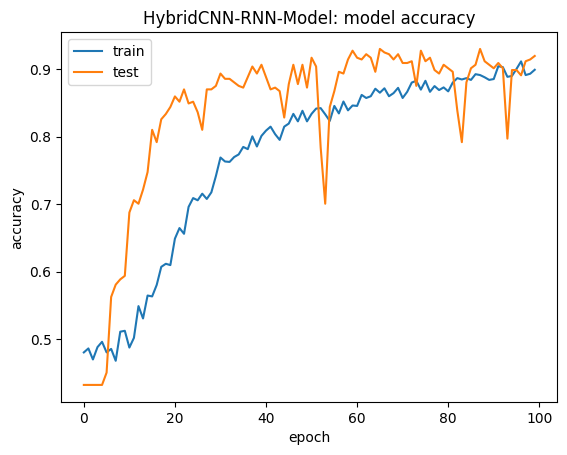

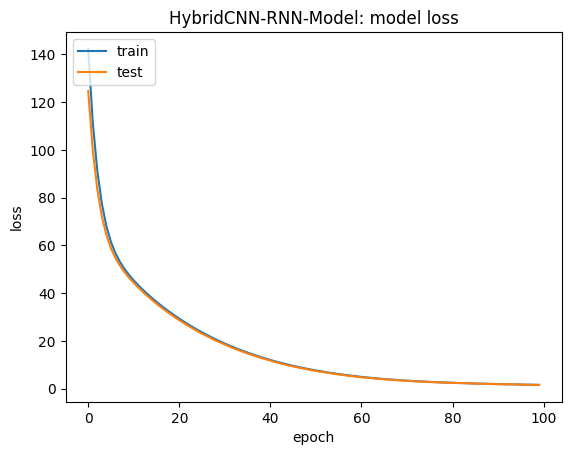

Model reset / re-compiled for next fold
Train labels Distribution:
  Total: 1916
  Animal (1): 1088 (56.78%)
  No_Animal (0): 828 (43.22%)

Forcing garbage collection
2025-02-06 11:58:37
Congratulations! You've fired the Auto_proc_status_update event


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
from sklearn.utils import class_weight
from keras.callbacks import EarlyStopping
import pandas as pd
from tensorflow.keras import backend as K

print("Starting")
gc.collect()
output_datetimestamp()

#Old benchmark: 41/41 [==============================] - 5s 122ms/step - loss: 0.3525 - binary_accuracy: 0.8679 - val_loss: 0.3286 - val_binary_accuracy: 0.9286
#First cut hybrid benchmark: 19/19 [==============================] - 1s 74ms/step - loss: 0.4813 - binary_accuracy: 0.9900 - val_loss: 0.4735 - val_binary_accuracy: 0.9799
#Slimmed-down hybrid benchmark:23/23 [==============================] - 1s 52ms/step - loss: 0.1722 - binary_accuracy: 0.9986 - val_loss: 0.1490 - val_binary_accuracy: 0.9944
#Slim, 7 splits 2 patience bench: 25/25 [==============================] - 1s 49ms/step - loss: 0.1607 - binary_accuracy: 0.9948 - val_loss: 0.1412 - val_binary_accuracy: 0.9922

# Full Training or Keras Tuner Hyperparameter Search
FULL_TRAINING = True

# Patience
PATIENCE = 10
# Epochs
EPOCHS = 100
# Batch Size
BATCH_SIZE = 8 #Keras default is 32
# Model Accuracy Save  Threshold
MODEL_ACCURACY_SAVE_THRESH = 0.92

TRAINING_PARMS = "Training Parms: \n\t Patience = " + str(PATIENCE) + "\n\t Epochs = " + str(EPOCHS) + "\n\t Batch Size = " + str(BATCH_SIZE)

if not FULL_TRAINING:
  # Number of folds
  SPLITS = 5
  TRAINING_PARMS = "Training Parms: \n\t Splits = " + str(SPLITS) + "\n\t Patience = " + str(PATIENCE) + "\n\t Epochs = " + str(EPOCHS) + "\n\t Batch Size = " + str(BATCH_SIZE)

def report_on_data(train_x, train_y, test_x, test_y):
  print("train_x metadata: ")
  print(train_x.shape)
  print(train_x.dtype)

  print("train_y metadata: ")
  print(train_y.shape)
  print(train_y.dtype)
  print("test_x metadata: ")
  print(test_x.shape)
  print("test_x metadata: ")
  print(test_y.shape)

def process_and_report_on_data_before_training(data, labels):
  print("Starting data shape, shape & type of first element")
  print(data.shape)      # Check the shape of the data list (should be (28,))
  print(data[0].shape)   # Check the shape of the first image array (should be (600, 450, 3))
  print(data[0].dtype)   # Check the data type of the first image array (should be np.ndarray)
  data = data.astype(np.float32)
  labels = labels.astype(np.float32)
  print(labels)
  print("Starting labels shape & type")
  print(labels.shape)    # Check the shape of the labels list (should be (28,))
  print(labels.dtype)    # Check the data type of the labels list (should be np.ndarray)
  return data, labels

def get_model_checkpoint(temp_model_path):
  from tensorflow.keras.callbacks import ModelCheckpoint
  class CustomModelCheckpoint(ModelCheckpoint):
    def __init__(self, filepath, monitor='val_accuracy', mode='max', save_best_only=True, min_accuracy=MODEL_ACCURACY_SAVE_THRESH, save_weights_only=False):
        super(CustomModelCheckpoint, self).__init__(
            filepath,
            monitor=monitor,
            mode=mode,
            save_best_only=save_best_only,
            save_weights_only=save_weights_only
        )
        self.min_accuracy = min_accuracy

    def on_epoch_end(self, epoch, logs=None):
        # Check if the performance metric meets the minimum accuracy
        current_accuracy = logs.get(self.monitor)
        if current_accuracy >= self.min_accuracy:
            super().on_epoch_end(epoch, logs)


  model_checkpoint = CustomModelCheckpoint(
    temp_model_path,
    monitor='val_binary_accuracy',
    save_weights_only=False,
    save_best_only=True,
    mode='max',
    min_accuracy=MODEL_ACCURACY_SAVE_THRESH
  )
  return model_checkpoint

def get_early_stopping():
    early_stopping = EarlyStopping(
      monitor='val_loss',
      patience=PATIENCE,
      mode='min',
      verbose=1)
    return early_stopping

def get_LR():
  return tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,   # Reduce LR by a factor of 10
    patience=5,   # Wait for 5 epochs with no improvement
    min_lr=1e-9   # Don't reduce below this
  )

def get_class_weights_dict(labels):
  # Compute class weights
  class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(labels), y=labels)
  # Convert class weights to a dictionary
  class_weights_dict = {class_label: weight for class_label, weight in zip(np.unique(labels), class_weights)}
  print("class_weights_dict = " + str(class_weights_dict))
  return class_weights_dict

def do_keras_tuning(i=0):
  keras_tuner_dir = os.path.join(model_dir,"keras_tuner")
  # Stratified K-Fold Cross-Validation
  for train_index, test_index in skf.split(data, labels):
    i += 1

    train_x, test_x = data[train_index], data[test_index]
    train_y, test_y = labels[train_index], labels[test_index]
    report_on_data(train_x, train_y, test_x, test_y)

    # Save the model weights
    print("Keras MODEL_NAME: " + MODEL_NAME)
    print("Keras model_dir: " + model_dir)
    print("Keras i: " + str(i))

    temp_model_filename = (MODEL_NAME + "KerasTuner -F{i:02d} -E{epoch:02d} -VBA{val_binary_accuracy:.2f}" + str(i) + ".tf")
    temp_model_path = os.path.join(model_dir,temp_model_filename)

    print("Keras temp_model_path: " + temp_model_path)

    model_checkpoint = get_model_checkpoint(temp_model_path)
    early_stopping = get_early_stopping()

    # Define the tuner
    tuner = kt.Hyperband(
        build_model,
        objective='val_binary_accuracy',
        max_epochs=10,
        directory=keras_tuner_dir,
        project_name='tuning'
    )
    class_weights_dict = get_class_weights_dict(labels)

      # Start search
    tuner.search(train_x, train_y,
                epochs=50,
                validation_data=(test_x, test_y),
                class_weight=class_weights_dict,
                callbacks=[model_checkpoint, early_stopping])

  gc.collect()
  K.clear_session()
  print("Keras Tuner Run Complete, session cleared")
  return tuner

#Execution Area
orig_data = data.copy()

# Convert the 1D array to a 3D array with shape (28, 600, 450, 3)
data = np.stack(data)

data, labels = process_and_report_on_data_before_training(data, labels)

if FULL_TRAINING:
  #Separate training and validation set
  #WITHOLD FRACTION OF TRAINING DATA FOR VALIDATION
  #train_x, test_x, train_y, test_y = train_test_split(data, labels, test_size=0.05)
  train_x, test_x, train_y, test_y = train_test_split(
    data, labels, test_size=0.2, random_state=42, stratify=labels)
  # report_on_data(train_x, train_y, test_x, test_y)
  #USE ALL TRAINING DATA AND USE TEST DATA FOR VALIDATION
  # train_x = data
  # train_y = labels
  # test_x = test_data
  # test_y = test_labels
else:
  # Create StratifiedKFold object
  skf = StratifiedKFold(n_splits=SPLITS, shuffle=True, random_state=42)

#scores = []
i=0
if FULL_TRAINING:
  # Save the model weights
  temp_model_filename = f"{MODEL_NAME}_FullTrain_E{{epoch:02d}}_VBA{{val_binary_accuracy:.2f}}.keras"
  temp_model_path = os.path.join(model_dir, temp_model_filename)

  print("temp_model_path: " + temp_model_path)

  model_checkpoint = get_model_checkpoint(temp_model_path)
  early_stopping = get_early_stopping()
  lr_callback = get_LR()

  class_weights_dict = get_class_weights_dict(labels)

  score = model.fit(train_x,
                    train_y,
                    epochs=EPOCHS,
                    batch_size=BATCH_SIZE,
                    verbose=1,
                    shuffle=True,
                    validation_data=(test_x, test_y),
                    callbacks=[early_stopping, model_checkpoint, lr_callback],
                    class_weight=class_weights_dict)


  print("HybridCNN-RNN-Model training results....")
  graph_model_performance("HybridCNN-RNN-Model", score)
  gc.collect()
  K.clear_session()
  print("Model reset / re-compiled for next fold")
else:
  tuner = do_keras_tuning(i)

update_model_parms_for_reporting(TRAINING_PARMS + "\n\t " + get_datetimestamp())

# Review distributions
print_label_distribution_numeric(labels, "Train labels")

data = None
data = orig_data
print("Forcing garbage collection")
gc.collect()

output_datetimestamp()
send_ifttt_notification("Model Training", "Complete")

beep(3)


# Feature Visualization

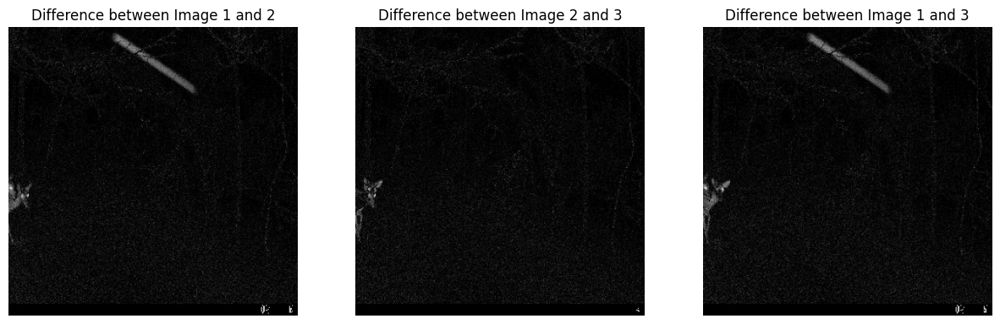

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_diffs(img1,img2,img3):
  # Assuming img1, img2, img3 are your images loaded using cv2.imread or a similar method
  diff12 = cv2.absdiff(img1, img2)
  diff23 = cv2.absdiff(img2, img3)
  diff13 = cv2.absdiff(img1, img3)

  # Visualize the differences
  fig, ax = plt.subplots(1, 3, figsize=(15, 5))
  ax[0].imshow(cv2.cvtColor(diff12, cv2.COLOR_BGR2RGB))
  ax[0].set_title('Difference between Image 1 and 2')
  ax[0].axis('off')

  ax[1].imshow(cv2.cvtColor(diff23, cv2.COLOR_BGR2RGB))
  ax[1].set_title('Difference between Image 2 and 3')
  ax[1].axis('off')

  ax[2].imshow(cv2.cvtColor(diff13, cv2.COLOR_BGR2RGB))
  ax[2].set_title('Difference between Image 1 and 3')
  ax[2].axis('off')

  plt.show()

# Execution area
# Look at diffs from some events
img_diffs_to_visualize = [3, 4, 10, 15, 20, 25, 30, 35]
for i in img_diffs_to_visualize:
  event = test_data[i]
  display_images([i],[event[0]])
  print("Visualizing diffs for event:", i)
  visualize_diffs(event[0], event[1], event[2])


In [ ]:
#Spatial features from CNNs
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D

def visualize_model_activations(model, event_data):
    # Ensure the event_data is correctly shaped for the model
    if event_data.shape == (3, 299, 299, 3):
        # Add a batch dimension
        img_batch = np.expand_dims(event_data, axis=0)

        # Extract the internal model from the TimeDistributed layer
        internal_model = None
        for layer in model.layers:
            if isinstance(layer, TimeDistributed):
                internal_model = layer.layer
                break

        if internal_model is None:
            print("No internal model found within TimeDistributed layer.")
            return

        # Extract Conv2D layers from the internal model
        conv_layers = [l for l in internal_model.layers if isinstance(l, Conv2D)]

        if not conv_layers:
            print("No Conv2D layers found in the internal model.")
            return

        # Create a model for feature extraction
        feature_map_model = Model(inputs=internal_model.input, outputs=[l.output for l in conv_layers])

        # Predict feature maps for the first frame of the event
        feature_maps = feature_map_model.predict(img_batch[:, 0, ...])

        # Visualization of feature maps
        for feature_map, layer in zip(feature_maps, conv_layers):
            print(f"Visualizing {layer.name} with shape {feature_map.shape}")
            n_features = feature_map.shape[-1]  # Number of features in the feature map
            size = feature_map.shape[1]  # The feature map has shape (1, size, size, n_features)

            # We will tile our images in this matrix
            display_grid = np.zeros((size, size * n_features))

            for i in range(n_features):
                # Postprocess the feature to make it visually palatable
                x = feature_map[0, :, :, i]
                x -= x.mean()
                x /= (x.std() + 1e-5)  # Add epsilon to standard deviation to avoid division by zero
                x *= 64
                x += 128
                x = np.clip(x, 0, 255).astype('uint8')

                # Tile each filter into a big horizontal grid
                display_grid[:, i * size: (i + 1) * size] = x

            scale = 20. / n_features
            plt.figure(figsize=(scale * n_features, scale))
            plt.title(layer.name)
            plt.grid(False)
            plt.imshow(display_grid, aspect='auto', cmap='viridis')

        plt.show()
    else:
        print("event_data has incorrect shape:", event_data.shape)

# Assuming 'prod_model' is your trained model and 'img_batch' is the preprocessed batch of images:
# model = get_prod_runtime_model()
visualize_model_activations(model, data[446])
visualize_model_activations(model, data[223])

visualize_model_activations(model, data[300])
visualize_model_activations(model, data[400])
beep()


1/1 [==============================] - 0s 326ms/step
Visualizing conv2d with shape (297, 297, 16)


IndexError: too many indices for array: array is 3-dimensional, but 4 were indexed

# Evaluate model on test data

Starting
2025-02-06 11:58:41


Model: "combined_cnn_rnn_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ video_input (InputLayer)  │ (None, 3, 299, 299, 3) │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize-224             │ (None, 3, 224, 224, 3) │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize-112             │ (None, 3, 112, 112, 3) │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize-56              │ (None, 3, 56, 56, 3)   │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ abs_diff_layer            │ (None, 2, 224, 224, 3) │              0 │ TD-Resize-224[0][0]    │
│ (SequentialAbsoluteDiffe… │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-RawImg-MobileNet       │ (None, 3, 7, 7, 960)   │      2,996,352 │ TD-Resize-224[0][0]    │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ time_distributed_high     │ (None, 3, 32)          │          5,280 │ TD-Resize-224[0][0]    │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ time_distributed_medium   │ (None, 3, 32)          │          5,280 │ TD-Resize-112[0][0]    │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ time_distributed_low      │ (None, 3, 32)          │          5,280 │ TD-Resize-56[0][0]     │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Pool              │ (None, 2, 3)           │              0 │ abs_diff_layer[0][0]   │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Flatten                │ (None, 3, 47040)       │              0 │ TD-RawImg-MobileNet[0… │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 3, 96)          │              0 │ time_distributed_high… │
│                           │                        │                │ time_distributed_medi… │
│                           │                        │                │ time_distributed_low[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Bi-GRU            │ (None, 2, 128)         │         26,496 │ AbsDiff-Pool[0][0]     │
│ (Bidirectional)           │                        │                │                        │
├──────────────────────

 Total params: 78,343,381 (298.86 MB)

 Trainable params: 26,106,017 (99.59 MB)

 Non-trainable params: 25,328 (98.94 KB)

 Optimizer params: 52,212,036 (199.17 MB)

Evaluating model...

Model Name: EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense
Training Parms: 
	 Patience = 10
	 Epochs = 100
	 Batch Size = 8
	 2025-02-06 11:58:36
Test labels Distribution:
  Total: 145
  Animal (1): 42 (28.97%)
  No_Animal (0): 103 (71.03%)

5/5 ━━━━━━━━━━━━━━━━━━━━ 24s 3s/step


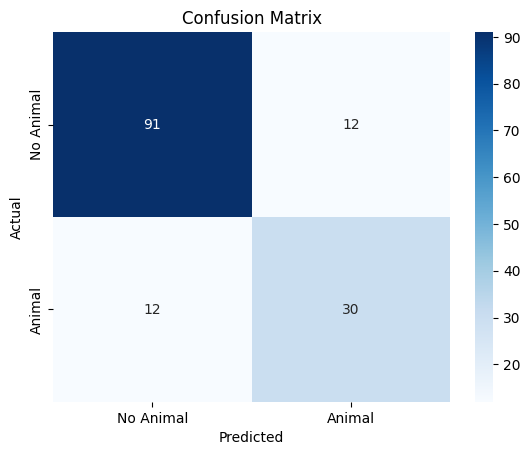

5/5 ━━━━━━━━━━━━━━━━━━━━ 11s 86ms/step - auc: 0.7251 - binary_accuracy: 0.8233 - loss: 1.6575 - precision: 0.8551 - recall: 0.7254
Test Loss: 1.5460642576217651
Test Accuracy: 0.834482729434967
Test Precision: 0.7142857313156128
Test Recall: 0.7142857313156128
Test AUC: 0.8454691767692566
Test F1 Score: 0.7142857142857143
Test labels: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0.]
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
y_pred (raw confidence): [0.51 0.12 0.51 0.51 0.51 0.51 0.5  0.51 0.51 0.51 0.51 0.51 0.51 0.51
 0.51 0.51 0.08 0.49 0.51 0.51 0.21 0.23 0.51 0.51 0.14 0.51 0.51 0.51
 0.51 0.51 0.51

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

2025-02-06 11:59:22


In [ ]:
# Evaluate the model on test data
from sklearn.metrics import f1_score
from tensorflow.keras.preprocessing.image import ImageDataGenerator


print("Starting")
gc.collect()
output_datetimestamp()

# Evaluate the model on the test data
# NOTE! will load curr prod model if not coming from training
LOAD_MODEL = False
EVAL_KERAS_TUNED_MODEL = False
if LOAD_MODEL:
  model = get_prod_runtime_model()
else:
  if EVAL_KERAS_TUNED_MODEL:
    model = tuner.get_best_models(num_models=1)[0]
  else:
    models_to_eval = []
    # model = create_hybrid_model()
    # model.load_weights(os.path.join(model_dir,"no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1DenseFull-Train -E10 -VBA0.91.tf"))
    models_to_eval.append(model)
    # model.load_weights(os.path.join(model_dir,"no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1DenseFull-Train -E05 -VBA0.91.tf"))
    # models_to_eval.append(model)
    # for mod in models_to_eval:
    #   mod.summary()
    model = models_to_eval[0]#model #Eval what was last trained

# Compile the model
model.summary()
print("Evaluating model...")
print_model_parms_for_reporting()
test_data = np.stack(test_data)
test_labels = test_labels.astype(np.float32)
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
#Review Distributions
print_label_distribution_numeric(test_labels, "Test labels")

# Assuming 'model' is your trained model and 'X_test' is your test data
y_pred_prob = model.predict(test_data)
y_pred = (y_pred_prob > 0.5).astype(int)  # Convert probabilities to binary labels

# Assuming 'y_true' contains your true labels (0 or 1)
cm = confusion_matrix(test_labels, y_pred)

# Visualizing the confusion matrix
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['No Animal', 'Animal'], yticklabels=['No Animal', 'Animal'])
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion Matrix')
plt.show()

test_loss, test_accuracy, test_precision, test_recall, test_auc = model.evaluate(test_data,test_labels)
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)
print("Test Precision:", test_precision)
print("Test Recall:", test_recall)
print("Test AUC:", test_auc)

test_f1 = f1_score(test_labels, y_pred)
print("Test F1 Score:", test_f1)

print("Test labels: " + str(test_labels))


# Make predictions on the test data
y_pred = model.predict(test_data)
print("y_pred (raw confidence): " + str(np.round(y_pred, decimals=2).flatten()))

y_pred = np.round(y_pred).flatten()
print("y_pred (flattened & rounded): " + str(y_pred))

# Calculate the F1 score
test_f1 = f1_score(test_labels, y_pred)
print("Test F1 Score:", test_f1)

# Calculate the combined metric as the sum of F1 score and validation accuracy
if (test_f1 is not None and test_accuracy is not None):
  combined_metric = test_f1 + test_accuracy
else:
  combined_metric = 0.0
print("Test combined score: " + str(combined_metric))

print("Model evaluation COMPLETE *yay*")
beep(3)
output_datetimestamp()

# Production classifier cell

In [ ]:
#Production classifier cell
#!pip install autokeras
import os
import pickle
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from keras.models import model_from_json
import cv2
from tqdm import tqdm
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import load_img, img_to_array

#SWITCHES
# Load saved model or use model already in memory
LOAD_MODEL = True
LOAD_ZOOM_ENSEMBLE = False
LOAD_DATA = True
PICKLE_PROD_DATA = False
img_files = 0

print("Starting classification...")
# Define eval directory
eval_dir = root_dir + '/Pics_to_evaluate/Dec2024CarmenGifts'
#NON-AUTOMATED LATEST CHALLENGE: eval_dir = root_dir + '/Pics_to_evaluate/Jan2025CarmenGifts'
#img_dir_name1 = r"SB"
# Define specific directory to evaluate
#VERY VERY LATEST FROM DEC 2024
img_dir_name1 = r"241011-241202 East End Gm Trl"
# Derive path with images of interest
img_dir_path1 = os.path.join(eval_dir,img_dir_name1)
# Derive CSV report file name
output_csv_file1 = os.path.join(img_dir_path1, (img_dir_name1 + '_REPORT.csv'))

# Define specific directory to evaluate
#VERY VERY LATEST FROM DEC 2024 #COMMENT OUT WITH "" IF NOT DOING AUTOMATED PROD EVAL TESTS!
img_dir_name2 = r"241011-241202 SB Cliffs Gm Tr"
# Derive path with images of interest
img_dir_path2 = os.path.join(eval_dir,img_dir_name2)
# Derive CSV report file name
output_csv_file2 = os.path.join(img_dir_path2, (img_dir_name2 + '_REPORT.csv'))


def pad_events(events, file_names, target_length=3):
    padded_events = []
    padded_file_names = []
    for event, files in zip(events, file_names):
        while len(event) < target_length:
            event.append(event[-1])  # Append the last image
            files.append(files[-1])  # Append the filename of the last image
        padded_events.append(event[:target_length])
        padded_file_names.append(files[:target_length])
    return np.array(padded_events), padded_file_names

def load_production_data(directory_path):
  # all_images = []
  all_file_names = []
  jpg_files = []  # List to store all jpg files
  for subdir, dirs, files in os.walk(directory_path):
      files.sort()  # Ensure files are sorted to maintain order
      for file in files:
          if file.lower().endswith(".jpg"):  # Added case insensitivity
              jpg_files.append(file)
              file_path = os.path.join(subdir, file)
              # #TODO: SHOULD THIS BE HERE? image = load_and_preprocess_image(file_path)
              # all_images.append(image)
              all_file_names.append(file)

  if not jpg_files:
      print("No .jpg files found in the directory: " + directory_path)  # Debug print
      return [], []

  tot_img_files = len(jpg_files)
  print("Total img files: " + str(tot_img_files))
  print("JPGs: \n")
  print(jpg_files)

  # Group images by events based on file names of jpg files
  grouped_files = group_files_by_base_name(jpg_files)
  groups_by_events = assign_event_numbers_to_groups(grouped_files)

  if not groups_by_events:
      print("No groups formed from the .jpg files.")  # Debug print
      return [], []

  # Load and preprocess images, then pad events
  events, file_names = [], []
  z1pt5events = []
  z3pt0events = []
  for event_files in groups_by_events.values():
    event, files = [], []
    z1pt5event = []
    z3pt0event = []
    for file in event_files:
      # Read the image
      image = cv2.imread(os.path.join(directory_path, file))
      if image is not None:
          # Zoom the image
          z1pt5_image = zoom_image(image, 1.5)
          z3pt0_image = zoom_image(image, 3.0)
          print("Processing file: " + file)
      else:
          print("Failed to read image: " + file)
      event.append(preprocess_image(resize_image(image))) #TODO: why doesn't this use load_image and regardless, resize doesn't seem to like meta data band removal code in preprocess_image
      files.append(file)
      z1pt5event.append(preprocess_image(resize_image(z1pt5_image)))
      z3pt0event.append(preprocess_image(resize_image(z3pt0_image)))

    events.append(event)
    file_names.append(files)
    z1pt5events.append(z1pt5event)
    z3pt0events.append(z3pt0event)

  if not events:
      print("No events formed from the grouped files.")  # Debug print

  padded_events, padded_file_names = pad_events(events, file_names)
  z1pt5padded_events, z1pt5padded_file_names = pad_events(z1pt5events, file_names)
  z3pt0padded_events, z3pt0padded_file_names = pad_events(z3pt0events, file_names)
  return padded_events, padded_file_names, z1pt5padded_events, z3pt0padded_events

def save_pickled_production_data(a_path, a_suffix, prod_data, prod_file_names, z1pt5_prod_data, z3pt0_prod_data):
  print("Saving pickled production data...")
  with open(os.path.join(a_path, 'prod_data'+a_suffix+'.pkl'), 'wb') as f:
      pickle.dump(prod_data, f)
  with open(os.path.join(a_path, 'prod_file_names'+a_suffix+'.pkl'), 'wb') as f:
      pickle.dump(prod_file_names, f)
  with open(os.path.join(a_path, 'z1pt5_prod_data'+a_suffix+'.pkl'), 'wb') as f:
      pickle.dump(z1pt5_prod_data, f)
  with open(os.path.join(a_path, 'z3pt0_prod_data'+a_suffix+'.pkl'), 'wb') as f:
      pickle.dump(z3pt0_prod_data, f)
  print("Pickled production data saved.")

def load_pickled_production_data(a_path, a_suffix):
  print("Loading pickled production data...")
  with open(os.path.join(a_path, 'prod_data'+a_suffix+'.pkl'), 'rb') as f:
      prod_data = pickle.load(f)
  with open(os.path.join(a_path, 'prod_file_names'+a_suffix+'.pkl'), 'rb') as f:
      prod_file_names = pickle.load(f)
  with open(os.path.join(a_path, 'z1pt5_prod_data'+a_suffix+'.pkl'), 'rb') as f:
      z1pt5_prod_data = pickle.load(f)
  with open(os.path.join(a_path, 'z3pt0_prod_data'+a_suffix+'.pkl'), 'rb') as f:
      z3pt0_prod_data = pickle.load(f)
  print("Pickled production data loaded.")
  return prod_data, prod_file_names, z1pt5_prod_data, z3pt0_prod_data


prod_data = None

# Define a function to classify images in a img file
def classify_images_in_directory(models, event_dir_path, a_suffix, output_csv_file):
    if len(models) <2:
        model = models[0]
    else:
        no_zoom_model = models[0]
        zoom1pt5_model = models[1]
        zoom3pt0_model = models[2]
    # Get the events and their images from the directory
    # For now, assume we're iterating many times over this 2005-230610_Spring_House_Meadow data
    global prod_data
    global prod_file_names
    # Load data if the switch is on and data is not already loaded
    if LOAD_DATA and prod_data is None:
      if PICKLE_PROD_DATA:
        prod_data, prod_file_names, z1pt5_prod_data, z3pt0_prod_data = load_pickled_production_data(eval_dir, a_suffix)
        print("Loaded pickled production data.")
      else:
        print("Loading production data...")
        prod_data, prod_file_names, z1pt5_prod_data, z3pt0_prod_data = load_production_data(event_dir_path)
        print("Loaded production data.")
        save_pickled_production_data(eval_dir, a_suffix, prod_data, prod_file_names, z1pt5_prod_data, z3pt0_prod_data)
    elif not LOAD_DATA:
        print("Data loading skipped as per LOAD_DATA switch.")

    # Ensure data is loaded before proceeding
    if prod_data is None or prod_file_names is None:
        print("Data is not loaded. Please check your LOAD_DATA switch and data loading mechanism.")
        return []

    # Create empty lists to store the results
    results = []
    in_mem_prod_results = []
    in_mem_prod_event_results = []

    i = 0
    for event, files, z1pt5_event, z3pt0_event in zip(prod_data, prod_file_names, z1pt5_prod_data, z3pt0_prod_data):

        if LOAD_ZOOM_ENSEMBLE:
          # Perform prediction
          no_zoom_prediction = no_zoom_model.predict(np.expand_dims(event, axis=0), verbose=1)[0]
          zoom1pt5_prediction = zoom1pt5_model.predict(np.expand_dims(z1pt5_event, axis=0), verbose=1)[0]
          zoom3pt0_prediction = zoom3pt0_model.predict(np.expand_dims(z3pt0_event, axis=0), verbose=1)[0]
          prediction = [(no_zoom_prediction[0] + zoom1pt5_prediction[0] + zoom3pt0_prediction[0])/3]
        else:
          # Perform prediction
          prediction = model.predict(np.expand_dims(event, axis=0), verbose=1)[0]
        # Extract the class and confidence
        animal_class = 'No_Animal' if prediction[0] < 0.5 else 'Animal'
        confidence = float(prediction[0])
        if LOAD_ZOOM_ENSEMBLE:
          no_z_conf = float(no_zoom_prediction[0])
          z1pt5_conf = float(zoom1pt5_prediction[0])
          z3pt0_conf = float(zoom3pt0_prediction[0])
          # Append the result to the list for each file in the event
          for file_name in files:
              temp_results = {'file_name': file_name, 'class': animal_class, 'avg conf': confidence, 'no_z conf': no_z_conf, 'z1pt5 conf': z1pt5_conf, 'z3pt0 conf': z3pt0_conf}
              results.append(temp_results)
              in_mem_prod_results.append([file_name, animal_class, confidence])
        else:
          #in_mem_prod_event_results.append([event, animal_class, files])
          in_mem_prod_event_results.append([event, animal_class, files, float(prediction[0])])

          # Append the result to the list for each file in the event
          for file_name in files:
              temp_results = {'file_name': file_name, 'class': animal_class, 'avg conf': confidence}
              results.append(temp_results)
              in_mem_prod_results.append([file_name, animal_class, confidence])
        if LOAD_ZOOM_ENSEMBLE:
          display_images_side_by_side([event[0], z1pt5_event[0], z3pt0_event[0]], ["0z: " + str(no_z_conf), "1.5z: " + str(z1pt5_conf), "3.0z: " + str(z3pt0_conf)], file_name + "\nPred Class: " + animal_class + " Avg_conf:" + str(confidence))

    df_results = pd.DataFrame(results)
    df_results.to_csv(output_csv_file, index=False)
    return in_mem_prod_results, prod_data, prod_file_names, in_mem_prod_event_results

def do_init():
  #Production classifier init cell (to save time in training to not have to reload data every time)
  # Global variables (Initialization cell, run this once)
  global prod_models
  global prod_data
  global prod_file_names
  prod_data, prod_file_names = None, None
  if LOAD_MODEL:
    if LOAD_ZOOM_ENSEMBLE:
      prod_models = get_prod_zoom_ensemble_models()
    else:
      prod_models = [get_prod_runtime_model()]
      prod_models[0].summary()
  else:
    models_to_eval = []
    model = create_combined_model()
    # model.load_weights(os.path.join(model_dir,"no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1DenseFull-Train -E07 -VBA0.93.tf"))
    # models_to_eval.append(model)
    #model.load_weights(os.path.join(model_dir,"no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1DenseFull-Train -E10 -VBA0.91.tf"))
    models_to_eval.append(model)
    # for mod in models_to_eval:
    #   mod.summary()
    prod_models = models_to_eval#[model]
    prod_models[0].summary()

#EXECUTION AREA

# Load the model
do_init()
print(f"Starting evaluation of images in {img_dir_path1} & {img_dir_path2}...")
beep(1)
in_mem_prod_results1, prod1, prodfiles1,in_mem_prod_event_results1 = classify_images_in_directory(prod_models, img_dir_path1, '1', output_csv_file1)
print(f"Temporarily stored prod_data size: ({len(prod_data)}) in prod1 size: {len(prod1)} & prod_file_names size: ({len(prod_file_names)}) in prodfiles1 size: {len(prodfiles1)}")
# Load the model
if img_dir_name2 != "":
  do_init()
  in_mem_prod_results2, prod2, prodfiles2,in_mem_prod_event_results2 = classify_images_in_directory(prod_models, img_dir_path2, '2', output_csv_file2)
  print(f"Temporarily stored prod_data size: ({len(prod_data)}) in prod2 size: {len(prod2)} & prod_file_names size: ({len(prod_file_names)}) in prodfiles2 size: {len(prodfiles2)}")
else:
  in_mem_prod_results2 = None
  prod2 = None
  prodfiles2 = None
  in_mem_prod_event_results2 = None
print(f"Evaluation complete. Report result exported to: {output_csv_file1} & {output_csv_file2}")
beep(3)
output_datetimestamp()

Starting classification...
Loading model
model_dir: /content/drive/MyDrive/Model
Model loaded


Model: "combined_cnn_rnn_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ video_input (InputLayer)  │ (None, 3, 299, 299, 3) │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize                 │ (None, 3, 224, 224, 3) │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ abs_diff_layer            │ (None, 2, 299, 299, 3) │              0 │ video_input[0][0]      │
│ (SequentialAbsoluteDiffe… │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-RawImg-MobileNet       │ (None, 3, 7, 7, 960)   │      2,996,352 │ TD-Resize[0][0]        │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Pool              │ (None, 2, 3)           │              0 │ abs_diff_layer[0][0]   │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Flatten                │ (None, 3, 47040)       │              0 │ TD-RawImg-MobileNet[0… │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Bi-GRU            │ (None, 2, 128)         │         26,496 │ AbsDiff-Pool[0][0]     │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Raw-Bi-GRU                │ (None, 3, 128)         │     18,088,704 │ TD-Flatten[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ RawImg-GAPPool2D          │ (None, 3, 960)         │              0 │ TD-RawImg-MobileNet[0… │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Bi-GRU-2          │ (None, 64)             │         31,104 │ AbsDiff-Bi-GRU[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Raw-Bi-GRU-2              │ (None, 64)             │         31,104 │ Raw-Bi-GRU[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ RawImg-Time-GAPPool1D     │ (None, 960)            │              0 │ RawImg-GAPPool2D[0][0] │
│ (GlobalAveragePooling1D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 1088)           │              0 │ AbsDiff-Bi-GRU-2[0][0… │
│                           │                        │                │ Raw-Bi-GRU-2[0][0],    │
│                           │                        │                │ RawImg-Time-GAPPool1D… │
├──────────────────────

 Total params: 63,688,981 (242.95 MB)

 Trainable params: 21,221,313 (80.95 MB)

 Non-trainable params: 25,040 (97.81 KB)

 Optimizer params: 42,442,628 (161.91 MB)

Starting evaluation of images in /content/drive/MyDrive/Pics_to_evaluate/Dec2024CarmenGifts/241011-241202 East End Gm Trl & /content/drive/MyDrive/Pics_to_evaluate/Dec2024CarmenGifts/241011-241202 SB Cliffs Gm Tr...


<IPython.core.display.Javascript object>

Loading production data...
Total img files: 393
JPGs: 

['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0013.JPG', 'DSCF0014.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG', 'DSCF0021.JPG', 'DSCF0022.JPG', 'DSCF0023.JPG', 'DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG', 'DSCF0029.JPG', 'DSCF0030.JPG', 'DSCF0031.JPG', 'DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0037.JPG', 'DSCF0038.JPG', 'DSCF0039.JPG', 'DSCF0041.JPG', 'DSCF0042.JPG', 'DSCF0043.JPG', 'DSCF0045.JPG', 'DSCF0046.JPG', 'DSCF0047.JPG', 'DSCF0049.JPG', 'DSCF0050.JPG', 'DSCF0051.JPG', 'DSCF0053.JPG', 'DSCF0054.JPG', 'DSCF0055.JPG', 'DSCF0057.JPG', 'DSCF0058.JPG', 'DSCF0059.JPG', 'DSCF0061.JPG', 'DSCF0062.JPG', 'DSCF0063.JPG', 'DSCF0065.JPG', 'DSCF0066.JPG', 'DSCF0067.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG', 'DSCF0077.JPG', 'DSCF0078.JPG',

Model: "combined_cnn_rnn_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ video_input (InputLayer)  │ (None, 3, 299, 299, 3) │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize                 │ (None, 3, 224, 224, 3) │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ abs_diff_layer            │ (None, 2, 299, 299, 3) │              0 │ video_input[0][0]      │
│ (SequentialAbsoluteDiffe… │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-RawImg-MobileNet       │ (None, 3, 7, 7, 960)   │      2,996,352 │ TD-Resize[0][0]        │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Pool              │ (None, 2, 3)           │              0 │ abs_diff_layer[0][0]   │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Flatten                │ (None, 3, 47040)       │              0 │ TD-RawImg-MobileNet[0… │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Bi-GRU            │ (None, 2, 128)         │         26,496 │ AbsDiff-Pool[0][0]     │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Raw-Bi-GRU                │ (None, 3, 128)         │     18,088,704 │ TD-Flatten[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ RawImg-GAPPool2D          │ (None, 3, 960)         │              0 │ TD-RawImg-MobileNet[0… │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Bi-GRU-2          │ (None, 64)             │         31,104 │ AbsDiff-Bi-GRU[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Raw-Bi-GRU-2              │ (None, 64)             │         31,104 │ Raw-Bi-GRU[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ RawImg-Time-GAPPool1D     │ (None, 960)            │              0 │ RawImg-GAPPool2D[0][0] │
│ (GlobalAveragePooling1D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 1088)           │              0 │ AbsDiff-Bi-GRU-2[0][0… │
│                           │                        │                │ Raw-Bi-GRU-2[0][0],    │
│                           │                        │                │ RawImg-Time-GAPPool1D… │
├──────────────────────

 Total params: 63,688,981 (242.95 MB)

 Trainable params: 21,221,313 (80.95 MB)

 Non-trainable params: 25,040 (97.81 KB)

 Optimizer params: 42,442,628 (161.91 MB)

Loading production data...
Total img files: 288
JPGs: 

['DSCF0345.JPG', 'DSCF0346.JPG', 'DSCF0347.JPG', 'DSCF0405.JPG', 'DSCF0406.JPG', 'DSCF0407.JPG', 'DSCF0409.JPG', 'DSCF0410.JPG', 'DSCF0411.JPG', 'DSCF0417.JPG', 'DSCF0418.JPG', 'DSCF0419.JPG', 'DSCF0421.JPG', 'DSCF0422.JPG', 'DSCF0423.JPG', 'DSCF0425.JPG', 'DSCF0426.JPG', 'DSCF0427.JPG', 'DSCF0429.JPG', 'DSCF0430.JPG', 'DSCF0431.JPG', 'DSCF0433.JPG', 'DSCF0434.JPG', 'DSCF0435.JPG', 'DSCF0437.JPG', 'DSCF0438.JPG', 'DSCF0439.JPG', 'DSCF0441.JPG', 'DSCF0442.JPG', 'DSCF0443.JPG', 'DSCF0449.JPG', 'DSCF0450.JPG', 'DSCF0451.JPG', 'DSCF0453.JPG', 'DSCF0454.JPG', 'DSCF0455.JPG', 'DSCF0457.JPG', 'DSCF0458.JPG', 'DSCF0459.JPG', 'DSCF0461.JPG', 'DSCF0462.JPG', 'DSCF0463.JPG', 'DSCF0465.JPG', 'DSCF0466.JPG', 'DSCF0467.JPG', 'DSCF0469.JPG', 'DSCF0470.JPG', 'DSCF0471.JPG', 'DSCF0473.JPG', 'DSCF0474.JPG', 'DSCF0475.JPG', 'DSCF0477.JPG', 'DSCF0478.JPG', 'DSCF0479.JPG', 'DSCF0481.JPG', 'DSCF0482.JPG', 'DSCF0483.JPG', 'DSCF0485.JPG', 'DSCF0486.JPG',

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

2025-02-06 13:02:04


# Visualization of strengths & weaknesses


## Visualization Helper Functions

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

def load_and_display_images(image_filenames, folder_path, title, rows=3, cols=3):
    fig, axes = plt.subplots(rows, cols, figsize=(12, 12))
    fig.suptitle(title, fontsize=16)
    for ax, img_filename in zip(axes.flatten(), image_filenames):
        img_path = os.path.join(folder_path, img_filename)
        try:
            img = Image.open(img_path)
            ax.imshow(img)
            ax.set_title(img_filename)
            ax.axis('off')
        except FileNotFoundError:
            ax.axis('off')
            continue
    plt.tight_layout()
    plt.show()

def display_image_examples(event_info, title, rows=3, cols=3):
    #Abomination mem struct constants
    #list_index points to 3 items
    EVENT_IMAGES=0 #all 3 event images
    PRED_CLASS=1
    FILE_NAMES=2 #all 3 file names corresonding to the images

    fig, axes = plt.subplots(rows, cols, figsize=(12, 12))
    fig.suptitle(title, fontsize=16)

    # Flatten the axes array for easy iteration
    axes_flat = axes.flatten()

    all_images = []
    all_image_names = []

    for event in event_info:

      all_images.extend(event[EVENT_IMAGES])  # Add these images to all_images

      all_image_names.extend(event[FILE_NAMES])

    # Display the images
    # Make sure we don't exceed the axes available (rows*cols)
    for ax, img, fn in zip(axes_flat, all_images, all_image_names):
        ax.imshow(img)
        ax.set_title(fn)
        ax.axis('off')

    plt.tight_layout()
    plt.show()


def visualize_strengths_and_weaknesses(dict, img_dir_path, in_mem_prod_event_results):

  print("Visualizing model strengths and weaknesses on prod data")
  #Animals were predicted when animals were present
  correct_animal_predictions = dict['correct_predictions']
  print(f"correct_animal_predictions size: {len(correct_animal_predictions)}")

  #Incorrect predictions
  incorrect_no_animal_predictions = dict['incorrect_no_animal']
  print(f"incorrect_no_animal_predictions size: {len(incorrect_no_animal_predictions)}")
  incorrect_animal_predictions = dict['incorrect_animal']
  print(f"incorrect_animal_predictions size: {len(incorrect_animal_predictions)}")

  print("Performance Stats for " + img_dir_path + " :")
  print("\t Accuracy (correct predictions): " + str(dict['accuracy']))
  print("\t Precision: (correct animal preds)" + str(dict['precision']))
  print("\t Recall: (% of tot animals correctly detected)" + str(dict['recall']))
  print("\t F1 (avoidance of false pos & false neg 0-1, 1 is best): " + str(dict['f1_score']))
  # Display the images
  display_image_examples(correct_animal_predictions, 'Correct Animal Predictions')
  display_image_examples(incorrect_animal_predictions, 'Incorrect Animal Predictions (Hallucinated an animal)')
  display_image_examples(incorrect_no_animal_predictions, 'Incorrect No-animal Predictions (Missed an animal!)')

  # Visualizing the confusion matrix
  sns.heatmap(dict['confusion_matrix'], annot=True, fmt='d', cmap='Blues', xticklabels=['No Animal', 'Animal'], yticklabels=['No Animal', 'Animal'])
  plt.ylabel('Actual')
  plt.xlabel('Predicted')
  plt.title('Confusion Matrix')
  plt.show()

output_datetimestamp()

2025-02-06 13:02:04


## Prod Data Eval For Model Performance


Model name: EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense


Model: "combined_cnn_rnn_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ video_input (InputLayer)  │ (None, 3, 299, 299, 3) │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Resize                 │ (None, 3, 224, 224, 3) │              0 │ video_input[0][0]      │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ abs_diff_layer            │ (None, 2, 299, 299, 3) │              0 │ video_input[0][0]      │
│ (SequentialAbsoluteDiffe… │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-RawImg-MobileNet       │ (None, 3, 7, 7, 960)   │      2,996,352 │ TD-Resize[0][0]        │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Pool              │ (None, 2, 3)           │              0 │ abs_diff_layer[0][0]   │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ TD-Flatten                │ (None, 3, 47040)       │              0 │ TD-RawImg-MobileNet[0… │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Bi-GRU            │ (None, 2, 128)         │         26,496 │ AbsDiff-Pool[0][0]     │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Raw-Bi-GRU                │ (None, 3, 128)         │     18,088,704 │ TD-Flatten[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ RawImg-GAPPool2D          │ (None, 3, 960)         │              0 │ TD-RawImg-MobileNet[0… │
│ (TimeDistributed)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ AbsDiff-Bi-GRU-2          │ (None, 64)             │         31,104 │ AbsDiff-Bi-GRU[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Raw-Bi-GRU-2              │ (None, 64)             │         31,104 │ Raw-Bi-GRU[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ RawImg-Time-GAPPool1D     │ (None, 960)            │              0 │ RawImg-GAPPool2D[0][0] │
│ (GlobalAveragePooling1D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 1088)           │              0 │ AbsDiff-Bi-GRU-2[0][0… │
│                           │                        │                │ Raw-Bi-GRU-2[0][0],    │
│                           │                        │                │ RawImg-Time-GAPPool1D… │
├──────────────────────

 Total params: 63,688,981 (242.95 MB)

 Trainable params: 21,221,313 (80.95 MB)

 Non-trainable params: 25,040 (97.81 KB)

 Optimizer params: 42,442,628 (161.91 MB)

Prod SB_truth_table Distribution:
  Total: 288
  Animal (1): 165 (57.29%)
  No_Animal (0): 123 (42.71%)

Prod East_End_truth_table Distribution:
  Total: 393
  Animal (1): 318 (80.92%)
  No_Animal (0): 75 (19.08%)

Beginning evaluation of model performance on prod data for which we have labels/truth tables...
East End Truth Table len: 393
in_mem_prod_results1 len: 393
SB Truth Table len: 288
in_mem_prod_results2 len: 288
Evaluating model test set 1: /content/drive/MyDrive/Pics_to_evaluate/Dec2024CarmenGifts/241011-241202 East End Gm Trl ...

Model Name: EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense
Training Parms: 
	 Patience = 10
	 Epochs = 100
	 Batch Size = 8
	 2025-02-06 11:58:36
Sanity checking inputs...
in_mem_prod_event_event_results len: 131
first event image count: 3
first file name count: 3
last event image count: 3
last file name count: 3
sample pred class values: No_Animal
sample file name values: ['DSCF0049.JPG', 'DSCF0050.JPG', 'DSCF0051.JPG']
test_data sample: [

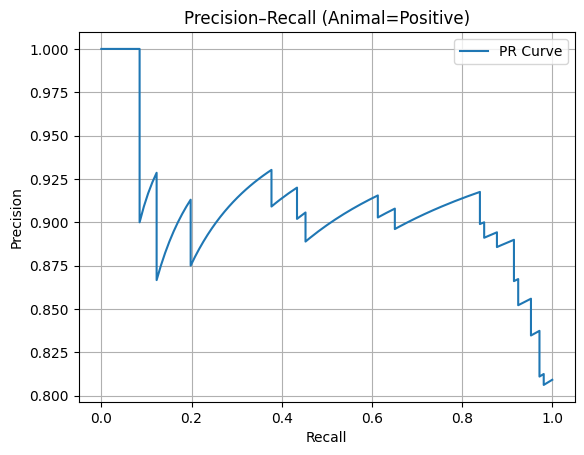

Chosen threshold = 0.4215494394302368, recall=0.9528301886792453, precision=0.8559322033898306
New metrics at threshold: 0.4215494394302368 Acc: 0.8320610687022901 Prec: 0.8559322033898306 Recall: 0.9528301886792453 F1: 0.9017857142857143
Done...Returning results.
Visualizing model strengths and weaknesses on prod data
correct_animal_predictions size: 9
incorrect_no_animal_predictions size: 9
incorrect_animal_predictions size: 9
Performance Stats for /content/drive/MyDrive/Pics_to_evaluate/Dec2024CarmenGifts/241011-241202 East End Gm Trl :
	 Accuracy (correct predictions): 0.8015267175572519
	 Precision: (correct animal preds)0.9
	 Recall: (% of tot animals correctly detected)0.8490566037735849
	 F1 (avoidance of false pos & false neg 0-1, 1 is best): 0.8737864077669902


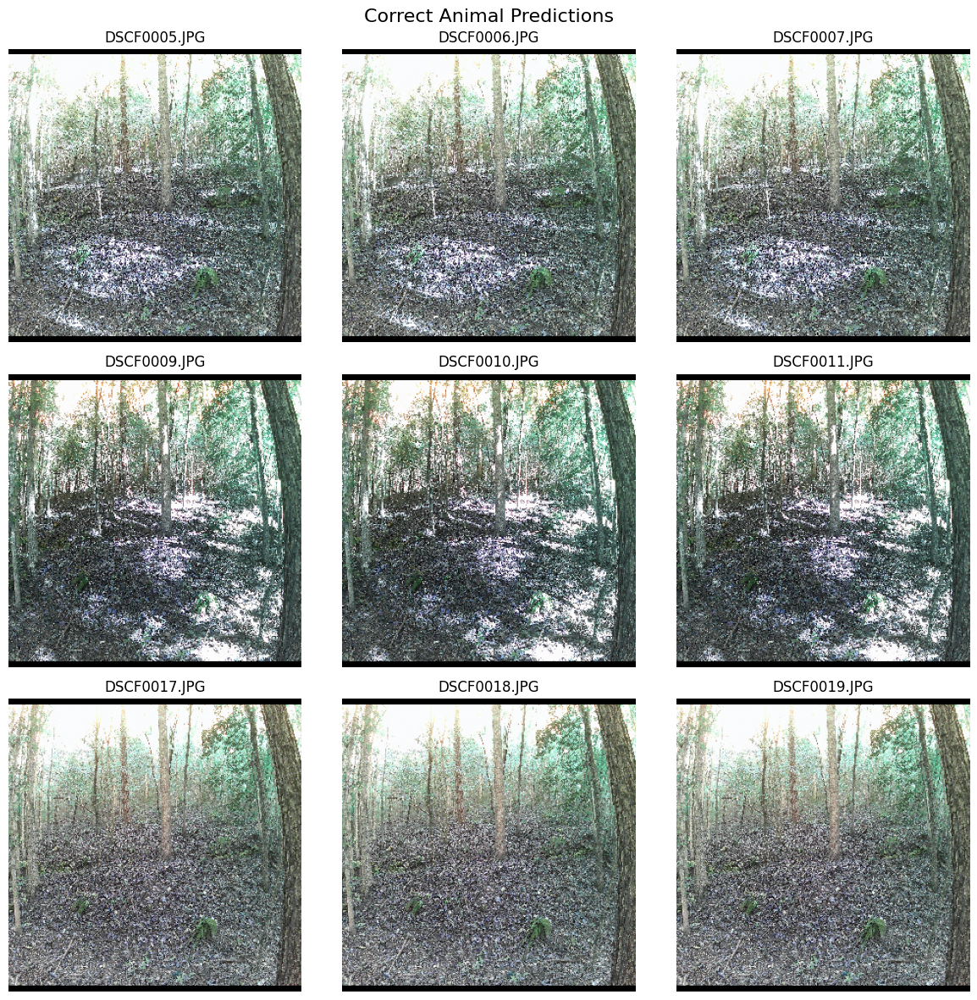

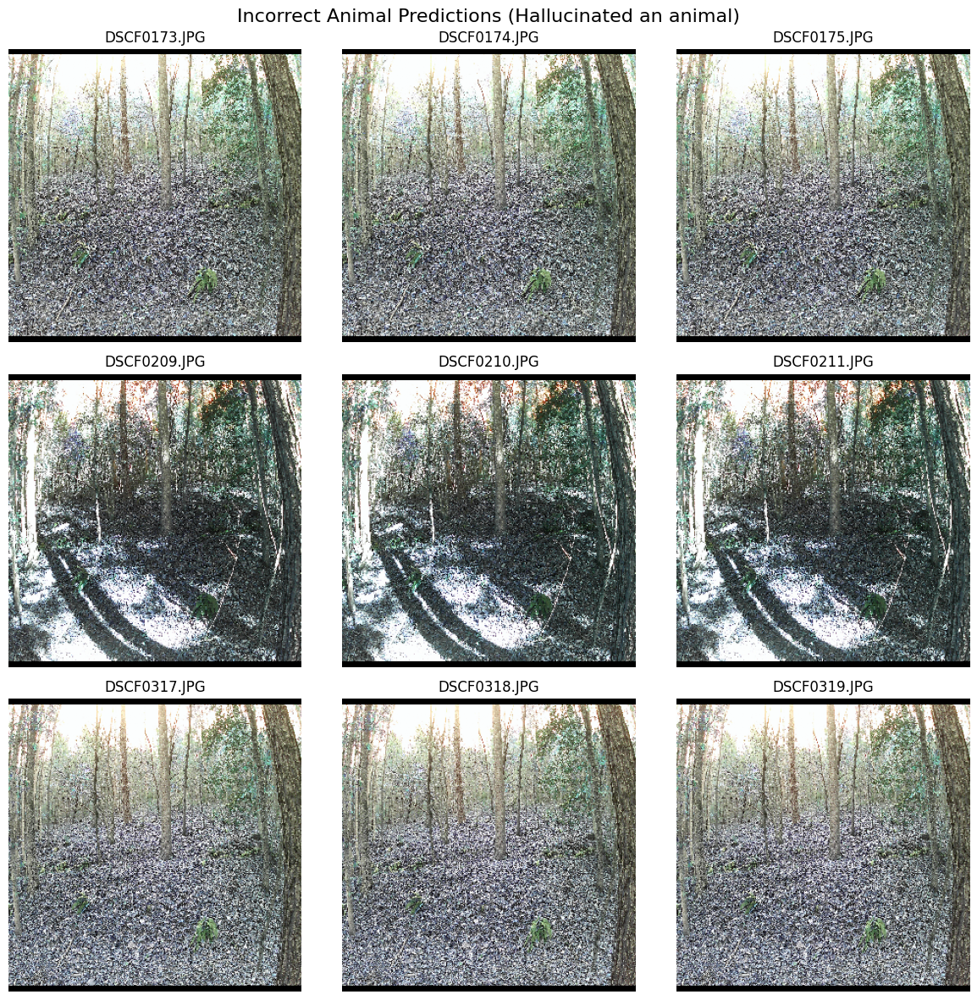

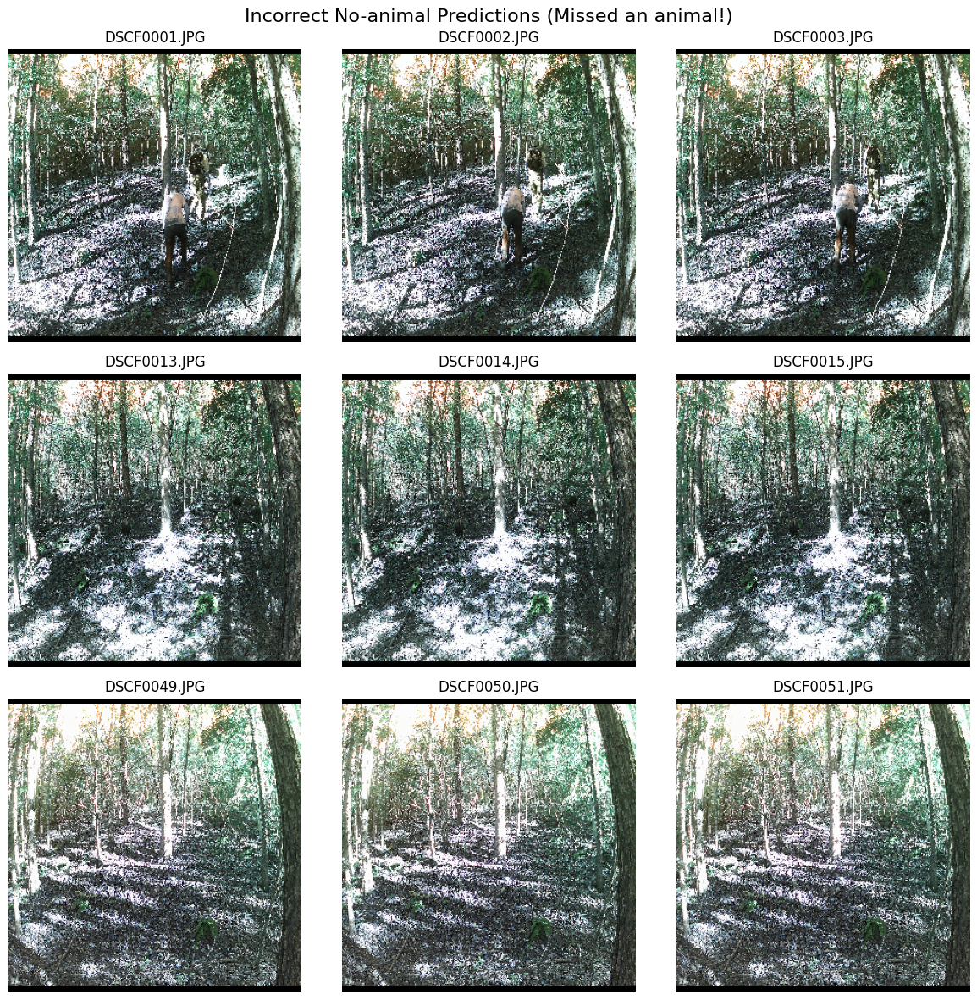

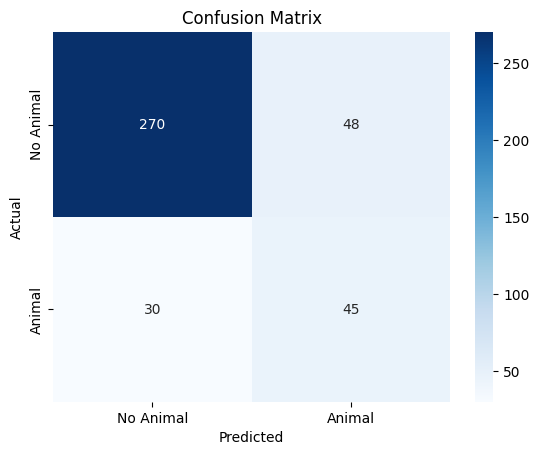

Evaluating model test set 2: /content/drive/MyDrive/Pics_to_evaluate/Dec2024CarmenGifts/241011-241202 SB Cliffs Gm Tr ...

Model Name: EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense
Training Parms: 
	 Patience = 10
	 Epochs = 100
	 Batch Size = 8
	 2025-02-06 11:58:36
Sanity checking inputs...
in_mem_prod_event_event_results len: 96
first event image count: 3
first file name count: 3
last event image count: 3
last file name count: 3
sample pred class values: No_Animal
sample file name values: ['DSCF0457.JPG', 'DSCF0458.JPG', 'DSCF0459.JPG']
test_data sample: ['DSCF0345.JPG', 'Animal', 0.5230971574783325]['DSCF0346.JPG', 'Animal', 0.5230971574783325]['DSCF0347.JPG', 'Animal', 0.5230971574783325]
test_data len: 288
truth_table len: 288
in_mem_prod_event_results len: 96
Calculating metrics...
actual_classes len: 288
actual_classes: ['Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 'Animal', 

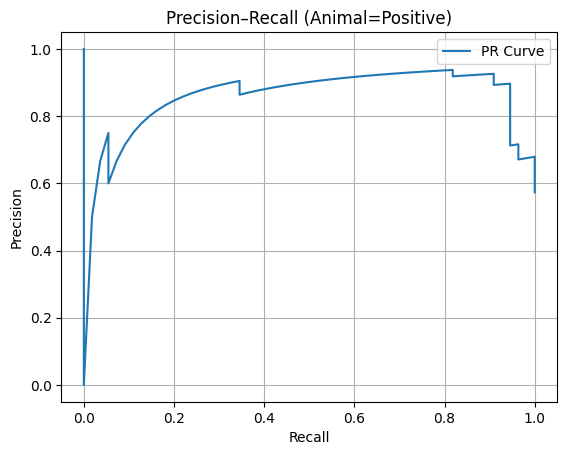

Chosen threshold = 0.1532420814037323, recall=0.9636363636363636, precision=0.7162162162162162
New metrics at threshold: 0.1532420814037323 Acc: 0.7604166666666666 Prec: 0.7162162162162162 Recall: 0.9636363636363636 F1: 0.8217054263565892
Done...Returning results.
Visualizing model strengths and weaknesses on prod data
correct_animal_predictions size: 9
incorrect_no_animal_predictions size: 9
incorrect_animal_predictions size: 4
Performance Stats for /content/drive/MyDrive/Pics_to_evaluate/Dec2024CarmenGifts/241011-241202 SB Cliffs Gm Tr :
	 Accuracy (correct predictions): 0.8645833333333334
	 Precision: (correct animal preds)0.92
	 Recall: (% of tot animals correctly detected)0.8363636363636363
	 F1 (avoidance of false pos & false neg 0-1, 1 is best): 0.8761904761904762


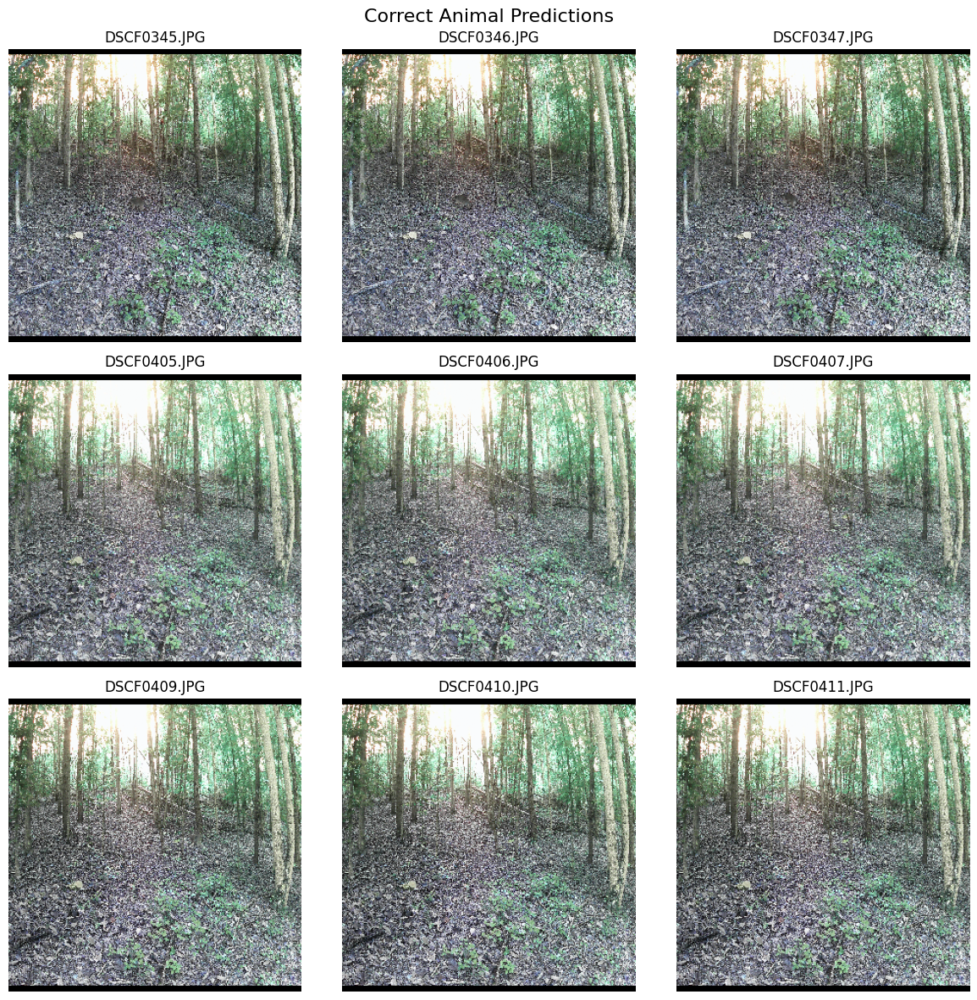

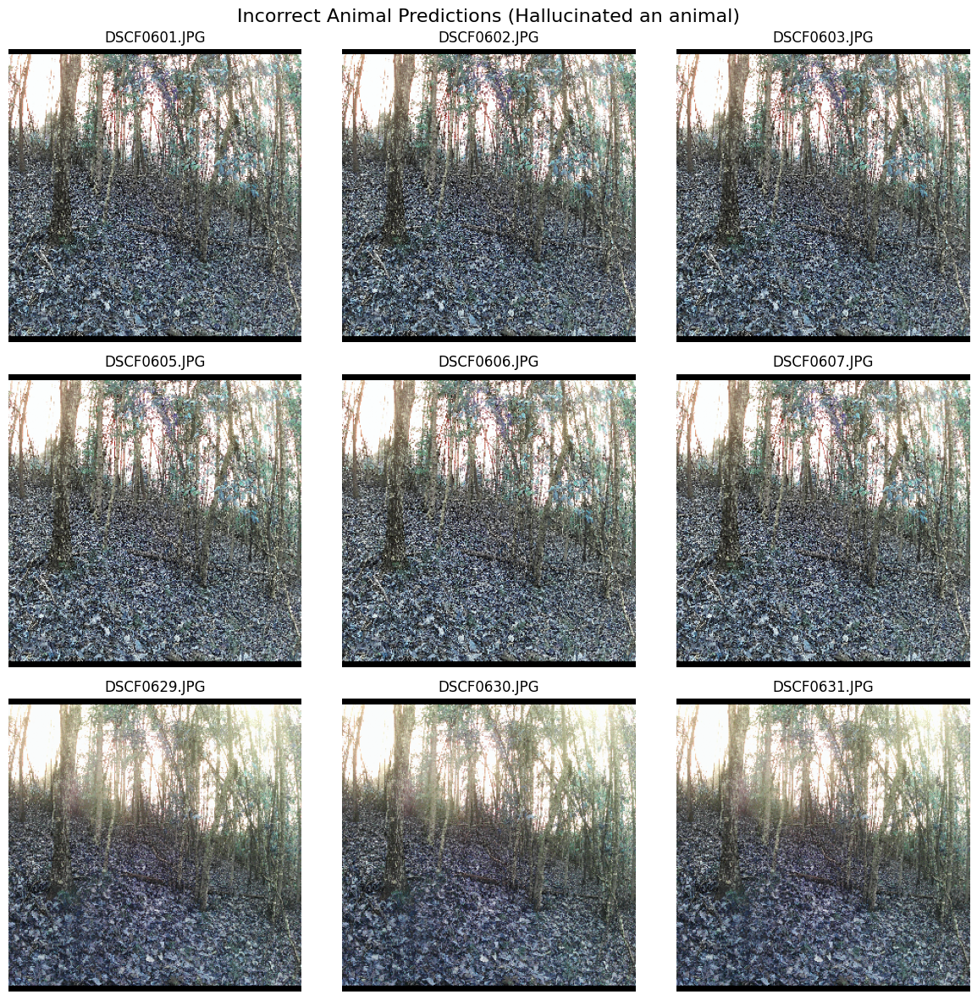

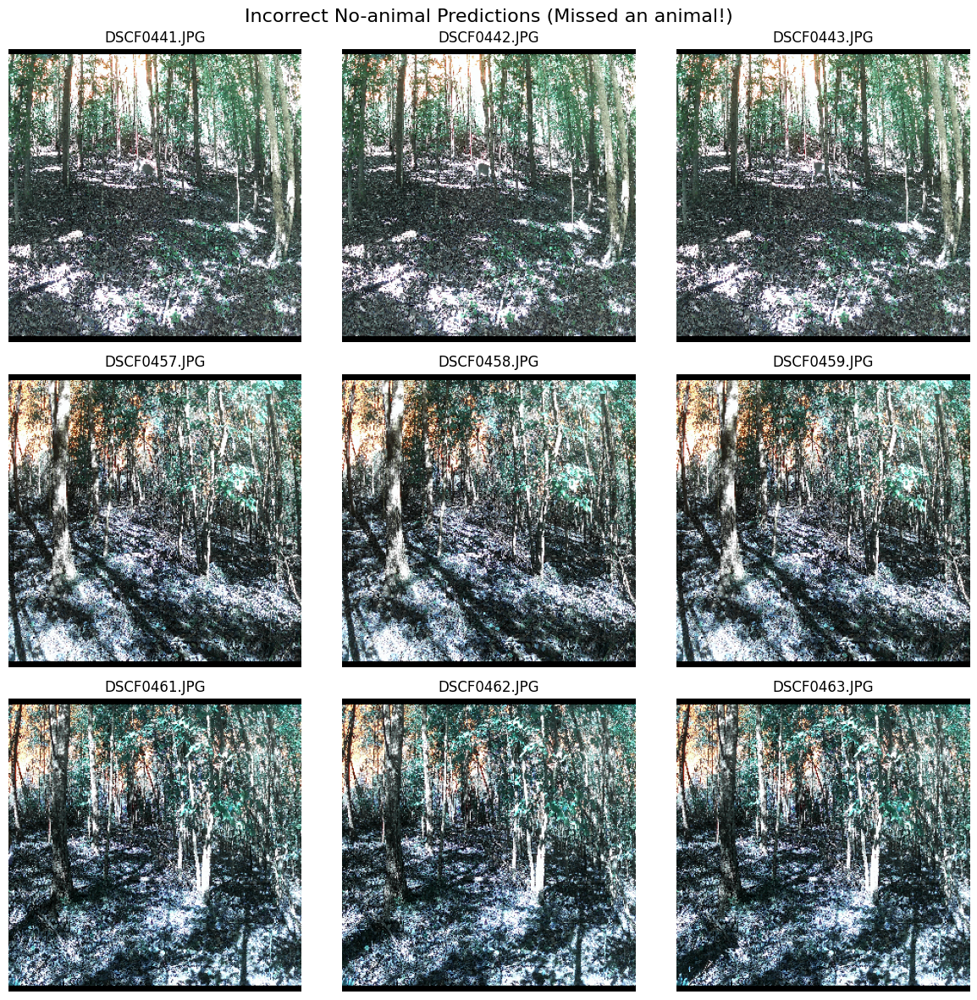

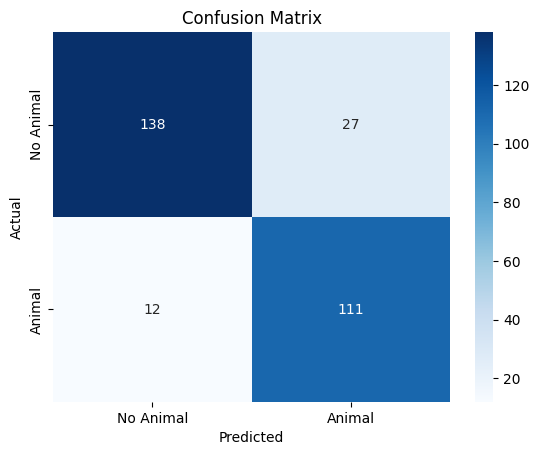

Combined calibration data size: 227
2025-02-06 13:02:11


261802

In [ ]:
#Prod data eval
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.metrics import precision_recall_curve
from sklearn.linear_model import LogisticRegression

#Collection of production predictions to aide in model output calibration
calib_scores = []  # raw confidences
calib_labels = []  # 0/1 ground truth

# Hardcoded truth table
# Current as of 120924 using Dec 2024 Carmen Gifts
East_End_truth_table = {
    'DSCF0001.JPG': 'Animal',
    'DSCF0002.JPG': 'Animal',
    'DSCF0003.JPG': 'Animal',
    'DSCF0005.JPG': 'Animal',
    'DSCF0006.JPG': 'Animal',
    'DSCF0007.JPG': 'Animal',
    'DSCF0009.JPG': 'Animal',
    'DSCF0010.JPG': 'Animal',
    'DSCF0011.JPG': 'Animal',
    'DSCF0013.JPG': 'Animal',
    'DSCF0014.JPG': 'Animal',
    'DSCF0015.JPG': 'Animal',
    'DSCF0017.JPG': 'Animal',
    'DSCF0018.JPG': 'Animal',
    'DSCF0019.JPG': 'Animal',
    'DSCF0021.JPG': 'Animal',
    'DSCF0022.JPG': 'Animal',
    'DSCF0023.JPG': 'Animal',
    'DSCF0025.JPG': 'Animal',
    'DSCF0026.JPG': 'Animal',
    'DSCF0027.JPG': 'Animal',
    'DSCF0029.JPG': 'Animal',
    'DSCF0030.JPG': 'Animal',
    'DSCF0031.JPG': 'Animal',
    'DSCF0033.JPG': 'Animal',
    'DSCF0034.JPG': 'Animal',
    'DSCF0035.JPG': 'Animal',
    'DSCF0037.JPG': 'Animal',
    'DSCF0038.JPG': 'Animal',
    'DSCF0039.JPG': 'Animal',
    'DSCF0041.JPG': 'Animal',
    'DSCF0042.JPG': 'Animal',
    'DSCF0043.JPG': 'Animal',
    'DSCF0045.JPG': 'Animal',
    'DSCF0046.JPG': 'Animal',
    'DSCF0047.JPG': 'Animal',
    'DSCF0049.JPG': 'Animal',
    'DSCF0050.JPG': 'Animal',
    'DSCF0051.JPG': 'Animal',
    'DSCF0053.JPG': 'Animal',
    'DSCF0054.JPG': 'Animal',
    'DSCF0055.JPG': 'Animal',
    'DSCF0057.JPG': 'Animal',
    'DSCF0058.JPG': 'Animal',
    'DSCF0059.JPG': 'Animal',
    'DSCF0061.JPG': 'Animal',
    'DSCF0062.JPG': 'Animal',
    'DSCF0063.JPG': 'Animal',
    'DSCF0065.JPG': 'Animal',
    'DSCF0066.JPG': 'Animal',
    'DSCF0067.JPG': 'Animal',
    'DSCF0069.JPG': 'Animal',
    'DSCF0070.JPG': 'Animal',
    'DSCF0071.JPG': 'Animal',
    'DSCF0073.JPG': 'Animal',
    'DSCF0074.JPG': 'Animal',
    'DSCF0075.JPG': 'Animal',
    'DSCF0077.JPG': 'Animal',
    'DSCF0078.JPG': 'Animal',
    'DSCF0079.JPG': 'Animal',
    'DSCF0081.JPG': 'Animal',
    'DSCF0082.JPG': 'Animal',
    'DSCF0083.JPG': 'Animal',
    'DSCF0085.JPG': 'Animal',
    'DSCF0086.JPG': 'Animal',
    'DSCF0087.JPG': 'Animal',
    'DSCF0089.JPG': 'Animal',
    'DSCF0090.JPG': 'Animal',
    'DSCF0091.JPG': 'Animal',
    'DSCF0093.JPG': 'Animal',
    'DSCF0094.JPG': 'Animal',
    'DSCF0095.JPG': 'Animal',
    'DSCF0097.JPG': 'Animal',
    'DSCF0098.JPG': 'Animal',
    'DSCF0099.JPG': 'Animal',
    'DSCF0101.JPG': 'Animal',
    'DSCF0102.JPG': 'Animal',
    'DSCF0103.JPG': 'Animal',
    'DSCF0105.JPG': 'Animal',
    'DSCF0106.JPG': 'Animal',
    'DSCF0107.JPG': 'Animal',
    'DSCF0109.JPG': 'Animal',
    'DSCF0110.JPG': 'Animal',
    'DSCF0111.JPG': 'Animal',
    'DSCF0113.JPG': 'Animal',
    'DSCF0114.JPG': 'Animal',
    'DSCF0115.JPG': 'Animal',
    'DSCF0117.JPG': 'Animal',
    'DSCF0118.JPG': 'Animal',
    'DSCF0119.JPG': 'Animal',
    'DSCF0121.JPG': 'Animal',
    'DSCF0122.JPG': 'Animal',
    'DSCF0123.JPG': 'Animal',
    'DSCF0125.JPG': 'Animal',
    'DSCF0126.JPG': 'Animal',
    'DSCF0127.JPG': 'Animal',
    'DSCF0129.JPG': 'Animal',
    'DSCF0130.JPG': 'Animal',
    'DSCF0131.JPG': 'Animal',
    'DSCF0133.JPG': 'Animal',
    'DSCF0134.JPG': 'Animal',
    'DSCF0135.JPG': 'Animal',
    'DSCF0137.JPG': 'Animal',
    'DSCF0138.JPG': 'Animal',
    'DSCF0139.JPG': 'Animal',
    'DSCF0141.JPG': 'Animal',
    'DSCF0142.JPG': 'Animal',
    'DSCF0143.JPG': 'Animal',
    'DSCF0145.JPG': 'Animal',
    'DSCF0146.JPG': 'Animal',
    'DSCF0147.JPG': 'Animal',
    'DSCF0149.JPG': 'Animal',
    'DSCF0150.JPG': 'Animal',
    'DSCF0151.JPG': 'Animal',
    'DSCF0153.JPG': 'Animal',
    'DSCF0154.JPG': 'Animal',
    'DSCF0155.JPG': 'Animal',
    'DSCF0157.JPG': 'Animal',
    'DSCF0158.JPG': 'Animal',
    'DSCF0159.JPG': 'Animal',
    'DSCF0161.JPG': 'Animal',
    'DSCF0162.JPG': 'Animal',
    'DSCF0163.JPG': 'Animal',
    'DSCF0165.JPG': 'Animal',
    'DSCF0166.JPG': 'Animal',
    'DSCF0167.JPG': 'Animal',
    'DSCF0169.JPG': 'Animal',
    'DSCF0170.JPG': 'Animal',
    'DSCF0171.JPG': 'Animal',
    'DSCF0173.JPG': 'No_Animal',
    'DSCF0174.JPG': 'No_Animal',
    'DSCF0175.JPG': 'No_Animal',
    'DSCF0177.JPG': 'Animal',
    'DSCF0178.JPG': 'Animal',
    'DSCF0179.JPG': 'Animal',
    'DSCF0181.JPG': 'Animal',
    'DSCF0182.JPG': 'Animal',
    'DSCF0183.JPG': 'Animal',
    'DSCF0185.JPG': 'Animal',
    'DSCF0186.JPG': 'Animal',
    'DSCF0187.JPG': 'Animal',
    'DSCF0189.JPG': 'Animal',
    'DSCF0190.JPG': 'Animal',
    'DSCF0191.JPG': 'Animal',
    'DSCF0193.JPG': 'Animal',
    'DSCF0194.JPG': 'Animal',
    'DSCF0195.JPG': 'Animal',
    'DSCF0197.JPG': 'Animal',
    'DSCF0198.JPG': 'Animal',
    'DSCF0199.JPG': 'Animal',
    'DSCF0201.JPG': 'Animal',
    'DSCF0202.JPG': 'Animal',
    'DSCF0203.JPG': 'Animal',
    'DSCF0205.JPG': 'Animal',
    'DSCF0206.JPG': 'Animal',
    'DSCF0207.JPG': 'Animal',
    'DSCF0209.JPG': 'No_Animal',
    'DSCF0210.JPG': 'No_Animal',
    'DSCF0211.JPG': 'No_Animal',
    'DSCF0213.JPG': 'No_Animal',
    'DSCF0214.JPG': 'No_Animal',
    'DSCF0215.JPG': 'No_Animal',
    'DSCF0217.JPG': 'No_Animal',
    'DSCF0218.JPG': 'No_Animal',
    'DSCF0219.JPG': 'No_Animal',
    'DSCF0221.JPG': 'No_Animal',
    'DSCF0222.JPG': 'No_Animal',
    'DSCF0223.JPG': 'No_Animal',
    'DSCF0225.JPG': 'Animal',
    'DSCF0226.JPG': 'Animal',
    'DSCF0227.JPG': 'Animal',
    'DSCF0229.JPG': 'Animal',
    'DSCF0230.JPG': 'Animal',
    'DSCF0231.JPG': 'Animal',
    'DSCF0233.JPG': 'Animal',
    'DSCF0234.JPG': 'Animal',
    'DSCF0235.JPG': 'Animal',
    'DSCF0237.JPG': 'Animal',
    'DSCF0238.JPG': 'Animal',
    'DSCF0239.JPG': 'Animal',
    'DSCF0241.JPG': 'Animal',
    'DSCF0242.JPG': 'Animal',
    'DSCF0243.JPG': 'Animal',
    'DSCF0245.JPG': 'Animal',
    'DSCF0246.JPG': 'Animal',
    'DSCF0247.JPG': 'Animal',
    'DSCF0249.JPG': 'Animal',
    'DSCF0250.JPG': 'Animal',
    'DSCF0251.JPG': 'Animal',
    'DSCF0253.JPG': 'Animal',
    'DSCF0254.JPG': 'Animal',
    'DSCF0255.JPG': 'Animal',
    'DSCF0257.JPG': 'Animal',
    'DSCF0258.JPG': 'Animal',
    'DSCF0259.JPG': 'Animal',
    'DSCF0261.JPG': 'No_Animal',
    'DSCF0262.JPG': 'No_Animal',
    'DSCF0263.JPG': 'No_Animal',
    'DSCF0265.JPG': 'Animal',
    'DSCF0266.JPG': 'Animal',
    'DSCF0267.JPG': 'Animal',
    'DSCF0269.JPG': 'Animal',
    'DSCF0270.JPG': 'Animal',
    'DSCF0271.JPG': 'Animal',
    'DSCF0273.JPG': 'Animal',
    'DSCF0274.JPG': 'Animal',
    'DSCF0275.JPG': 'Animal',
    'DSCF0277.JPG': 'Animal',
    'DSCF0278.JPG': 'Animal',
    'DSCF0279.JPG': 'Animal',
    'DSCF0281.JPG': 'Animal',
    'DSCF0282.JPG': 'Animal',
    'DSCF0283.JPG': 'Animal',
    'DSCF0285.JPG': 'No_Animal',
    'DSCF0286.JPG': 'No_Animal',
    'DSCF0287.JPG': 'No_Animal',
    'DSCF0289.JPG': 'Animal',
    'DSCF0290.JPG': 'Animal',
    'DSCF0291.JPG': 'Animal',
    'DSCF0293.JPG': 'Animal',
    'DSCF0294.JPG': 'Animal',
    'DSCF0295.JPG': 'Animal',
    'DSCF0297.JPG': 'Animal',
    'DSCF0298.JPG': 'Animal',
    'DSCF0299.JPG': 'Animal',
    'DSCF0301.JPG': 'Animal',
    'DSCF0302.JPG': 'Animal',
    'DSCF0303.JPG': 'Animal',
    'DSCF0305.JPG': 'No_Animal',
    'DSCF0306.JPG': 'No_Animal',
    'DSCF0307.JPG': 'No_Animal',
    'DSCF0309.JPG': 'Animal',
    'DSCF0310.JPG': 'Animal',
    'DSCF0311.JPG': 'Animal',
    'DSCF0313.JPG': 'Animal',
    'DSCF0314.JPG': 'Animal',
    'DSCF0315.JPG': 'Animal',
    'DSCF0317.JPG': 'No_Animal',
    'DSCF0318.JPG': 'No_Animal',
    'DSCF0319.JPG': 'No_Animal',
    'DSCF0321.JPG': 'Animal',
    'DSCF0322.JPG': 'Animal',
    'DSCF0323.JPG': 'Animal',
    'DSCF0325.JPG': 'Animal',
    'DSCF0326.JPG': 'Animal',
    'DSCF0327.JPG': 'Animal',
    'DSCF0329.JPG': 'Animal',
    'DSCF0330.JPG': 'Animal',
    'DSCF0331.JPG': 'Animal',
    'DSCF0333.JPG': 'Animal',
    'DSCF0334.JPG': 'Animal',
    'DSCF0335.JPG': 'Animal',
    'DSCF0337.JPG': 'Animal',
    'DSCF0338.JPG': 'Animal',
    'DSCF0339.JPG': 'Animal',
    'DSCF0341.JPG': 'Animal',
    'DSCF0342.JPG': 'Animal',
    'DSCF0343.JPG': 'Animal',
    'DSCF0345.JPG': 'Animal',
    'DSCF0346.JPG': 'Animal',
    'DSCF0347.JPG': 'Animal',
    'DSCF0349.JPG': 'Animal',
    'DSCF0350.JPG': 'Animal',
    'DSCF0351.JPG': 'Animal',
    'DSCF0353.JPG': 'Animal',
    'DSCF0354.JPG': 'Animal',
    'DSCF0355.JPG': 'Animal',
    'DSCF0357.JPG': 'Animal',
    'DSCF0358.JPG': 'Animal',
    'DSCF0359.JPG': 'Animal',
    'DSCF0361.JPG': 'Animal',
    'DSCF0362.JPG': 'Animal',
    'DSCF0363.JPG': 'Animal',
    'DSCF0365.JPG': 'Animal',
    'DSCF0366.JPG': 'Animal',
    'DSCF0367.JPG': 'Animal',
    'DSCF0369.JPG': 'Animal',
    'DSCF0370.JPG': 'Animal',
    'DSCF0371.JPG': 'Animal',
    'DSCF0373.JPG': 'Animal',
    'DSCF0374.JPG': 'Animal',
    'DSCF0375.JPG': 'Animal',
    'DSCF0377.JPG': 'Animal',
    'DSCF0378.JPG': 'Animal',
    'DSCF0379.JPG': 'Animal',
    'DSCF0381.JPG': 'No_Animal',
    'DSCF0382.JPG': 'No_Animal',
    'DSCF0383.JPG': 'No_Animal',
    'DSCF0385.JPG': 'No_Animal',
    'DSCF0386.JPG': 'No_Animal',
    'DSCF0387.JPG': 'No_Animal',
    'DSCF0389.JPG': 'No_Animal',
    'DSCF0390.JPG': 'No_Animal',
    'DSCF0391.JPG': 'No_Animal',
    'DSCF0393.JPG': 'Animal',
    'DSCF0394.JPG': 'Animal',
    'DSCF0395.JPG': 'Animal',
    'DSCF0397.JPG': 'Animal',
    'DSCF0398.JPG': 'Animal',
    'DSCF0399.JPG': 'Animal',
    'DSCF0401.JPG': 'Animal',
    'DSCF0402.JPG': 'Animal',
    'DSCF0403.JPG': 'Animal',
    'DSCF0405.JPG': 'Animal',
    'DSCF0406.JPG': 'Animal',
    'DSCF0407.JPG': 'Animal',
    'DSCF0409.JPG': 'Animal',
    'DSCF0410.JPG': 'Animal',
    'DSCF0411.JPG': 'Animal',
    'DSCF0413.JPG': 'Animal',
    'DSCF0414.JPG': 'Animal',
    'DSCF0415.JPG': 'Animal',
    'DSCF0417.JPG': 'Animal',
    'DSCF0418.JPG': 'Animal',
    'DSCF0419.JPG': 'Animal',
    'DSCF0421.JPG': 'Animal',
    'DSCF0422.JPG': 'Animal',
    'DSCF0423.JPG': 'Animal',
    'DSCF0425.JPG': 'Animal',
    'DSCF0426.JPG': 'Animal',
    'DSCF0427.JPG': 'Animal',
    'DSCF0429.JPG': 'Animal',
    'DSCF0430.JPG': 'Animal',
    'DSCF0431.JPG': 'Animal',
    'DSCF0433.JPG': 'Animal',
    'DSCF0434.JPG': 'Animal',
    'DSCF0435.JPG': 'Animal',
    'DSCF0437.JPG': 'Animal',
    'DSCF0438.JPG': 'Animal',
    'DSCF0439.JPG': 'Animal',
    'DSCF0441.JPG': 'Animal',
    'DSCF0442.JPG': 'Animal',
    'DSCF0443.JPG': 'Animal',
    'DSCF0445.JPG': 'Animal',
    'DSCF0446.JPG': 'Animal',
    'DSCF0447.JPG': 'Animal',
    'DSCF0449.JPG': 'Animal',
    'DSCF0450.JPG': 'Animal',
    'DSCF0451.JPG': 'Animal',
    'DSCF0453.JPG': 'Animal',
    'DSCF0454.JPG': 'Animal',
    'DSCF0455.JPG': 'Animal',
    'DSCF0457.JPG': 'Animal',
    'DSCF0458.JPG': 'Animal',
    'DSCF0459.JPG': 'Animal',
    'DSCF0461.JPG': 'Animal',
    'DSCF0462.JPG': 'Animal',
    'DSCF0463.JPG': 'Animal',
    'DSCF0465.JPG': 'Animal',
    'DSCF0466.JPG': 'Animal',
    'DSCF0467.JPG': 'Animal',
    'DSCF0469.JPG': 'Animal',
    'DSCF0470.JPG': 'Animal',
    'DSCF0471.JPG': 'Animal',
    'DSCF0473.JPG': 'No_Animal',
    'DSCF0474.JPG': 'No_Animal',
    'DSCF0475.JPG': 'No_Animal',
    'DSCF0477.JPG': 'No_Animal',
    'DSCF0478.JPG': 'No_Animal',
    'DSCF0479.JPG': 'No_Animal',
    'DSCF0481.JPG': 'No_Animal',
    'DSCF0482.JPG': 'No_Animal',
    'DSCF0483.JPG': 'No_Animal',
    'DSCF0485.JPG': 'No_Animal',
    'DSCF0486.JPG': 'No_Animal',
    'DSCF0487.JPG': 'No_Animal',
    'DSCF0489.JPG': 'No_Animal',
    'DSCF0490.JPG': 'No_Animal',
    'DSCF0491.JPG': 'No_Animal',
    'DSCF0493.JPG': 'No_Animal',
    'DSCF0494.JPG': 'No_Animal',
    'DSCF0495.JPG': 'No_Animal',
    'DSCF0497.JPG': 'No_Animal',
    'DSCF0498.JPG': 'No_Animal',
    'DSCF0499.JPG': 'No_Animal',
    'DSCF0501.JPG': 'No_Animal',
    'DSCF0502.JPG': 'No_Animal',
    'DSCF0503.JPG': 'No_Animal',
    'DSCF0505.JPG': 'No_Animal',
    'DSCF0506.JPG': 'No_Animal',
    'DSCF0507.JPG': 'No_Animal',
    'DSCF0509.JPG': 'No_Animal',
    'DSCF0510.JPG': 'No_Animal',
    'DSCF0511.JPG': 'No_Animal',
    'DSCF0513.JPG': 'No_Animal',
    'DSCF0514.JPG': 'No_Animal',
    'DSCF0515.JPG': 'No_Animal',
    'DSCF0517.JPG': 'No_Animal',
    'DSCF0518.JPG': 'No_Animal',
    'DSCF0519.JPG': 'No_Animal',
    'DSCF0521.JPG': 'No_Animal',
    'DSCF0522.JPG': 'No_Animal',
    'DSCF0523.JPG': 'No_Animal'
}

SB_truth_table = data_dict = {
    "DSCF0345.JPG": "Animal",
    "DSCF0346.JPG": "Animal",
    "DSCF0347.JPG": "Animal",
    "DSCF0405.JPG": "Animal",
    "DSCF0406.JPG": "Animal",
    "DSCF0407.JPG": "Animal",
    "DSCF0409.JPG": "Animal",
    "DSCF0410.JPG": "Animal",
    "DSCF0411.JPG": "Animal",
    "DSCF0417.JPG": "Animal",
    "DSCF0418.JPG": "Animal",
    "DSCF0419.JPG": "Animal",
    "DSCF0421.JPG": "Animal",
    "DSCF0422.JPG": "Animal",
    "DSCF0423.JPG": "Animal",
    "DSCF0425.JPG": "No_Animal",
    "DSCF0426.JPG": "No_Animal",
    "DSCF0427.JPG": "No_Animal",
    "DSCF0429.JPG": "Animal",
    "DSCF0430.JPG": "Animal",
    "DSCF0431.JPG": "Animal",
    "DSCF0433.JPG": "Animal",
    "DSCF0434.JPG": "Animal",
    "DSCF0435.JPG": "Animal",
    "DSCF0437.JPG": "Animal",
    "DSCF0438.JPG": "Animal",
    "DSCF0439.JPG": "Animal",
    "DSCF0441.JPG": "Animal",
    "DSCF0442.JPG": "Animal",
    "DSCF0443.JPG": "Animal",
    "DSCF0449.JPG": "Animal",
    "DSCF0450.JPG": "Animal",
    "DSCF0451.JPG": "Animal",
    "DSCF0453.JPG": "No_Animal",
    "DSCF0454.JPG": "No_Animal",
    "DSCF0455.JPG": "No_Animal",
    "DSCF0457.JPG": "Animal",
    "DSCF0458.JPG": "Animal",
    "DSCF0459.JPG": "Animal",
    "DSCF0461.JPG": "Animal",
    "DSCF0462.JPG": "Animal",
    "DSCF0463.JPG": "Animal",
    "DSCF0465.JPG": "Animal",
    "DSCF0466.JPG": "Animal",
    "DSCF0467.JPG": "Animal",
    "DSCF0469.JPG": "Animal",
    "DSCF0470.JPG": "Animal",
    "DSCF0471.JPG": "Animal",
    "DSCF0473.JPG": "Animal",
    "DSCF0474.JPG": "Animal",
    "DSCF0475.JPG": "Animal",
    "DSCF0477.JPG": "Animal",
    "DSCF0478.JPG": "Animal",
    "DSCF0479.JPG": "Animal",
    "DSCF0481.JPG": "Animal",
    "DSCF0482.JPG": "Animal",
    "DSCF0483.JPG": "Animal",
    "DSCF0485.JPG": "Animal",
    "DSCF0486.JPG": "Animal",
    "DSCF0487.JPG": "Animal",
    "DSCF0489.JPG": "No_Animal",
    "DSCF0490.JPG": "No_Animal",
    "DSCF0491.JPG": "No_Animal",
    "DSCF0493.JPG": "No_Animal",
    "DSCF0494.JPG": "No_Animal",
    "DSCF0495.JPG": "No_Animal",
    "DSCF0497.JPG": "No_Animal",
    "DSCF0498.JPG": "No_Animal",
    "DSCF0499.JPG": "No_Animal",
    "DSCF0501.JPG": "Animal",
    "DSCF0502.JPG": "Animal",
    "DSCF0503.JPG": "Animal",
    "DSCF0505.JPG": "Animal",
    "DSCF0506.JPG": "Animal",
    "DSCF0507.JPG": "Animal",
    "DSCF0509.JPG": "Animal",
    "DSCF0510.JPG": "Animal",
    "DSCF0511.JPG": "Animal",
    "DSCF0513.JPG": "Animal",
    "DSCF0514.JPG": "Animal",
    "DSCF0515.JPG": "Animal",
    "DSCF0517.JPG": "Animal",
    "DSCF0518.JPG": "Animal",
    "DSCF0519.JPG": "Animal",
    "DSCF0521.JPG": "Animal",
    "DSCF0522.JPG": "Animal",
    "DSCF0523.JPG": "Animal",
    "DSCF0525.JPG": "Animal",
    "DSCF0526.JPG": "Animal",
    "DSCF0527.JPG": "Animal",
    "DSCF0529.JPG": "No_Animal",
    "DSCF0530.JPG": "No_Animal",
    "DSCF0531.JPG": "No_Animal",
    "DSCF0533.JPG": "No_Animal",
    "DSCF0534.JPG": "No_Animal",
    "DSCF0535.JPG": "No_Animal",
    "DSCF0537.JPG": "No_Animal",
    "DSCF0538.JPG": "No_Animal",
    "DSCF0539.JPG": "No_Animal",
    "DSCF0541.JPG": "No_Animal",
    "DSCF0542.JPG": "No_Animal",
    "DSCF0543.JPG": "No_Animal",
    "DSCF0545.JPG": "No_Animal",
    "DSCF0546.JPG": "No_Animal",
    "DSCF0547.JPG": "No_Animal",
    "DSCF0549.JPG": "No_Animal",
    "DSCF0550.JPG": "No_Animal",
    "DSCF0551.JPG": "No_Animal",
    "DSCF0553.JPG": "No_Animal",
    "DSCF0554.JPG": "No_Animal",
    "DSCF0555.JPG": "No_Animal",
    "DSCF0557.JPG": "Animal",
    "DSCF0558.JPG": "Animal",
    "DSCF0559.JPG": "Animal",
    "DSCF0561.JPG": "Animal",
    "DSCF0562.JPG": "Animal",
    "DSCF0563.JPG": "Animal",
    "DSCF0565.JPG": "Animal",
    "DSCF0566.JPG": "Animal",
    "DSCF0567.JPG": "Animal",
    "DSCF0569.JPG": "Animal",
    "DSCF0570.JPG": "Animal",
    "DSCF0571.JPG": "Animal",
    "DSCF0573.JPG": "No_Animal",
    "DSCF0574.JPG": "No_Animal",
    "DSCF0575.JPG": "No_Animal",
    "DSCF0577.JPG": "No_Animal",
    "DSCF0578.JPG": "No_Animal",
    "DSCF0579.JPG": "No_Animal",
    "DSCF0581.JPG": "No_Animal",
    "DSCF0582.JPG": "No_Animal",
    "DSCF0583.JPG": "No_Animal",
    "DSCF0585.JPG": "No_Animal",
    "DSCF0586.JPG": "No_Animal",
    "DSCF0587.JPG": "No_Animal",
    "DSCF0589.JPG": "No_Animal",
    "DSCF0590.JPG": "No_Animal",
    "DSCF0591.JPG": "No_Animal",
    "DSCF0593.JPG": "Animal",
    "DSCF0594.JPG": "Animal",
    "DSCF0595.JPG": "Animal",
    "DSCF0597.JPG": "Animal",
    "DSCF0598.JPG": "Animal",
    "DSCF0599.JPG": "Animal",
    "DSCF0601.JPG": "No_Animal",
    "DSCF0602.JPG": "No_Animal",
    "DSCF0603.JPG": "No_Animal",
    "DSCF0605.JPG": "No_Animal",
    "DSCF0606.JPG": "No_Animal",
    "DSCF0607.JPG": "No_Animal",
    "DSCF0609.JPG": "No_Animal",
    "DSCF0610.JPG": "No_Animal",
    "DSCF0611.JPG": "No_Animal",
    "DSCF0613.JPG": "Animal",
    "DSCF0614.JPG": "Animal",
    "DSCF0615.JPG": "Animal",
    "DSCF0617.JPG": "Animal",
    "DSCF0618.JPG": "Animal",
    "DSCF0619.JPG": "Animal",
    "DSCF0621.JPG": "Animal",
    "DSCF0622.JPG": "Animal",
    "DSCF0623.JPG": "Animal",
    "DSCF0625.JPG": "Animal",
    "DSCF0626.JPG": "Animal",
    "DSCF0627.JPG": "Animal",
    "DSCF0629.JPG": "No_Animal",
    "DSCF0630.JPG": "No_Animal",
    "DSCF0631.JPG": "No_Animal",
    "DSCF0633.JPG": "No_Animal",
    "DSCF0634.JPG": "No_Animal",
    "DSCF0635.JPG": "No_Animal",
    "DSCF0637.JPG": "No_Animal",
    "DSCF0638.JPG": "No_Animal",
    "DSCF0639.JPG": "No_Animal",
    "DSCF0641.JPG": "No_Animal",
    "DSCF0642.JPG": "No_Animal",
    "DSCF0643.JPG": "No_Animal",
    "DSCF0645.JPG": "No_Animal",
    "DSCF0646.JPG": "No_Animal",
    "DSCF0647.JPG": "No_Animal",
    "DSCF0649.JPG": "Animal",
    "DSCF0650.JPG": "Animal",
    "DSCF0651.JPG": "Animal",
    "DSCF0653.JPG": "Animal",
    "DSCF0654.JPG": "Animal",
    "DSCF0655.JPG": "Animal",
    "DSCF0657.JPG": "Animal",
    "DSCF0658.JPG": "Animal",
    "DSCF0659.JPG": "Animal",
    "DSCF0661.JPG": "No_Animal",
    "DSCF0662.JPG": "No_Animal",
    "DSCF0663.JPG": "No_Animal",
    "DSCF0665.JPG": "No_Animal",
    "DSCF0666.JPG": "No_Animal",
    "DSCF0667.JPG": "No_Animal",
    "DSCF0669.JPG": "No_Animal",
    "DSCF0670.JPG": "No_Animal",
    "DSCF0671.JPG": "No_Animal",
    "DSCF0673.JPG": "No_Animal",
    "DSCF0674.JPG": "No_Animal",
    "DSCF0675.JPG": "No_Animal",
    "DSCF0677.JPG": "No_Animal",
    "DSCF0678.JPG": "No_Animal",
    "DSCF0679.JPG": "No_Animal",
    "DSCF0681.JPG": "No_Animal",
    "DSCF0682.JPG": "No_Animal",
    "DSCF0683.JPG": "No_Animal",
    "DSCF0685.JPG": "No_Animal",
    "DSCF0686.JPG": "No_Animal",
    "DSCF0687.JPG": "No_Animal",
    "DSCF0689.JPG": "No_Animal",
    "DSCF0690.JPG": "No_Animal",
    "DSCF0691.JPG": "No_Animal",
    "DSCF0693.JPG": "No_Animal",
    "DSCF0694.JPG": "No_Animal",
    "DSCF0695.JPG": "No_Animal",
    "DSCF0697.JPG": "Animal",
    "DSCF0698.JPG": "Animal",
    "DSCF0699.JPG": "Animal",
    "DSCF0701.JPG": "Animal",
    "DSCF0702.JPG": "Animal",
    "DSCF0703.JPG": "Animal",
    "DSCF0705.JPG": "Animal",
    "DSCF0706.JPG": "Animal",
    "DSCF0707.JPG": "Animal",
    "DSCF0709.JPG": "Animal",
    "DSCF0710.JPG": "Animal",
    "DSCF0711.JPG": "Animal",
    "DSCF0713.JPG": "Animal",
    "DSCF0714.JPG": "Animal",
    "DSCF0715.JPG": "Animal",
    "DSCF0717.JPG": "Animal",
    "DSCF0718.JPG": "Animal",
    "DSCF0719.JPG": "Animal",
    "DSCF0721.JPG": "Animal",
    "DSCF0722.JPG": "Animal",
    "DSCF0723.JPG": "Animal",
    "DSCF0725.JPG": "Animal",
    "DSCF0726.JPG": "Animal",
    "DSCF0727.JPG": "Animal",
    "DSCF0729.JPG": "Animal",
    "DSCF0730.JPG": "Animal",
    "DSCF0731.JPG": "Animal",
    "DSCF0733.JPG": "Animal",
    "DSCF0734.JPG": "Animal",
    "DSCF0735.JPG": "Animal",
    "DSCF0737.JPG": "Animal",
    "DSCF0738.JPG": "Animal",
    "DSCF0739.JPG": "Animal",
    "DSCF0741.JPG": "No_Animal",
    "DSCF0742.JPG": "No_Animal",
    "DSCF0743.JPG": "No_Animal",
    "DSCF0745.JPG": "No_Animal",
    "DSCF0746.JPG": "No_Animal",
    "DSCF0747.JPG": "No_Animal",
    "DSCF0749.JPG": "No_Animal",
    "DSCF0750.JPG": "No_Animal",
    "DSCF0751.JPG": "No_Animal",
    "DSCF0753.JPG": "No_Animal",
    "DSCF0754.JPG": "No_Animal",
    "DSCF0755.JPG": "No_Animal",
    "DSCF0757.JPG": "No_Animal",
    "DSCF0758.JPG": "No_Animal",
    "DSCF0759.JPG": "No_Animal",
    "DSCF0761.JPG": "No_Animal",
    "DSCF0762.JPG": "No_Animal",
    "DSCF0763.JPG": "No_Animal",
    "DSCF0765.JPG": "Animal",
    "DSCF0766.JPG": "Animal",
    "DSCF0767.JPG": "Animal",
    "DSCF0769.JPG": "Animal",
    "DSCF0770.JPG": "Animal",
    "DSCF0771.JPG": "Animal",
    #Part of orig dataset, but no sibling event images and seq#s before & after don't allow padding to work
    #So, removed and placed in training data/no animal
    #"DSCF0773.JPG": "No_Animal",
    "DSCF0774.JPG": "Animal",
    "DSCF0775.JPG": "Animal",
    "DSCF0776.JPG": "Animal",
    "DSCF0778.JPG": "Animal",
    "DSCF0779.JPG": "Animal",
    "DSCF0780.JPG": "Animal",
    "DSCF0782.JPG": "No_Animal",
    "DSCF0783.JPG": "No_Animal",
    "DSCF0784.JPG": "No_Animal",
    "DSCF0786.JPG": "Animal",
    "DSCF0787.JPG": "Animal",
    "DSCF0788.JPG": "Animal",
    "DSCF0790.JPG": "Animal",
    "DSCF0791.JPG": "Animal",
    "DSCF0792.JPG": "Animal"
}

def get_actual_class_for_SB(file_name):
  return SB_truth_table.get(file_name)
def get_actual_class_for_East_End(file_name):
  return East_End_truth_table.get(file_name)
def get_actual_class(truth_table, file_name):
  return truth_table.get(file_name)

def evaluate_model_outputs(test_data, truth_table, in_mem_prod_event_results):
    #Abomination mem struct constants
    #list_index points to 3 items
    EVENT_IMAGES=0 #all 3 event images
    PRED_CLASS=1
    FILE_NAMES=2 #all 3 file names corresonding to the images
    CONFIDENCE=3
    y_true = []
    y_scores = []

    """
    Evaluates the CNN model outputs against the hardcoded truth table.

    Parameters:
    SHOULD BE NA NOW: test_data (list of tuples): A list where each tuple contains (file name, predicted class, confidence level).
    truth_table (dict): A dictionary containing the ground truth labels for each file name.
    in_mem_prod_event_results (list of tuples): A list where each tuple contains (event images, predicted class, file names).

    Returns:
    dict: A dictionary containing evaluation metrics and lists of file names for different scenarios.
    """
    # Sanity checking inputs for matching length
    print("Sanity checking inputs...")
    print(f"in_mem_prod_event_event_results len: {len(in_mem_prod_event_results)}")
    print(f"first event image count: {len(in_mem_prod_event_results[0][EVENT_IMAGES])}")
    print(f"first file name count: {len(in_mem_prod_event_results[0][FILE_NAMES])}")
    print(f"last event image count: {len(in_mem_prod_event_results[-1][EVENT_IMAGES])}")
    print(f"last file name count: {len(in_mem_prod_event_results[-1][FILE_NAMES])}")
    print(f"sample pred class values: {in_mem_prod_event_results[12][PRED_CLASS]}")
    print(f"sample file name values: {in_mem_prod_event_results[12][FILE_NAMES]}")
    print(f"test_data sample: {test_data[0]}{test_data[1]}{test_data[2]}")
    print(f"test_data len: {len(test_data)}")
    print(f"truth_table len: {len(truth_table)}")
    print(f"in_mem_prod_event_results len: {len(in_mem_prod_event_results)}")
    assert len(test_data) == len(truth_table), "Test data and truth table must have the same length"

    # Extracting file names and predicted classes from test data
    test_file_names, predicted_classes = zip(*[(data[0], data[1]) for data in test_data])

    # Extracting actual classes from the truth table based on the test file names
    actual_classes = [truth_table.get(file) for file in test_file_names]

    # Calculating metrics
    print("Calculating metrics...")
    print(f"actual_classes len: {len(actual_classes)}")
    print(f"actual_classes: {actual_classes}")
    print(f"predicted_classes len: {len(predicted_classes)}")
    print(f"predicted_classes: {predicted_classes}")
    print("Calculating accuracy...")
    accuracy = accuracy_score(actual_classes, predicted_classes)
    print(accuracy)
    print("Calculating precision...")
    precision = precision_score(actual_classes, predicted_classes, pos_label='Animal', zero_division=0)
    print(precision)
    print("Calculating recall...")
    recall = recall_score(actual_classes, predicted_classes, pos_label='Animal', zero_division=0)
    print(recall)
    print("Calculating f1 score...")
    f1 = f1_score(actual_classes, predicted_classes, pos_label='Animal', zero_division=0)
    print(f1)
    print("Calculating confusion matrix...")
    conf_matrix = confusion_matrix(actual_classes, predicted_classes, labels=['Animal', 'No_Animal'])
    print(confusion_matrix)
    print("Identifying examples for visuals...")
    # Identifying images / file names for different scenarios
    correct_predictions = [in_mem_prod_event_results[i] for i in range(len(in_mem_prod_event_results)) if in_mem_prod_event_results[i][PRED_CLASS] == get_actual_class(truth_table, in_mem_prod_event_results[i][FILE_NAMES][0])]
    incorrect_animal = [in_mem_prod_event_results[i] for i in range(len(in_mem_prod_event_results)) if in_mem_prod_event_results[i][PRED_CLASS] == 'Animal' and get_actual_class(truth_table, in_mem_prod_event_results[i][FILE_NAMES][0]) != 'Animal']
    incorrect_no_animal = [in_mem_prod_event_results[i] for i in range(len(in_mem_prod_event_results)) if in_mem_prod_event_results[i][PRED_CLASS] == 'No_Animal' and get_actual_class(truth_table, in_mem_prod_event_results[i][FILE_NAMES][0]) != 'No_Animal']
    print("Pruning examples...")
    # Limiting the number of file names to 9 for each category
    correct_predictions = correct_predictions[:9]
    incorrect_animal = incorrect_animal[:9]
    incorrect_no_animal = incorrect_no_animal[:9]

    for event_item in in_mem_prod_event_results:
        files = event_item[FILE_NAMES]
        predicted_conf = event_item[CONFIDENCE]

        # We'll pick the "ground truth" from the first file or all 3 if they differ
        # but typically they should have the same truth.
        # We'll just use the first:
        file0 = files[0]
        actual_label = truth_table.get(file0, "No_Animal")  # default to "No_Animal" if not in table
        # Convert string to 0/1
        actual_num = 1 if actual_label == "Animal" else 0

        y_true.append(actual_num)
        y_scores.append(predicted_conf)

        calib_scores.append(predicted_conf)
        calib_labels.append(actual_num)

    # Now we have arrays y_true, y_scores
    #precision_vals, recall_vals, thresholds = precision_recall_curve(y_true, y_scores, pos_label=1)
    prec_array, recall_array, thresh_array = precision_recall_curve(y_true, y_scores, pos_label=1)
    # Now you can do:
    target_recall = 0.95
    valid_indices = [i for i in range(len(recall_array)) if recall_array[i] >= target_recall]
    # Plot:
    plt.figure()
    plt.plot(recall_array, prec_array, label="PR Curve")
    plt.xlabel("Recall")
    plt.ylabel("Precision")
    plt.title("Precision–Recall (Animal=Positive)")
    plt.grid(True)
    plt.legend()
    plt.show()
    target_recall = 0.95
    valid_indices = [i for i in range(len(recall_array)) if recall_array[i] >= target_recall]

    if len(valid_indices) > 0:
        # pick the highest threshold that still meets the recall requirement
        chosen_i = valid_indices[-1]
        chosen_threshold = thresh_array[chosen_i]
        chosen_precision = prec_array[chosen_i]
        chosen_recall = recall_array[chosen_i]

        print(f"Chosen threshold = {chosen_threshold}, recall={chosen_recall}, precision={chosen_precision}")
        y_new_pred = [1 if score >= chosen_threshold else 0 for score in y_scores]
        # Then re-check:
        new_acc = accuracy_score(y_true, y_new_pred)
        new_prec = precision_score(y_true, y_new_pred)
        new_rec = recall_score(y_true, y_new_pred)
        new_f1 = f1_score(y_true, y_new_pred)
        print(f"New metrics at threshold: {chosen_threshold} Acc: {new_acc} Prec: {new_prec} Recall: {new_rec} F1: {new_f1}")

    else:
        print("No threshold achieves the required recall of 0.95.")


    print("Done...Returning results.")
    return {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'confusion_matrix': conf_matrix.tolist(),
        'correct_predictions': correct_predictions,
        'incorrect_animal': incorrect_animal,
        'incorrect_no_animal': incorrect_no_animal
    }



#EXECUTION AREA
print("Model name: " + MODEL_NAME)
model = prod_models[0]
model.summary()
# Evaluate model performance on prod data for which we've captured truth tables/labels
# Review distributions
# Following/first two probably should be moved elsewhere
# print_label_distribution_numeric(labels, "Train labels")
# print_label_distribution_numeric(test_labels, "Test labels")
print_label_distribution_numeric(SB_truth_table.values(), "Prod SB_truth_table")
print_label_distribution_numeric(East_End_truth_table.values(), "Prod East_End_truth_table")


print("Beginning evaluation of model performance on prod data for which we have labels/truth tables...")
print(f"East End Truth Table len: {len(East_End_truth_table)}")
print(f"in_mem_prod_results1 len: {len(in_mem_prod_results1)}")
print(f"SB Truth Table len: {len(SB_truth_table)}")
print(f"in_mem_prod_results2 len: {len(in_mem_prod_results2)}")

print("Evaluating model test set 1: " +img_dir_path1+ " ...")

print_model_parms_for_reporting()
results1 = evaluate_model_outputs(in_mem_prod_results1, East_End_truth_table,in_mem_prod_event_results1)
visualize_strengths_and_weaknesses(results1, img_dir_path1, in_mem_prod_event_results1)

# prod_data = prod2
# prod_file_names = prodfiles2
print("Evaluating model test set 2: "+img_dir_path2+" ...")
print_model_parms_for_reporting()
results2 = evaluate_model_outputs(in_mem_prod_results2, SB_truth_table,in_mem_prod_event_results2)
visualize_strengths_and_weaknesses(results2, img_dir_path2,in_mem_prod_event_results2)

calib_scores = np.array(calib_scores)
calib_labels = np.array(calib_labels)

print(f"Combined calibration data size: {len(calib_scores)}")

output_datetimestamp()
prod_data = None
prod_file_names = None
gc.collect()

# """
# Performance Metrics Definitions:

# 1. Accuracy:
#    - Definition: The ratio of correctly predicted observations to the total observations.
#    - Formula: Accuracy = (True Positives + True Negatives) / (Total Observations)
#    - Interpretation: It indicates the overall correctness of the model and is more useful when the classes are balanced.

# 2. Precision:
#    - Definition: The ratio of correctly predicted positive observations to the total predicted positive observations.
#    - Formula: Precision = True Positives / (True Positives + False Positives)
#    - Interpretation: It indicates the proportion of positive identifications that were actually correct, used to minimize false positives.

# 3. Recall (Sensitivity):
#    - Definition: The ratio of correctly predicted positive observations to all the observations in the actual class.
#    - Formula: Recall = True Positives / (True Positives + False Negatives)
#    - Interpretation: It indicates the ability of the model to find all relevant cases within a dataset, used to minimize false negatives.

# 4. F1 Score:
#    - Definition: The weighted average of Precision and Recall.
#    - Formula: F1 Score = 2 * (Precision * Recall) / (Precision + Recall)
#    - Interpretation: It considers both false positives and false negatives. It is useful when seeking a balance between Precision and Recall and when the classes are imbalanced.

# Note: True Positives (TP) are correctly predicted positive observations, False Positives (FP) are incorrectly predicted positive observations, True Negatives (TN) are correctly predicted negative observations, and False Negatives (FN) are incorrectly predicted negative observations.
# """


## Model Output Calibration

Length of calib_scores: 227
Length of calib_labels: 227


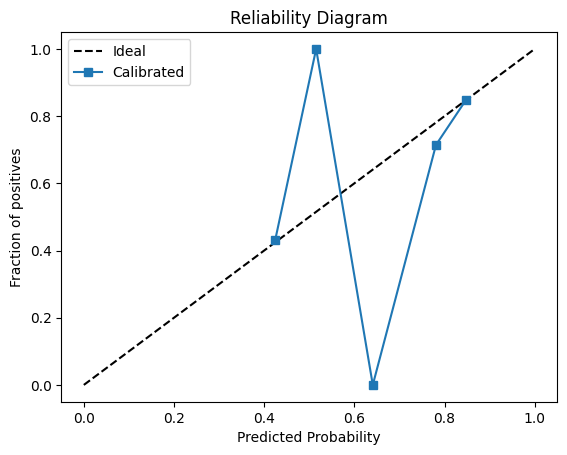

Chosen threshold for recall≥0.95: 0.4185
Precision at that threshold: 0.8596, recall: 0.9503
2024-12-29 21:35:17


In [ ]:
#Calibrate model's output to approach statistical accuracy (or be less statistically inaccurate)
#Do so via Platt Scaling

# Let's see a small reliability check: bin the p_calibrated to see if they match the fraction of actual positives.
# (Optional code for demonstration)
def plot_reliability_diagram(probs, labels, num_bins=10):
    bins = np.linspace(0.0, 1.0, num_bins+1)
    indices = np.digitize(probs, bins) - 1
    bin_centers = 0.5*(bins[1:] + bins[:-1])

    avg_pred = []
    frac_pos = []
    for b in range(num_bins):
        mask = (indices == b)
        if np.sum(mask) > 0:
            avg_pred.append(np.mean(probs[mask]))
            frac_pos.append(np.mean(labels[mask]))
        else:
            avg_pred.append(None)
            frac_pos.append(None)

    plt.plot([0,1], [0,1], 'k--', label="Ideal")
    plt.plot([m for m in avg_pred if m is not None],
             [f for f in frac_pos if f is not None], 's-', label="Calibrated")
    plt.xlabel("Predicted Probability")
    plt.ylabel("Fraction of positives")
    plt.title("Reliability Diagram")
    plt.legend()
    plt.show()


# For example, if you want recall≥95% for "Animal", you can scan the precision-recall curve or just do:
from sklearn.metrics import precision_recall_curve

# Suppose you want to apply this to new data:
def apply_platt_scaling(raw_conf):
    # raw_conf is the model's original confidence in [0,1] (or logit if you prefer).
    # If your net outputs a probability in [0,1], we treat that as X. If it outputs logits, do that.
    # Then the logistic regression transforms it further:
    p = platt_logistic.predict_proba([[raw_conf]])[0,1]
    return p

def classify_new_event(raw_conf):
    p = apply_platt_scaling(raw_conf)
    return "Animal" if p >= chosen_threshold else "No_Animal"

# EXECUTION AREA

print(f"Length of calib_scores: {len(calib_scores)}")
print(f"Length of calib_labels: {len(calib_labels)}")

# We treat 'calib_scores' as the input X (reshape to Nx1),
# and 'calib_labels' as the y. We'll do simple logistic regression.
X_calib = calib_scores.reshape(-1, 1)
y_calib = calib_labels

platt_logistic = LogisticRegression(solver='lbfgs')
platt_logistic.fit(X_calib, y_calib)

# Now platt_logistic predicts PROBABILITIES for new raw scores.
# The logistic regression essentially learns the 'A' and 'B' of Platt scaling:
#   p_calibrated = 1 / (1 + exp(A*score + B))

# We'll get the calibrated probabilities for our calibration data itself
p_calibrated = platt_logistic.predict_proba(X_calib)[:,1]

plot_reliability_diagram(p_calibrated, y_calib, num_bins=10)

prec, rec, thresholds = precision_recall_curve(y_calib, p_calibrated, pos_label=1)

target_recall = 0.95
valid_idx = [i for i in range(len(rec)) if rec[i]>=target_recall]
if valid_idx:
    chosen_i = valid_idx[-1]
    chosen_threshold = thresholds[chosen_i]
    print(f"Chosen threshold for recall≥{target_recall}: {chosen_threshold:.4f}")
    print(f"Precision at that threshold: {prec[chosen_i]:.4f}, recall: {rec[chosen_i]:.4f}")
else:
    print("No threshold yields recall≥95% in calibration set")


output_datetimestamp()

# End / Notes

##Location Analysis

###Unique Locations / Terrain Per Carmen:
(NECor = HMW)
* SB Cliffs (and some SB Falls)
* East End
* NE Cor + HMW
* Cutoff
* Meadow (unnamed - assume any numeric or non-prefixed DSC file)



In [ ]:
import os
from collections import Counter, defaultdict

def count_files_by_keywords_and_classes(directory, keywords, class_subdirs=("Animals", "No_animals"), filename_samples=1):
    """
    Counts files in the specified directory for each keyword and class, including files that do not match any keyword.

    Parameters:
        directory (str): The directory to search in.
        keywords (list of str): Keywords to look for in filenames.
        class_subdirs (tuple): Subdirectories representing classes (e.g., "Animals" and "No_Animals").
        filename_samples (int): Number of sample filenames to display for each keyword and class.

    Returns:
        dict: Nested dictionary with counts and sample filenames for each keyword and class.
    """
    # Initialize counters and storage for sample filenames
    tot = 0
    counts = {keyword: {class_dir: 0 for class_dir in class_subdirs} for keyword in keywords}
    samples = {keyword: {class_dir: [] for class_dir in class_subdirs} for keyword in keywords}
    totals = {keyword: 0 for keyword in keywords}
    no_keywords_counts = {class_dir: 0 for class_dir in class_subdirs}
    no_keywords_samples = {class_dir: [] for class_dir in class_subdirs}
    file_category_map = defaultdict(list)  # To track files and their categories

    # Walk through the directory and subdirectories
    for class_dir in class_subdirs:
        class_path = os.path.join(directory, class_dir)
        if not os.path.exists(class_path):
            print(f"Warning: {class_path} does not exist.")
            continue
        for root, _, files in os.walk(class_path):
            for filename in files:
                if not (filename.lower().endswith(".jpg") or filename.lower().endswith(".jpeg")):
                    continue
                tot += 1  # Increment only for valid files
                file_path = os.path.join(root, filename)
                matched = False
                for keyword in keywords:
                    if keyword.lower() in filename.lower():
                        counts[keyword][class_dir] += 1
                        if len(samples[keyword][class_dir]) < filename_samples:
                            samples[keyword][class_dir].append(file_path)
                        totals[keyword] += 1
                        file_category_map[file_path].append(f"{keyword} ({class_dir})")
                        matched = True
                        break
                if not matched:
                    no_keywords_counts[class_dir] += 1
                    if len(no_keywords_samples[class_dir]) < filename_samples:
                        no_keywords_samples[class_dir].append(file_path)
                    file_category_map[file_path].append(f"No Keywords ({class_dir})")

    # Print results
    print("File counts by keywords and classes:")
    for keyword, class_counts in counts.items():
        print(f"Keyword: {keyword}")
        for class_dir, count in class_counts.items():
            print(f"  {class_dir}: {count}")
            if samples[keyword][class_dir]:
                print(f"    Sample files ({len(samples[keyword][class_dir])} shown):")
                for sample in samples[keyword][class_dir]:
                    print(f"      {sample}")
        print(f"  Total for {keyword}: {totals[keyword]}")
        print("-" * 40)

    print("Files with no matching keywords:")
    no_keywords_total = 0
    for class_dir, count in no_keywords_counts.items():
        print(f"  {class_dir}: {count}")
        if no_keywords_samples[class_dir]:
            print(f"    Sample files ({len(no_keywords_samples[class_dir])} shown):")
            for sample in no_keywords_samples[class_dir]:
                print(f"      {sample}")
        no_keywords_total += count
    print(f"  Total for no keywords: {no_keywords_total}")
    print("-" * 40)

    return counts, samples, totals, tot, no_keywords_counts, no_keywords_samples, file_category_map

def find_duplicate_category_assignments(file_category_map):
    """
    Identifies files that are assigned to multiple categories.

    Parameters:
        file_category_map (dict): A dictionary mapping file paths to their assigned categories.

    Returns:
        dict: A dictionary of files with multiple category assignments.
    """
    duplicates = {file: categories for file, categories in file_category_map.items() if len(categories) > 1}
    print("Files with multiple category assignments:")
    for file, categories in duplicates.items():
        print(f"  {file}: {categories}")
    return duplicates

# Specify the directory and keywords
directory = train_data_dir  # Change this to your directory path
keywords = ["East", "SB", "Cutoff", "Sandy", "HMW", "NE"]  # Specify your keywords

# Call the function
SAMPLES_TO_RETURN = 1
class_counts, sample_files, keyword_totals, totals, no_keywords_counts, no_keywords_samples, file_category_map = count_files_by_keywords_and_classes(directory, keywords, filename_samples=SAMPLES_TO_RETURN)

# Find and print duplicates
duplicate_assignments = find_duplicate_category_assignments(file_category_map)
print(f"Total files: {totals}")
print(f"No Keywords Counts (Mostly Meadow & few SB): {no_keywords_counts}")
assert 767+ 697 + 490 + 139 + 95 + 66 + sum(no_keywords_counts.values()) == totals, "Totals do not match"


File counts by keywords and classes:
Keyword: East
  Animals: 714
    Sample files (1 shown):
      /content/drive/MyDrive/Training_data/Animals/240430-240609 East End Gm TrDSCF0005.JPG
  No_animals: 53
    Sample files (1 shown):
      /content/drive/MyDrive/Training_data/No_animals/240430-240609 East End Gm TrDSCF0263.JPG
  Total for East: 767
----------------------------------------
Keyword: SB
  Animals: 249
    Sample files (1 shown):
      /content/drive/MyDrive/Training_data/Animals/SbCliffsGmtrDSCF0137.JPG
  No_animals: 448
    Sample files (1 shown):
      /content/drive/MyDrive/Training_data/No_animals/SbCliffsGmtrDSCF0113.JPG
  Total for SB: 697
----------------------------------------
Keyword: Cutoff
  Animals: 183
    Sample files (1 shown):
      /content/drive/MyDrive/Training_data/Animals/GmTrlHideFallsCutoff DSCF0105.JPG
  No_animals: 307
    Sample files (1 shown):
      /content/drive/MyDrive/Training_data/No_animals/GmTrlHideFallsCutoff DSCF0699.JPG
  Total for Cuto

## BEGIN Most Refined Location Buckets for Training Data

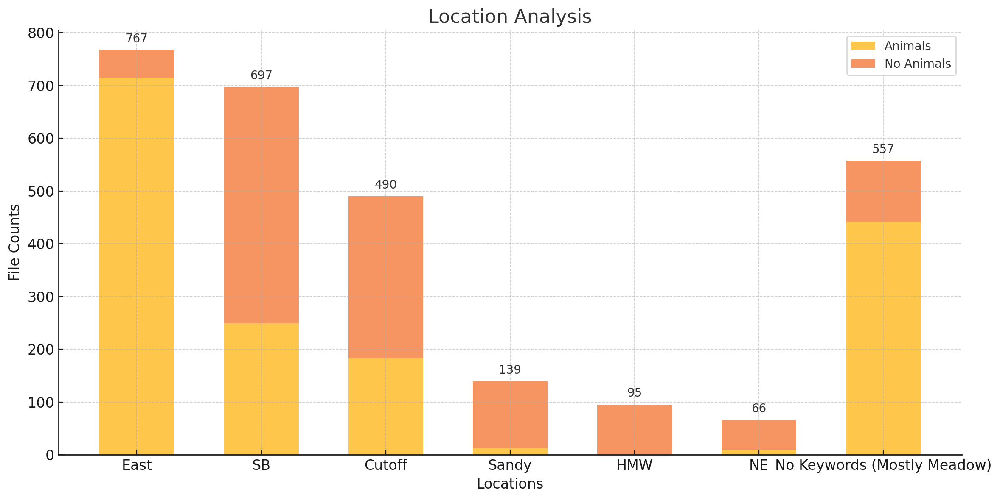

## END Most Refined Location Buckets for Training Data


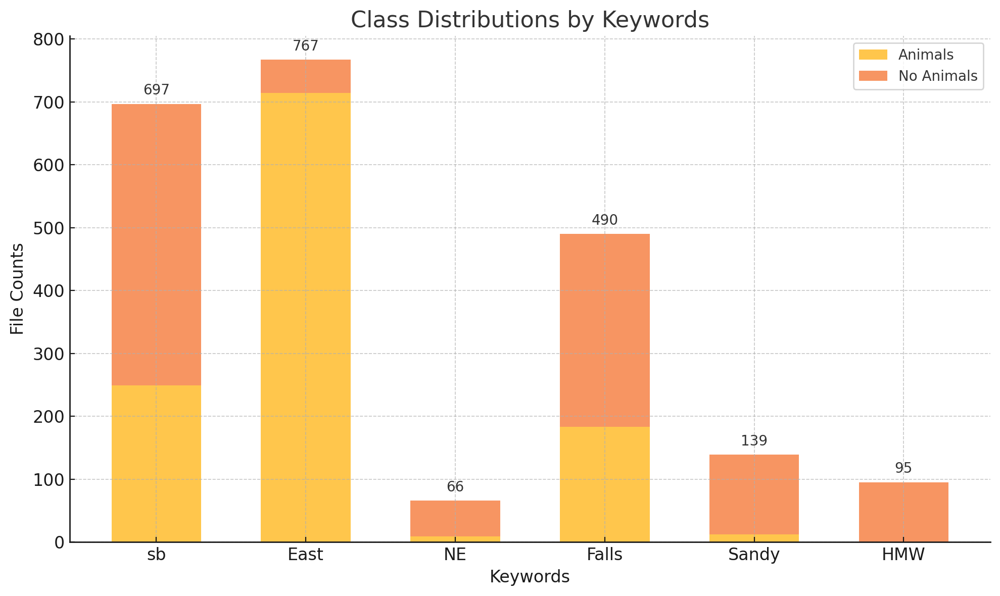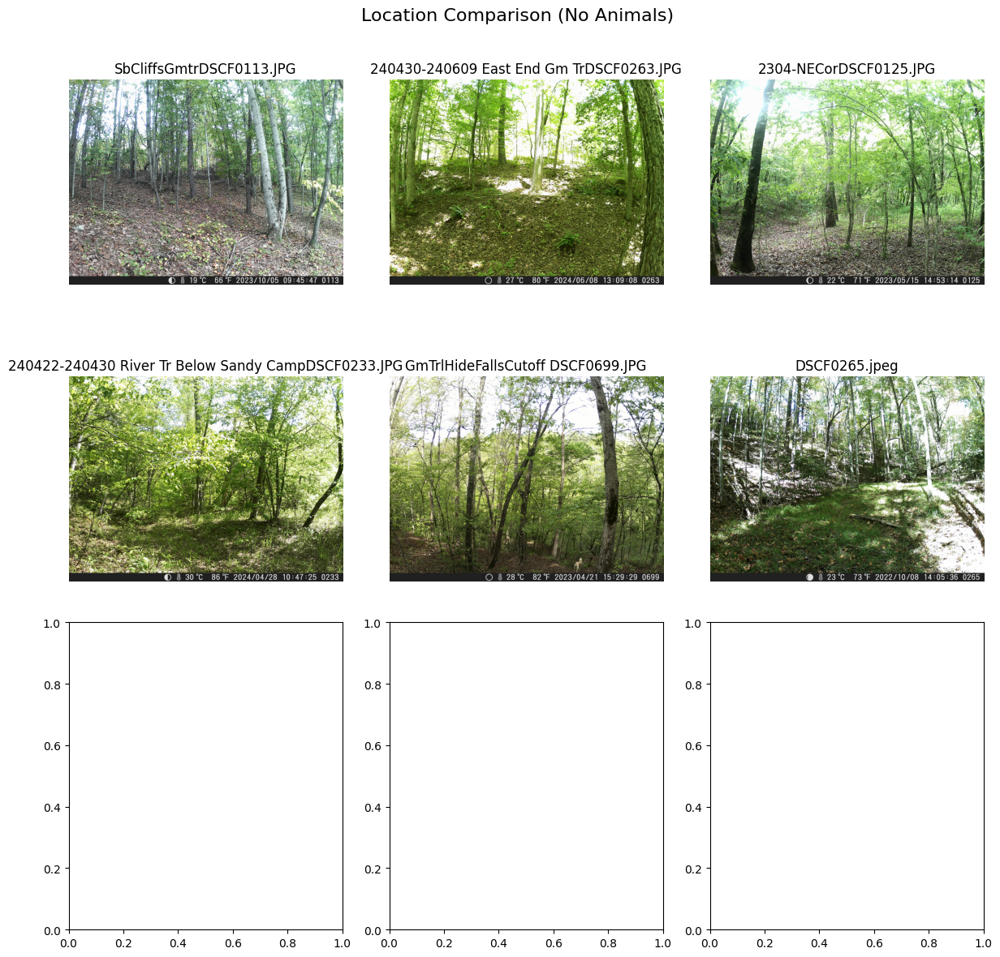

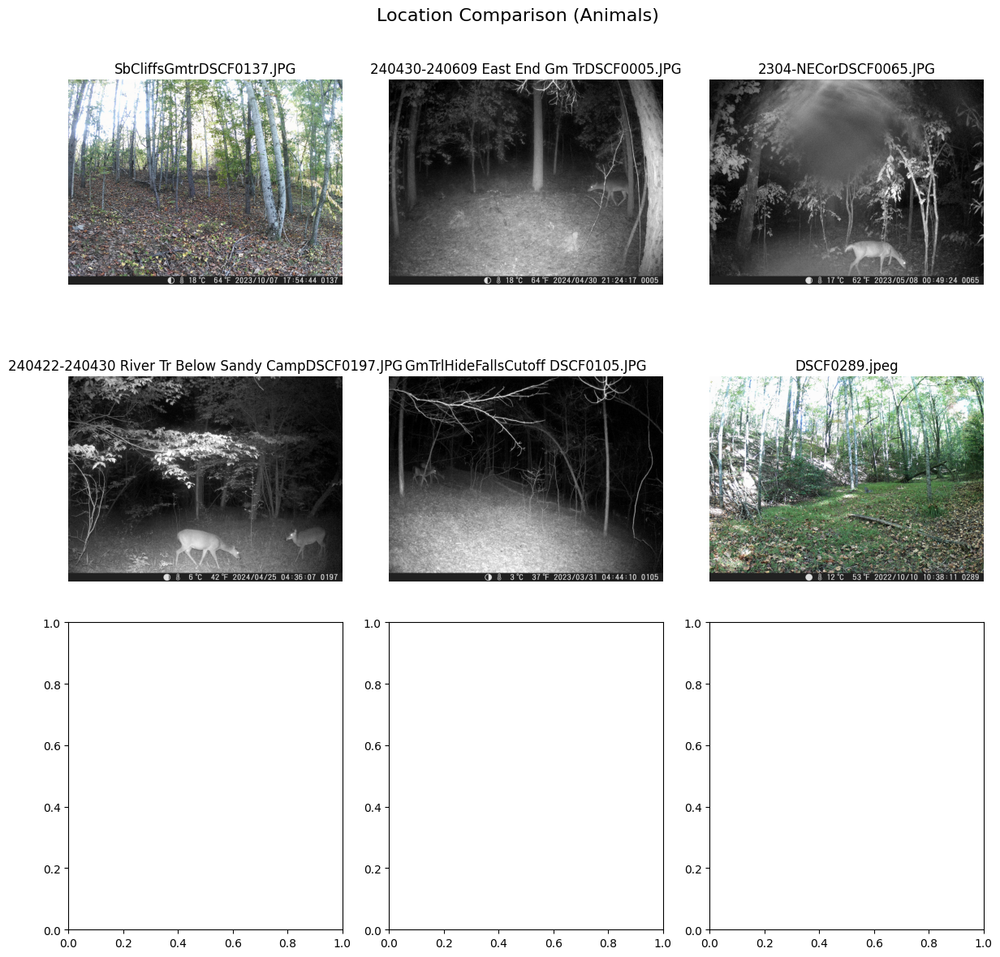

In [ ]:


#Results history:
# 8/16 cnn + bi lstm 16 (8 folds, 1 patience): {'accuracy': 0.8, 'precision': 0.8333333333333334, 'recall': 0.625, 'f1_score': 0.7142857142857143, 'confusion_matrix': [[15, 9], [3, 33]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}
# 8/16 cnn + bi lstm 32 (7 folds, 2 patience)[fixed bug in min loss in train]: {'accuracy': 0.8, 'precision': 0.8333333333333334, 'recall': 0.625, 'f1_score': 0.7142857142857143, 'confusion_matrix': [[15, 9], [3, 33]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}
# 16/32? cnn + lstm 32 (7 folds, 3 patience): {'accuracy': 0.8, 'precision': 1.0, 'recall': 0.5, 'f1_score': 0.6666666666666666, 'confusion_matrix': [[12, 12], [0, 36]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG'], 'incorrect_animal': [], 'incorrect_no_animal': ['DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG', 'DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}
# incepv3 + bi lstm 16 (5 folds, 2 patience): {'accuracy': 0.6, 'precision': 0.5, 'recall': 0.5, 'f1_score': 0.5, 'confusion_matrix': [[12, 12], [12, 24]], 'correct_predictions': ['DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0021.JPG', 'DSCF0022.JPG', 'DSCF0023.JPG', 'DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG'], 'incorrect_animal': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG', 'DSCF0037.JPG', 'DSCF0038.JPG', 'DSCF0039.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0053.JPG', 'DSCF0054.JPG', 'DSCF0055.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}

# Model Name: NoZoom 3Img Cust Hybrid 1CNN Bi-RNN 1Dense
# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 1CNN (16 / 3 features & kernels, respectively), Bi-GRU 16 neurons (0.5/0.5 dropouts), 1 Dense (64)
# 	 Dense Dropouts: 0.6
# Training Parms:
# 	 Splits = 3
# 	 Patience = 3
# 	 Epochs = 15
# 	 2024-02-01 18:38:38
# {'accuracy': 0.8, 'precision': 0.8333333333333334, 'recall': 0.625, 'f1_score': 0.7142857142857143, 'confusion_matrix': [[15, 9], [3, 33]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}

# Model Name: z1pt53Img Cust Hybrid 1CNN Bi-GRU 1Dense
# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 1CNN (16 / 3 features & kernel, respectively), Bi-GRU 16 neurons (0.3/0.3 dropouts), 1 Dense (128)
# 	 Dense Dropouts: 0.6
# Training Parms:
# 	 Splits = 7
# 	 Patience = 2
# 	 Epochs = 10
# 	 2024-02-03 20:58:40
# {'accuracy': 0.6, 'precision': 0.0, 'recall': 0.0, 'f1_score': 0.0, 'confusion_matrix': [[0, 24], [0, 36]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': [], 'incorrect_no_animal': ['DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0021.JPG', 'DSCF0022.JPG', 'DSCF0023.JPG', 'DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG', 'DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG']}

# Model Name: z3pt03Img Cust Hybrid 1CNN Bi-GRU 1Dense
# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 1CNN (16 / 3 features & kernel, respectively), Bi-GRU 16 neurons (0.3/0.3 dropouts), 1 Dense (128)
# 	 Dense Dropouts: 0.6
# Training Parms:
# 	 Splits = 7
# 	 Patience = 2
# 	 Epochs = 10
# 	 2024-02-03 21:17:14
# {'accuracy': 0.65, 'precision': 1.0, 'recall': 0.125, 'f1_score': 0.2222222222222222, 'confusion_matrix': [[3, 21], [0, 36]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': [], 'incorrect_no_animal': ['DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0021.JPG', 'DSCF0022.JPG', 'DSCF0023.JPG', 'DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG', 'DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG']}

# Model Name: NoZoom 3Img Cust Hybrid 1CNN Bi-RNN 1Dense
# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 1CNN (16 / 3 features & kernels, respectively), Bi-GRU 16 neurons (0.5/0.5 dropouts), 1 Dense (64)
# 	 Dense Dropouts: 0.6
# Training Parms:
# 	 Splits = 7
# 	 Patience = 2
# 	 Epochs = 10
# 	 2024-02-01 18:26:37
# {'accuracy': 0.8, 'precision': 0.8333333333333334, 'recall': 0.625, 'f1_score': 0.7142857142857143, 'confusion_matrix': [[15, 9], [3, 33]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}

# Model Name: NoZoom 3Img Cust Hybrid 1CNN Bi-RNN 1Dense
# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 1CNN (16 / 3 features & kernels, respectively), Bi-GRU 16 neurons (0.5/0.5 dropouts), 1 Dense (64)
# 	 Dense Dropouts: 0.6
# Training Parms:
# 	 Splits = 10
# 	 Patience = 1
# 	 Epochs = 10
# 	 2024-02-01 18:08:18
# {'accuracy': 0.8, 'precision': 1.0, 'recall': 0.5, 'f1_score': 0.6666666666666666, 'confusion_matrix': [[12, 12], [0, 36]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG'], 'incorrect_animal': [], 'incorrect_no_animal': ['DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG', 'DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}

# Model Name: NoZoom 3Img Cust Hybrid 1CNN Bi-LSTM
# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 1CNN (16 / 3 features & kernels, respectively), Bi-LSTM 32 neurons (0.5/0.5 dropouts), 1 Dense (128)
# 	 Dense Dropouts: 0.6
# Training Parms:
# 	 Splits = 10
# 	 Patience = 1
# 	 Epochs = 15
# 	 2024-02-01 16:48:58
# {'accuracy': 0.8, 'precision': 0.8333333333333334, 'recall': 0.625, 'f1_score': 0.7142857142857143, 'confusion_matrix': [[15, 9], [3, 33]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}

# Model Name: NoZoom 3Img Cust Hybrid 2CNN Bi-LSTM

# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 2CNNs (8,16 / 3 features & kernels, respectively), Bi-LSTM 16 neurons, 2 Dense (32 & 16)
# 	 Dense Dropouts: 0.6 & 0.5
# Training Parms:
# 	 Splits = 7
# 	 Patience = 2
# 	 Epochs = 10
# 	 2024-02-01 09:07:57
# Architecture:
# 	 2CNNs (8,16 / 3 features & kernels, respectively), Bi-LSTM 16 neurons, 2 Dense (32 & 16)
# 	 Dense Dropouts: 0.6 & 0.5
# Training Parms:
# 	 Splits = 10
# 	 Patience = 1
# 	 Epochs = 15
# 	 2024-02-01 09:13:28
# {'accuracy': 0.7, 'precision': 1.0, 'recall': 0.25, 'f1_score': 0.4, 'confusion_matrix': [[6, 18], [0, 36]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG'], 'incorrect_animal': [], 'incorrect_no_animal': ['DSCF0021.JPG', 'DSCF0022.JPG', 'DSCF0023.JPG', 'DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG', 'DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0057.JPG', 'DSCF0058.JPG', 'DSCF0059.JPG']}

# Model Name: NoZoom 3Img Cust Hybrid 2CNN Bi-LSTM

# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 2CNNs (8,16 / 3 features & kernels, respectively), Bi-LSTM 16 neurons, 2 Dense (32 & 16)
# 	 Dense Dropouts: 0.6 & 0.5
# Training Parms:
# 	 Splits = 7
# 	 Patience = 2
# 	 Epochs = 10
# 	 2024-02-01 09:07:57
# {'accuracy': 0.8, 'precision': 0.8333333333333334, 'recall': 0.625, 'f1_score': 0.7142857142857143, 'confusion_matrix': [[15, 9], [3, 33]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}

# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.9
# Architecture:
# 	 3CNNs (8,16,32 / 3, 4, 5 features & kernels, respectively), Bi-LSTM 16 neurons, 2 Dense (32 & 16)
# 	 Dense Dropouts: 0.6 & 0.5
# Training Parms:
# 	 Splits = 7
# 	 Patience = 2
# 	 2024-01-31 22:56:38
# {'accuracy': 0.45, 'precision': 0.4, 'recall': 0.75, 'f1_score': 0.5217391304347827, 'confusion_matrix': [[18, 6], [27, 9]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0021.JPG', 'DSCF0022.JPG', 'DSCF0023.JPG', 'DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG'], 'incorrect_animal': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG', 'DSCF0029.JPG', 'DSCF0030.JPG', 'DSCF0031.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}

# Model Name: NoZoom 3Img Cust Hybrid 1ConvLSTM 1Dense
# Aug parms:
# 	 rot=7
# 	 w_shift=0.1
# 	 ht_shift=0.1
# 	 shear=0.2
# 	 zoom=0.0
# Architecture:
# 	 1ConvLSTM (16 / 3 features & kernels, respectively) (0.3/0.3 dropouts), 1 Dense (128)
# 	 Dense Dropouts: 0.4
# Training Parms:
# 	 Splits = 7
# 	 Patience = 2
# 	 Epochs = 15
# 	 2024-02-01 23:35:43
# {'accuracy': 0.65, 'precision': 1.0, 'recall': 0.125, 'f1_score': 0.2222222222222222, 'confusion_matrix': [[3, 21], [0, 36]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG'], 'incorrect_animal': [], 'incorrect_no_animal': ['DSCF0021.JPG', 'DSCF0022.JPG', 'DSCF0023.JPG', 'DSCF0025.JPG', 'DSCF0026.JPG', 'DSCF0027.JPG', 'DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0053.JPG', 'DSCF0054.JPG', 'DSCF0055.JPG']}

# LATEST & GREATEST
# Architecture:
# 	 1CNN (16 / 3 features & kernel, respectively), Bi-GRU 24 neurons (0.3/0.3 dropouts), 1 Dense (64)
# 	 Dense Dropouts: 0.4
# Training Parms:
# 	 Patience = 3
# 	 Epochs = 15
#    BATCH_SIZE = 16
# 	 2024-02-07 17:02:21
# {'accuracy': 0.8, 'precision': 0.8333333333333334, 'recall': 0.625, 'f1_score': 0.7142857142857143, 'confusion_matrix': [[15, 9], [3, 33]], 'correct_predictions': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0015.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG'], 'incorrect_animal': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG'], 'incorrect_no_animal': ['DSCF0033.JPG', 'DSCF0034.JPG', 'DSCF0035.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0073.JPG', 'DSCF0074.JPG', 'DSCF0075.JPG']}
# Model Name: no_zoom3Img Cust Hybrid 1CNN Bi-GRU 1Dense
# Training Parms:
# 	 Patience = 10
# 	 Epochs = 100
# 	 Batch Size = 8
# 	 2024-12-14 13:32:49
# Training Parms:
# 	 Patience = 10
# 	 Epochs = 100
# 	 Batch Size = 8
#{'accuracy': 0.8396946564885496, 'precision': 0.860655737704918, 'recall': 0.963302752293578, 'f1_score': 0.9090909090909091, 'confusion_matrix': [[315, 12], [51, 15]], 'correct_predictions': ['DSCF0005.JPG', 'DSCF0006.JPG', 'DSCF0007.JPG', 'DSCF0009.JPG', 'DSCF0010.JPG', 'DSCF0011.JPG', 'DSCF0017.JPG', 'DSCF0018.JPG', 'DSCF0019.JPG', 'DSCF0021.JPG', 'DSCF0022.JPG', 'DSCF0023.JPG'], 'incorrect_animal': ['DSCF0173.JPG', 'DSCF0174.JPG', 'DSCF0175.JPG', 'DSCF0209.JPG', 'DSCF0210.JPG', 'DSCF0211.JPG', 'DSCF0217.JPG', 'DSCF0218.JPG', 'DSCF0219.JPG', 'DSCF0305.JPG', 'DSCF0306.JPG', 'DSCF0307.JPG'], 'incorrect_no_animal': ['DSCF0001.JPG', 'DSCF0002.JPG', 'DSCF0003.JPG', 'DSCF0013.JPG', 'DSCF0014.JPG', 'DSCF0015.JPG', 'DSCF0069.JPG', 'DSCF0070.JPG', 'DSCF0071.JPG', 'DSCF0249.JPG', 'DSCF0250.JPG', 'DSCF0251.JPG']}


##Best Hybrid MobileNetV3-Lrg / Bi-GRU Prod results

##Current Summary
| Metric       | Max Model (East End) | Max Model (SB Cliffs) | Model w/out Multires (East End) | Model w/out Multires (SB Cliffs) |
|-------------|----------------------|-----------------------|--------------------------------|--------------------------------|
| Accuracy    | 0.8168               | 0.8229                | 0.8015                         | 0.8542                         |
| Precision   | 0.8796               | 0.88                  | 0.9000                         | 0.9184                         |
| Recall      | 0.8962               | 0.8                   | 0.8491                         | 0.8182                         |
| F1 Score    | 0.8879               | 0.8381                | 0.8738                         | 0.8654                         |


###Model
prod_model_filename = "EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense_FullTrain_E56_VBA0.92.keras" (Feb 4, 2025)

~12.5M parms

| Layer (type)              | Output Shape           | Param #      | Connected to           |
|---------------------------|------------------------|-------------|------------------------|
| video_input (InputLayer)  | (None, 3, 299, 299, 3) | 0           | -                      |
| TD-Resize-224 (TimeDistributed) | (None, 3, 224, 224, 3) | 0           | video_input[0][0]      |
| TD-Resize-112 (TimeDistributed) | (None, 3, 112, 112, 3) | 0           | video_input[0][0]      |
| TD-Resize-56 (TimeDistributed) | (None, 3, 56, 56, 3)   | 0           | video_input[0][0]      |
| abs_diff_layer (SequentialAbsoluteDifference) | (None, 2, 224, 224, 3) | 0 | TD-Resize-224[0][0]    |
| time_distributed_high (TimeDistributed) | (None, 3, 32) | 5,280       | TD-Resize-224[0][0]    |
| time_distributed_medium (TimeDistributed) | (None, 3, 32) | 5,280       | TD-Resize-112[0][0]    |
| time_distributed_low (TimeDistributed) | (None, 3, 32) | 5,280       | TD-Resize-56[0][0]     |
| AbsDiff-Pool (TimeDistributed) | (None, 2, 3) | 0           | abs_diff_layer[0][0]   |
| TD-RawImg-MobileNet (TimeDistributed) | (None, 3, 7, 7, 960) | 2,996,352 | TD-Resize-224[0][0]    |
| concatenate (Concatenate) | (None, 3, 96) | 0           | time_distributed_high, time_distributed_medium, time_distributed_low |
| AbsDiff-Bi-GRU (Bidirectional) | (None, 2, 128) | 26,496    | AbsDiff-Pool[0][0]     |
| TD-Flatten (TimeDistributed) | (None, 3, 47040) | 0         | TD-RawImg-MobileNet[0][0] |
| bidirectional (Bidirectional) | (None, 3, 256) | 173,568    | concatenate[0][0]      |
| RawImg-GAPPool2D (TimeDistributed) | (None, 3, 960) | 0        | TD-RawImg-MobileNet[0][0] |
| AbsDiff-Bi-GRU-2 (Bidirectional) | (None, 64) | 31,104    | AbsDiff-Bi-GRU[0][0]   |
| Raw-Bi-GRU-2 (Bidirectional) | (None, 64) | 9,038,208  | TD-Flatten[0][0]       |
| bidirectional_1 (Bidirectional) | (None, 128) | 123,648    | bidirectional[0][0]    |
| RawImg-Time-GAPPool1D (GlobalAveragePooling1D) | (None, 960) | 0 | RawImg-GAPPool2D[0][0] |
| concatenate_1 (Concatenate) | (None, 1216) | 0           | AbsDiff-Bi-GRU-2, Raw-Bi-GRU-2, bidirectional_1, RawImg-Time-GAPPool1D |
| flatten_1 (Flatten)       | (None, 1216) | 0           | concatenate_1[0][0]    |
| dense (Dense)             | (None, 64)   | 77,888      | flatten_1[0][0]        |
| dropout (Dropout)         | (None, 64)   | 0           | dense[0][0]            |
| dense_1 (Dense)           | (None, 48)   | 3,120       | dropout[0][0]          |
| dropout_1 (Dropout)       | (None, 48)   | 0           | dense_1[0][0]          |
| dense_2 (Dense)           | (None, 32)   | 1,568       | dropout_1[0][0]        |
| dropout_2 (Dropout)       | (None, 32)   | 0           | dense_2[0][0]          |
| dense_3 (Dense)           | (None, 16)   | 528         | dropout_2[0][0]        |
| dropout_3 (Dropout)       | (None, 16)   | 0           | dense_3[0][0]          |
| dense_4 (Dense)           | (None, 1)    | 17          | dropout_3[0][0]        |

###Stats
| Metric     | East End | SB Cliffs | East End (New Thresh) | SB Cliffs (New Thresh) |
|------------|---------|-----------|-----------------------|-----------------------|
| Accuracy   | 0.8168  | 0.8229    | 0.8397                | 0.5625                |
| Precision  | 0.8796  | 0.88      | 0.8632                | 0.5699                |
| Recall     | 0.8962  | 0.8       | 0.9528                | 0.9636                |
| F1 Score   | 0.8879  | 0.8381    | 0.9058                | 0.7162                |

###Model
prod_model_filename = "EndGame-3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 3Dense_FullTrain_E48_VBA0.92.keras"

~120M Parms

| Component                      | Output Shape           | Parameters   |
|--------------------------------|------------------------|--------------|
| Input                          | (None, 3, 299, 299, 3) | 0            |
| TimeDistributed Resize         | (None, 3, 224, 224, 3) | 0            |
| Absolute Differences Layer     | (None, 2, 299, 299, 3) | 0            |
| TimeDistributed MobileNetV3    | (None, 3, 7, 7, 960)   | 2,996,352    |
| AbsDiff Pooling                | (None, 2, 3)           | 0            |
| TimeDistributed Flatten        | (None, 3, 47040)       | 0            |
| AbsDiff Bi-GRU                 | (None, 2, 128)         | 26,496       |
| Raw Bi-GRU                     | (None, 3, 128)         | 18,088,704   |
| Raw Image GAP Pooling          | (None, 3, 960)        | 0            |
| AbsDiff Bi-GRU-2               | (None, 64)            | 31,104       |
| Raw Bi-GRU-2                   | (None, 64)            | 31,104       |
| Raw Image Time GAP Pooling     | (None, 960)           | 0            |
| Concatenate Features           | (None, 1088)          | 0            |
| Flatten                        | (None, 1088)          | 0            |
| Dense 64                       | (None, 64)            | 69,696       |
| Dropout 0.5                    | (None, 64)            | 0            |
| Dense 32                       | (None, 32)            | 2,080        |
| Dropout 0.5                    | (None, 32)            | 0            |
| Dense 16                       | (None, 16)            | 528          |
| Dropout 0.4                    | (None, 16)            | 0            |
| Dense 16                       | (None, 16)            | 272          |
| Dropout 0.3                    | (None, 16)            | 0            |
| Final Output                   | (None, 1)             | 17           |

####Stats

---

## Evaluation Results Summary

| Metric     | East End | SB Cliffs | Threshold Adjusted - EE | Threshold Adjusted - SB |
|-----------|---------|-----------|-------------------------|-------------------------|
| Accuracy  | 0.8015  | 0.8542    | 0.8473                  | 0.7708                  |
| Precision | 0.9000  | 0.9184    | 0.8707                  | 0.7260                  |
| Recall    | 0.8491  | 0.8182    | 0.9528                  | 0.9636                  |
| F1 Score  | 0.8738  | 0.8654    | 0.9099                  | 0.8281                  |


###Model
prod_model_filename = "no_zoom3Img Cust Hybrid MobileNetV3-Lrg Bi-GRU 1Dense_FullTrain_E33_VBA0.93.keras"

~Small parms?

####Stats

| Metric      | East End Results | SB Cliffs Results | Ideal Range    |
|------------|----------------|----------------|---------------|
| Accuracy   | 0.8092         | 0.8542         | 0.85 - 0.95   |
| Precision  | 0.814          | 0.9556         | 0.85 - 0.95   |
| Recall     | 0.9906         | 0.7818         | 0.95 - 1.0    |
| F1 Score   | 0.8936         | 0.86           | 0.90 - 0.95   |
